# World Weather Analysis

# TABLE OF CONTENTS

**1.** [INTRODUCTION](#Section1)<br>
**2.** [PROBLEM STATEMENT](#Section2)<br>
**3.** [IMPORTING THE IMPORTANT LIBRARIES](#Section3)<br>
**4.** [IMPORTING THE GLOBAL WEATHER DATASET](#Section4)<br>
**5.** [DATA PREPROCESSING](#Section5)<br>

  - **5.1.** [**HANDLING INCONSISTENCIES/DUPLICATES/REDUNDANCIES**](#Section5.1)
  - **5.2.** [**HANDLING MISSING VALUES**](#Section5.2)
  - **5.3.** [**HANDLING OUTLIERS**](#Section5.3)

**6.** [EXPLORATORY DATA ANALYSIS](#Section6)<br>

  - **6.1.** [**DATA GRANULARITY AND DATA IMBALANCE**](#Section6.1)
  - **6.2.** [**UNIVARIATE ANALYSIS OF METRICS**](#Section6.2)
  - **6.3.** [**UNIVARIATE ANALYSIS OF DIMENSIONS**](#Section6.3)
  - **6.4.** [**BIVARIATE ANALYSIS**](#Section6.4)<br>
  - **6.5.** [**TIME TREND ANALYSIS**](#Section6.5)

<a id = Section1></a>

# 1.INTRODUCTION <a name="INTRODUCTION"></a>

- World Weather analysis is a critical exercise helpful in drawing insights and conclusions about varied features of weather like temperature variation, uv index range, air quality measurement throughout the world and gives us a deep overview of how climatic conditions vary with varying continents, countries and even locations.
- The dataset used for analysis, provides daily weather information for capital cities around the world. Unlike forecast data, this dataset offers a comprehensive set of features that reflect the current weather conditions around the world.
- The dataset used covers daily weather records from May 16 - Aug 2, 2024.
- It provides over 40+ features , including temperature, wind, pressure, precipitation, humidity, visibility, air quality measurements and more.
- The actual dataset can be found [here](https://www.kaggle.com/datasets/nelgiriyewithana/global-weather-repository).

<a id = Section2></a>

# 2. PROBLEM STATEMENT<a name="PROBLEM STATEMENT"></a>

I have been appointed as a data scientist by World Meteorological Organization to analyse the world's weather data for the period from May 16 - Aug 2, 2024 to provide conclusions on following:

- Climate Analysis: To analyze global weather patterns, exploring climate trends, and understanding the relationships between different weather parameters.
- Geographical Patterns: Explore how weather conditions differ across countries and continents.
- Time Trend Analysis: Demonstrate the daily, weekly and monthly trends for various weather attributes.
- Analyze air quality and its correlation with various weather parameters.

<a id = Section3></a>

# 3. IMPORTING THE IMPORTANT LIBRARIES<a name="IMPORTING THE IMPORTANT LIBRARIES"></a>

In [3]:
import numpy as np                                    # To perform numerical operations
import pandas as pd                                   # Importing for panel data analysis
                                                

#-------------------------------------------------------------------------------------------
from matplotlib import pyplot as plt                  # To perform data visualisation
import seaborn as sns                                 # To perform data visualisation
sns.set_theme(style="white", palette="muted")
%matplotlib inline

#-------------------------------------------------------------------------------------------
import warnings                                       # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")

<a id = Section4></a>

# 4. IMPORTING THE GLOBAL WEATHER DATASET<a name="IMPORTING THE GLOBAL WEATHER DATASET"></a>

In [4]:
df = pd.read_csv('/Users/kanishksharma/desktop/Data Science/Acrredian/Term Projects/EDA - PROJECT/Global_Weather_Prediction/GlobalWeatherRepository.csv', encoding="latin-1")
df

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,...,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,...,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,...,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1715849100,2024-05-16 10:45,6.3,43.3,Light drizzle,...,0.7,0.9,1,1,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,55
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1715849100,2024-05-16 09:45,26.0,78.8,Partly cloudy,...,183.4,262.3,5,10,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14883,Venezuela,Caracas,10.50,-66.92,America/Caracas,1722514500,2024-08-01 08:15,21.5,70.7,Sunny,...,5.3,6.4,1,1,06:17 AM,06:51 PM,03:34 AM,04:49 PM,Waning Crescent,12
14884,Vietnam,Hanoi,21.03,105.85,Asia/Bangkok,1722514500,2024-08-01 19:15,26.9,80.4,Partly Cloudy,...,25.7,34.9,2,3,05:31 AM,06:35 PM,02:09 AM,04:17 PM,Waning Crescent,12
14885,Yemen,Sanaa,15.35,44.21,Asia/Aden,1722514500,2024-08-01 15:15,23.2,73.7,Patchy rain nearby,...,12.6,35.8,1,2,05:46 AM,06:33 PM,02:40 AM,04:19 PM,Waning Crescent,12
14886,Zambia,Lusaka,-15.42,28.28,Africa/Lusaka,1722514500,2024-08-01 14:15,26.6,79.9,Sunny,...,10.9,15.4,1,1,06:30 AM,05:57 PM,03:58 AM,03:14 PM,Waning Crescent,12


In [5]:
df_new = df.copy()    ## Creating a copy of original dataframe for operations
df_new

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,1715849100,2024-05-16 13:15,26.6,79.8,Partly Cloudy,...,8.4,26.6,1,1,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1715849100,2024-05-16 10:45,19.0,66.2,Partly cloudy,...,1.1,2.0,1,1,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55
2,Algeria,Algiers,36.76,3.05,Africa/Algiers,1715849100,2024-05-16 09:45,23.0,73.4,Sunny,...,10.4,18.4,1,1,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,55
3,Andorra,Andorra La Vella,42.50,1.52,Europe/Andorra,1715849100,2024-05-16 10:45,6.3,43.3,Light drizzle,...,0.7,0.9,1,1,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,55
4,Angola,Luanda,-8.84,13.23,Africa/Luanda,1715849100,2024-05-16 09:45,26.0,78.8,Partly cloudy,...,183.4,262.3,5,10,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14883,Venezuela,Caracas,10.50,-66.92,America/Caracas,1722514500,2024-08-01 08:15,21.5,70.7,Sunny,...,5.3,6.4,1,1,06:17 AM,06:51 PM,03:34 AM,04:49 PM,Waning Crescent,12
14884,Vietnam,Hanoi,21.03,105.85,Asia/Bangkok,1722514500,2024-08-01 19:15,26.9,80.4,Partly Cloudy,...,25.7,34.9,2,3,05:31 AM,06:35 PM,02:09 AM,04:17 PM,Waning Crescent,12
14885,Yemen,Sanaa,15.35,44.21,Asia/Aden,1722514500,2024-08-01 15:15,23.2,73.7,Patchy rain nearby,...,12.6,35.8,1,2,05:46 AM,06:33 PM,02:40 AM,04:19 PM,Waning Crescent,12
14886,Zambia,Lusaka,-15.42,28.28,Africa/Lusaka,1722514500,2024-08-01 14:15,26.6,79.9,Sunny,...,10.9,15.4,1,1,06:30 AM,05:57 PM,03:58 AM,03:14 PM,Waning Crescent,12


In [ ]:
##----------------------------END OF SECTION - DATA IMPORT--------------------------------##

<a id = Section5></a>

# 5. DATA PREPROCESSING<a name=" DATA PREPROCESSING"></a>

1. HANDLING INCONSISTENCIES/DUPLICATES/REDUNDANCIES
2. HANDLING MISSING VALUES
3. HANDLING OUTLIERS

<a id = Section5.1></a>

### **5.1. HANDLING INCONSISTENCIES/DUPLICATES/REDUNDANCIES**

In [6]:
df_new.shape                  ## This dataset has 14,888 records and 41 attributes.

(14888, 41)

In [7]:
df_new.info()                 ## Analysing the data types for all attributes.

# This dataset is a combination of 31 metrices (like latitude,temperature_celsius)... 
# and 10 dimensions (like country and location_name)

<class 'pandas.core.frame.DataFrame'>

RangeIndex: 14888 entries, 0 to 14887

Data columns (total 41 columns):

 #   Column                        Non-Null Count  Dtype  

---  ------                        --------------  -----  

 0   country                       14888 non-null  object 

 1   location_name                 14888 non-null  object 

 2   latitude                      14888 non-null  float64

 3   longitude                     14888 non-null  float64

 4   timezone                      14888 non-null  object 

 5   last_updated_epoch            14888 non-null  int64  

 6   last_updated                  14888 non-null  object 

 7   temperature_celsius           14888 non-null  float64

 8   temperature_fahrenheit        14888 non-null  float64

 9   condition_text                14888 non-null  object 

 10  wind_mph                      14888 non-null  float64

 11  wind_kph                      14888 non-null  float64

 12  wind_degree                   14888 non-nul

In [8]:
## last_updated attribute is the Local date and time of the last data update in a specific location.
# Hence, converting this to datetime format.

df_new['last_updated'] = pd.to_datetime(df_new['last_updated'])

In [9]:
df_new.info()  ## last_updated attribute converted to datetime format as shown below.

<class 'pandas.core.frame.DataFrame'>

RangeIndex: 14888 entries, 0 to 14887

Data columns (total 41 columns):

 #   Column                        Non-Null Count  Dtype         

---  ------                        --------------  -----         

 0   country                       14888 non-null  object        

 1   location_name                 14888 non-null  object        

 2   latitude                      14888 non-null  float64       

 3   longitude                     14888 non-null  float64       

 4   timezone                      14888 non-null  object        

 5   last_updated_epoch            14888 non-null  int64         

 6   last_updated                  14888 non-null  datetime64[ns]

 7   temperature_celsius           14888 non-null  float64       

 8   temperature_fahrenheit        14888 non-null  float64       

 9   condition_text                14888 non-null  object        

 10  wind_mph                      14888 non-null  float64       

 11  wind_kph    

In [10]:
df_new[df_new.duplicated()]   ## Found no duplicates/redundancies in dataset.

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination


In [11]:
df_new['country'].unique()

# Found few countries with ambiguous values in the dataset eg:- 'Ð¢Ñ\x83Ñ\x80Ñ\x86Ð¸Ñ\x8f'
## These country names can be deduced from the name of the city location they carry.

array(['Afghanistan', 'Albania', 'Algeria', 'Andorra', 'Angola',
       'Antigua and Barbuda', 'Argentina', 'Armenia', 'Australia',
       'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh',
       'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan',
       'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi',
       'Madagascar', 'Cape Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Comoros',
       'Congo', 'Costa Rica', 'Croatia', 'Cuba', 'Cyprus',
       'Czech Republic', 'Democratic Republic of Congo', 'Denmark',
       'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador', 'Egypt',
       'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
       'Swaziland', 'Ethiopia', 'Fiji Islands', 'Finland', 'France',
       'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece',
       'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau

In [ ]:
# Following ambiguous countries names to be replaced with their actual names:

# 'ç\x81«é¸¡' - Kingdom of Istanbul
# 'Ð¢Ñ\x83Ñ\x80Ñ\x86Ð¸Ñ\x8f' - Nauru
# 'Ð\x9fÐ¾Ð»Ñ\x8cÑ\x88Ð°' - Lebanon
# 'Ð\x93Ð²Ð°Ñ\x82ÐµÐ¼Ð°Ð»Ð°' - Republic of Gautemala
# 'Ù\x83Ù\x88Ù\x84Ù\x88Ù\x85Ø¨Ù\x8aØ§' - Costa Rica
# 'PolÃ´nia' - Polania
# 'BÃ©lgica' - Belgica
# 'TurkmÃ©nistan' - Turkmenistan
# 'MalÃ¡sia' - Malaysia
# 'SÃ¼dkorea' - South Korea
# 'Inde' - India

In [12]:
# Creating a list of fishy countries

Fishy_Countries = ['ç\x81«é¸¡', 'Ð¢Ñ\x83Ñ\x80Ñ\x86Ð¸Ñ\x8f', 'Ð\x9fÐ¾Ð»Ñ\x8cÑ\x88Ð°', 'Ð\x93Ð²Ð°Ñ\x82ÐµÐ¼Ð°Ð»Ð°', 'Ù\x83Ù\x88Ù\x84Ù\x88Ù\x85Ø¨Ù\x8aØ§', 'PolÃ´nia', 'BÃ©lgica', 'TurkmÃ©nistan', 'MalÃ¡sia','SÃ¼dkorea','Inde']

In [13]:
df_new[df_new['country'].isin(Fishy_Countries)] ## Found 11 rows with fishy country names

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination
11474,MalÃ¡sia,Ivory Ivory Ban,4.63,118.37,Asia/Kuching,1720875600,2024-07-13 21:00:00,24.3,75.7,Light rain shower,...,1.8,2.3,1,1,06:01 AM,06:23 PM,11:28 AM,11:43 PM,First Quarter,41
11484,ÙÙÙÙÙ Ø¨ÙØ§,Costa Rica,6.43,-70.92,America/Bogota,1720875600,2024-07-13 08:00:00,23.1,73.5,Mist,...,0.5,0.5,1,1,05:23 AM,06:02 PM,11:25 AM,11:30 PM,First Quarter,41
11504,ÐÐ²Ð°ÑÐµÐ¼Ð°Ð»Ð°,New Guatemala,14.62,-90.53,America/Guatemala,1720875600,2024-07-13 07:00:00,15.9,60.6,Mist,...,40.8,68.8,3,4,05:41 AM,06:35 PM,11:54 AM,11:52 PM,First Quarter,41
11512,Inde,New Delhi,28.60,77.20,Asia/Kolkata,1720875600,2024-07-13 18:30:00,31.2,88.2,Mist,...,34.6,63.5,2,3,05:33 AM,07:22 PM,11:59 AM,11:45 PM,First Quarter,41
11526,ÐÐ¾Ð»ÑÑÐ°,Beirut,51.12,17.53,Europe/Warsaw,1720875600,2024-07-13 15:00:00,24.2,75.5,Cloudy,...,2.5,2.6,1,1,04:50 AM,09:00 PM,12:56 PM,11:51 PM,First Quarter,41
11540,PolÃ´nia,Moldova,53.33,21.62,Europe/Warsaw,1720875600,2024-07-13 15:00:00,27.7,81.9,Partly Cloudy,...,2.5,2.6,1,1,04:22 AM,08:56 PM,12:42 PM,11:31 PM,First Quarter,41
11547,Ð¢ÑÑÑÐ¸Ñ,Yaren,39.55,27.62,Europe/Istanbul,1720875600,2024-07-13 16:00:00,34.0,93.2,Partly cloudy,...,11.3,14.2,1,1,05:54 AM,08:37 PM,01:02 PM,12:06 AM,First Quarter,41
11577,SÃ¼dkorea,Seoul,37.57,127.00,Asia/Seoul,1720875600,2024-07-13 22:00:00,26.1,79.0,Clear,...,70.2,74.9,4,9,05:22 AM,07:54 PM,12:07 PM,11:45 PM,First Quarter,41
11581,BÃ©lgica,Bern,51.10,4.75,Europe/Brussels,1720875600,2024-07-13 15:00:00,17.4,63.3,Partly cloudy,...,1.8,3.4,1,1,05:49 AM,09:23 PM,01:34 PM,12:24 AM,First Quarter,41
11588,TurkmÃ©nistan,Krasnyy Turkmenistan,37.70,65.37,Asia/Ashgabat,1720875600,2024-07-13 18:00:00,37.8,100.1,Sunny,...,6.7,32.6,1,1,05:28 AM,08:01 PM,12:23 PM,11:55 PM,First Quarter,41


In [14]:
# Assigning valid countries names to the erroneous country values.

df_new.iloc[11474,0] = 'Malaysia'  
df_new.iloc[11484,0] = 'Costa Rica'
df_new.iloc[11504,0] = 'Republic of Gautemala'
df_new.iloc[11512,0] = 'India'
df_new.iloc[11526,0] = 'Beirut'
df_new.iloc[11540,0] = 'Polania'
df_new.iloc[11547,0] = 'Nauru'
df_new.iloc[11577,0] = 'South Korea'
df_new.iloc[11581,0] = 'Belgica'
df_new.iloc[11588,0] = 'Turkmenistan'
df_new.iloc[11592,0] = 'Kingdom of Istanbul'
df_new.iloc[11538,0] = 'Mexico'

In [48]:
# Still there are same countries with multiple instances due to diffrent spellings,
## For eg:- Saudi Arabia and Saudi Arabien. They're treated below.

In [15]:
df_new['country'].replace(['Marrocos','Saudi Arabien','Saint-Vincent-et-les-Grenadines', 'Estonie', 'Jemen', 'Letonia'],
                          ['Morocco', 'Saudi Arabia','Saint Vincent and the Grenadines', 'Estonia','Yemen','Latvia'], inplace=True)

In [16]:
df_new['condition_text'].unique()

# Found same weather condition with multiple instances due to different spellings,
## For eg:- Partly Cloudy and Partly cloudy. They're treated below.

array(['Partly Cloudy', 'Partly cloudy', 'Sunny', 'Light drizzle',
       'Clear', 'Overcast', 'Moderate or heavy rain with thunder',
       'Patchy light rain in area with thunder', 'Fog',
       'Patchy light rain with thunder', 'Patchy rain nearby',
       'Light rain', 'Mist', 'Cloudy', 'Thundery outbreaks in nearby',
       'Moderate rain', 'Light rain shower', 'Moderate rain at times',
       'Moderate or heavy rain shower', 'Heavy rain at times',
       'Patchy light rain', 'Patchy light drizzle',
       'Thundery outbreaks possible', 'Patchy rain possible',
       'Moderate or heavy rain in area with thunder', 'Heavy rain',
       'Torrential rain shower', 'Freezing fog'], dtype=object)

In [17]:
df_new['condition_text'].replace(['Partly cloudy','Patchy light rain in area with thunder', 'Light rain', 'Moderate or heavy rain in area with thunder', 'Thundery outbreaks in nearby', 'Thundery outbreaks possible'],
                                 ['Partly Cloudy', 'Patchy light rain with thunder', 'Light rain shower', 'Moderate or heavy rain with thunder', 'Thunder outbreaks in nearby', 'Thunder outbreaks possible'], inplace=True)

In [71]:
# All other attributes don't seem to have any inconsistent/amiguous value.

<a id = Section5.2></a>

### **5.2. HANDLING MISSING VALUES**

In [18]:
df_new.isna().sum()      ## Found no missing values in dataset.

country                         0
location_name                   0
latitude                        0
longitude                       0
timezone                        0
last_updated_epoch              0
last_updated                    0
temperature_celsius             0
temperature_fahrenheit          0
condition_text                  0
wind_mph                        0
wind_kph                        0
wind_degree                     0
wind_direction                  0
pressure_mb                     0
pressure_in                     0
precip_mm                       0
precip_in                       0
humidity                        0
cloud                           0
feels_like_celsius              0
feels_like_fahrenheit           0
visibility_km                   0
visibility_miles                0
uv_index                        0
gust_mph                        0
gust_kph                        0
air_quality_Carbon_Monoxide     0
air_quality_Ozone               0
air_quality_Ni

<a id = Section5.3></a>

### **5.3. HANDLING OUTLIERS**

In [19]:
## Analysing the descriptive statistics of the metrices.

df_new.describe()

# Inferences:

# 1. There is definitely presence of outliers in the dataset as..
# 2. There is right skewness in some metrices (Mean is greater than median as the.. 
# 3. Mean is attracted towards higher outliers/extereme values. For eg:- in latitude attribute,
# 4. Mean of 19.159 > Median of 17.250.)
# 5. While, there is left skewness in some metrices (Median is greater than mean as the.. 
# 6. Mean is attracted towards lower outliers/extereme values. For eg:- in temperature_celsius attribute,
# 7. Median of 27.00 > Median of 26.30.)
# 8. These outliers are also depicted with the help of univariate analysis in immediate below section.
# 9. Moreover, these outliers will be treated in the later section.

,latitude,longitude,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,wind_mph,wind_kph,wind_degree,pressure_mb,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
count,14888.000000,14888.000000,1.488800e+04,14888,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,...,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000
mean,19.159207,21.850932,1.719077e+09,2024-06-22 19:38:47.498656768,26.302532,79.345802,8.908235,14.340502,178.581475,1012.030562,...,21.682563,485.322548,63.765865,8.895184,5.673321,16.679581,30.210505,1.349342,1.772098,53.272703
min,-41.300000,-175.200000,1.715849e+09,2024-05-16 01:45:00,-3.700000,25.300000,2.200000,3.600000,1.000000,978.000000,...,3.600000,-9999.000000,0.000000,0.000000,-9999.000000,0.500000,0.500000,1.000000,1.000000,0.000000
25%,3.750000,-6.840000,1.717424e+09,2024-06-03 10:15:00,22.400000,72.300000,4.300000,6.800000,95.000000,1009.000000,...,13.200000,186.900000,28.600000,0.500000,0.400000,2.000000,3.600000,1.000000,1.000000,21.000000
50%,17.250000,23.320000,1.719064e+09,2024-06-22 14:45:00,27.000000,80.600000,8.100000,13.000000,180.000000,1012.000000,...,20.200000,223.600000,59.400000,1.600000,1.200000,4.900000,8.700000,1.000000,1.000000,57.000000
75%,40.400000,49.880000,1.720702e+09,2024-07-11 14:45:00,30.200000,86.400000,11.900000,19.100000,260.000000,1016.000000,...,27.500000,363.800000,93.000000,5.400000,4.200000,13.800000,26.500000,1.000000,2.000000,86.000000
max,64.150000,179.220000,1.722514e+09,2024-08-02 01:15:00,49.200000,120.600000,1841.200000,2963.200000,360.000000,1045.000000,...,2970.400000,38879.398000,457.800000,427.700000,223.200000,1614.100000,1814.400000,6.000000,10.000000,100.000000
std,24.515985,65.786169,1.952299e+06,NaN,7.199771,12.959858,16.048940,25.829458,100.712296,6.265338,...,26.819667,1387.155474,44.746382,22.823482,83.440825,60.574744,80.974108,0.795301,1.867293,33.774294


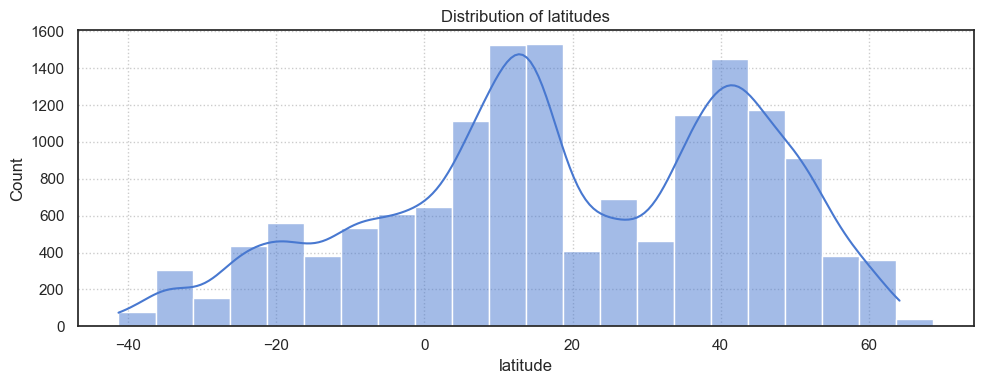

In [20]:
## Univariate Analysis to depict skewness in latitude atribute.

fig, my_ax = plt.subplots(figsize=(10,4))

sns.histplot(data = df_new['latitude'], binwidth=5, ax=my_ax, kde=True)

plt.grid(linestyle=':')
plt.title('Distribution of latitudes')
plt.tight_layout()
plt.show()

# There is minor right skewness of distribution of latitude towards higher outliers.

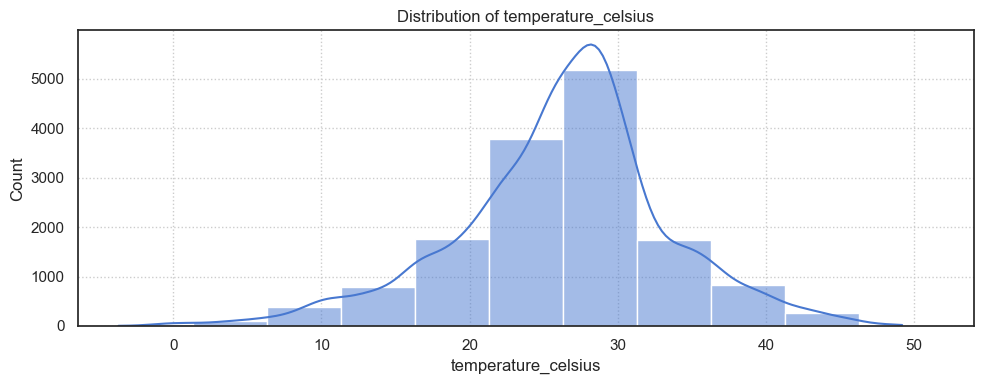

In [21]:
## Univariate Analysis to depict skewness in temperature_celsius atribute.

fig, my_ax = plt.subplots(figsize=(10,4))

sns.histplot(data = df_new['temperature_celsius'], binwidth=5, ax=my_ax, kde=True)

plt.grid(linestyle=':')
plt.title('Distribution of temperature_celsius')
plt.tight_layout()
plt.show()

# There is minor left skewness of distribution of temperature towards lower outliers.

In [ ]:
## Observation/Assumption about outliers:

## Most of these outlier values for eg:- in latitude attribute must be valid/represent natural variations in terms of business logic.. 
## Hence, we're considering them to be untreated as they are not anomalies in dataset.
## However, there are some outliers where there's considerable difference in mean and median, hence should be treated as it skews the distribution largely (even though they could be natural variation). 
### For eg:- in air_quality_Carbon_Monoxide attribute
## To conclude, we need a confirmation with SMEs who can help on this more.
## For now, we're assuming from data summary that all values below 95 percentile are valid and 
## anything above that should be treated for all metrices.

In [ ]:
## Outlier Treatment - Through Capping & Flooring.

# Any value outside the range between Capping (95th percentile) and Flooring (5th percentile)..
# is considered to be an outlier and hence, should be replaced with..
# Capping (95th percentile) value for higher extreme outliers..
## And Flooring (5th percentile) value for lower extreme outliers.

In [22]:
column = df_new.select_dtypes(include=['int','float'])
column       ## Depicting all metrices from dataset df_new.

,latitude,longitude,last_updated_epoch,temperature_celsius,temperature_fahrenheit,wind_mph,wind_kph,wind_degree,pressure_mb,pressure_in,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
0,34.52,69.18,1715849100,26.6,79.8,8.3,13.3,338,1012.0,29.89,...,15.3,277.0,103.0,1.1,0.2,8.4,26.6,1,1,55
1,41.33,19.82,1715849100,19.0,66.2,6.9,11.2,320,1012.0,29.88,...,18.4,193.6,97.3,0.9,0.1,1.1,2.0,1,1,55
2,36.76,3.05,1715849100,23.0,73.4,9.4,15.1,280,1011.0,29.85,...,22.3,540.7,12.2,65.1,13.4,10.4,18.4,1,1,55
3,42.50,1.52,1715849100,6.3,43.3,7.4,11.9,215,1007.0,29.75,...,13.7,170.2,64.4,1.6,0.2,0.7,0.9,1,1,55
4,-8.84,13.23,1715849100,26.0,78.8,8.1,13.0,150,1011.0,29.85,...,20.2,2964.0,19.0,72.7,31.5,183.4,262.3,5,10,55
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14883,10.50,-66.92,1722514500,21.5,70.7,4.5,7.2,165,1017.0,30.03,...,10.3,567.4,3.5,10.9,15.5,5.3,6.4,1,1,12
14884,21.03,105.85,1722514500,26.9,80.4,6.7,10.8,196,1003.0,29.61,...,18.0,1041.4,9.6,55.5,36.7,25.7,34.9,2,3,12
14885,15.35,44.21,1722514500,23.2,73.7,6.7,10.8,269,1010.0,29.84,...,12.4,237.0,65.8,1.7,3.5,12.6,35.8,1,2,12
14886,-15.42,28.28,1722514500,26.6,79.9,11.6,18.7,82,1018.0,30.05,...,21.5,594.1,81.5,1.3,2.3,10.9,15.4,1,1,12


In [23]:
for col in column:
    cap = df_new[col].quantile(0.95)                                         # Cap is the 95th percentile value
    floor = df_new[col].quantile(0.05)                                       # Floor is the 5th percentile value
    df_new[col] = df_new[col].apply(lambda x: cap if x > cap else x)         # Replacing higher extreme outliers with cap value.
    df_new[col] = df_new[col].apply(lambda x: floor if x < floor else x)     # Replacing lower extreme outliers with floor value.

In [24]:
# Post Outlier Treatment - Description of attributes

df_new.describe()

## It can be observed from below that min and max values have been updated post outlier treatment.

,latitude,longitude,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,wind_mph,wind_kph,wind_degree,pressure_mb,...,gust_kph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
count,14888.000000,14888.000000,1.488800e+04,14888,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,...,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000,14888.000000
mean,19.282005,22.201260,1.719076e+09,2024-06-22 19:38:47.498656768,26.341065,79.418517,8.587916,13.823059,178.389710,1012.033651,...,21.109921,346.562789,62.122434,6.697909,4.949369,10.789186,22.763387,1.296346,1.624127,53.272636
min,-24.650000,-84.138500,1.716043e+09,2024-05-16 01:45:00,13.035000,55.535000,2.200000,3.600000,17.000000,1000.000000,...,6.600000,161.900000,1.700000,0.100000,0.100000,0.600000,1.000000,1.000000,1.000000,1.000000
25%,3.750000,-6.840000,1.717424e+09,2024-06-03 10:15:00,22.400000,72.300000,4.300000,6.800000,95.000000,1009.000000,...,13.200000,186.900000,28.600000,0.500000,0.400000,2.000000,3.600000,1.000000,1.000000,21.000000
50%,17.250000,23.320000,1.719064e+09,2024-06-22 14:45:00,27.000000,80.600000,8.100000,13.000000,180.000000,1012.000000,...,20.200000,223.600000,59.400000,1.600000,1.200000,4.900000,8.700000,1.000000,1.000000,57.000000
75%,40.400000,49.880000,1.720702e+09,2024-07-11 14:45:00,30.200000,86.400000,11.900000,19.100000,260.000000,1016.000000,...,27.500000,363.800000,93.000000,5.400000,4.200000,13.800000,26.500000,1.000000,2.000000,86.000000
max,53.900000,147.190000,1.722255e+09,2024-08-02 01:15:00,38.000000,100.400000,18.600000,29.900000,340.000000,1022.000000,...,41.700000,1281.700000,140.200000,49.155000,32.400000,50.200000,113.200000,3.000000,6.000000,99.000000
std,23.494266,60.829444,1.931412e+06,NaN,6.385631,11.486761,4.755597,7.651627,99.157028,5.474098,...,9.885363,283.517555,39.867382,12.409577,8.586714,13.399847,30.873266,0.590589,1.293099,33.659215


In [ ]:
##----------------------------END OF SECTION - DATA PREPROCESSING---------------------------

<a id = Section6></a>

# 6. EXPLORATORY DATA ANALYSIS<a name="EXPLORATORY DATA ANALYSIS"></a>

1. Understanding Data granularity and Imbalances
2. Univariate Analysis of Metrices - Histogram, Boxplot
3. Univariate Analysis of Dimensions - Barchart
4. Bivariate Analysis - Correlation via scatter plot, Bivariate Bar chart & linechart
5. Time Tend Analysis - climate trend over months, days, time etc.

<a id = Section6.1></a>

### **6.1. DATA GRANULARITY AND DATA IMBALANCE**

In [27]:
# Extracting date and time attributes from last_updated attribute

df_new['Date'] = df_new['last_updated'].dt.date
df_new['Time'] = df_new['last_updated'].dt.time

In [28]:
df_new.info()  ## The Date attribute should be converted to datetime format

<class 'pandas.core.frame.DataFrame'>

RangeIndex: 14888 entries, 0 to 14887

Data columns (total 43 columns):

 #   Column                        Non-Null Count  Dtype         

---  ------                        --------------  -----         

 0   country                       14888 non-null  object        

 1   location_name                 14888 non-null  object        

 2   latitude                      14888 non-null  float64       

 3   longitude                     14888 non-null  float64       

 4   timezone                      14888 non-null  object        

 5   last_updated_epoch            14888 non-null  float64       

 6   last_updated                  14888 non-null  datetime64[ns]

 7   temperature_celsius           14888 non-null  float64       

 8   temperature_fahrenheit        14888 non-null  float64       

 9   condition_text                14888 non-null  object        

 10  wind_mph                      14888 non-null  float64       

 11  wind_kph    

In [29]:
df_new['Date'] = pd.to_datetime(df_new['Date']) # Converting the Date attribute to datetime format

In [30]:
## Analysing the Date attribute 

df_new[['Date']].value_counts()

## It can be observed below that each date has different number of value instances..
### which can be due to different daily weather record counts amongst all dates which implies..
### that unequal count of countries/city locations for which the weather credentials were recorded for different dates.
## This hypothesis can be tested in below section.

Date      
2024-05-16    378
2024-05-18    205
2024-06-29    198
2024-07-16    198
2024-07-09    198
             ... 
2024-06-25    181
2024-07-23    164
2024-07-13    147
2024-08-02      7
2024-07-21      6
Name: count, Length: 78, dtype: int64

In [31]:
df_16th_May = df_new[df_new['Date'] == '2024-05-16']  ## Creating a sub dataframe for date 16th May 2024
len(df_16th_May['country'].unique())                  ## Total 185 unique countries where weather was recorded on 16th May 2024

185

In [32]:
df_25th_June = df_new[df_new['Date'] == '2024-06-25 ']  ## Creating a sub dataframe for date 25th June 2024
len(df_25th_June['country'].unique())           ## ## Total 173 unique countries where weather was recorded on 16th May 2024

173

In [317]:
## Hence, it can be proved that number of countries for which daily weather was recorded is..
### different for different dates.

In [33]:
df_16th_May[df_16th_May['country'] == 'Albania']

## It can also be concluded (from below) that weather was recorded multiple times for a specific country/location on a single date.

,country,location_name,latitude,longitude,timezone,last_updated_epoch,last_updated,temperature_celsius,temperature_fahrenheit,condition_text,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
1,Albania,Tirana,41.33,19.82,Europe/Tirane,1.716043e+09,2024-05-16 10:45:00,19.0,66.2,Partly Cloudy,...,1.0,1.0,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
196,Albania,Tirana,41.33,19.82,Europe/Tirane,1.716043e+09,2024-05-16 16:00:00,29.0,84.2,Partly Cloudy,...,1.0,1.0,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55.0,2024-05-16,16:00:00


In [319]:
## Critical conclusions about the dataset:

# 1. The data granularity for this weather dataset is at the time level in a specific date for a specific city location.
# 2. This weather dataset is recorded for a span of 78 days i.e between 16th May to 2nd Aug 2024.
# 3. The number of unique countries for this data recorded are 210 and unique locations are 247.
# 4. Weather detail is recorded multiple times for one country/location in a specific day i.e for different times.
# 5. Data imbalanced - All unique dates don't have equal number of countries associated with them.
# 6. Some dates have as high as 378 instances of weather recorded in a day (eg:- 16th May 2024)
# 7. Wherease some countries have as low as 6 instances of weather recorded in a day (eg:- 21st July 2024).
# 8. This data imbalance can certainly influence our analysis and findings as strong bias towards some countries.

In [34]:
# Dropping the last_updated_epoch column as it doesn't provide any insight to the data analysis.

df_new.drop('last_updated_epoch', axis=1, inplace=True)


In [35]:
# Dropping one instance from metrices of same weather parameter but with different units.
## For eg:- wind_mph and wind_kph are both wind speeds but in different units (mph and kph).
## Hence, retaining one of the windspeed parameters in dataset to reduce redundant dimensions.

df_new.drop(['temperature_fahrenheit','wind_kph','pressure_in','precip_in','feels_like_fahrenheit','visibility_miles','gust_kph'],axis=1, inplace=True)

<a id = Section6.2></a>

### **6.2. UNIVARIATE ANALYSIS OF METRICS**

In [36]:
df_new.select_dtypes(include=['int','float'])  ## Selecting all the metrices columns in dataframe

,latitude,longitude,temperature_celsius,wind_mph,wind_degree,pressure_mb,precip_mm,humidity,cloud,feels_like_celsius,...,gust_mph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
0,34.52,69.18,26.600,8.3,338.0,1012.0,0.0,24.0,30.00,25.3,...,9.5,277.0,103.0,1.100,0.2,8.4,26.6,1.0,1.0,55.0
1,41.33,19.82,19.000,6.9,320.0,1012.0,0.1,94.0,75.00,19.0,...,11.4,193.6,97.3,0.900,0.1,1.1,2.0,1.0,1.0,55.0
2,36.76,3.05,23.000,9.4,280.0,1011.0,0.0,29.0,0.00,24.6,...,13.9,540.7,12.2,49.155,13.4,10.4,18.4,1.0,1.0,55.0
3,42.50,1.52,13.035,7.4,215.0,1007.0,0.3,61.0,94.65,12.5,...,8.5,170.2,64.4,1.600,0.2,0.7,1.0,1.0,1.0,55.0
4,-8.84,13.23,26.000,8.1,150.0,1011.0,0.0,89.0,50.00,28.7,...,12.5,1281.7,19.0,49.155,31.5,50.2,113.2,3.0,6.0,55.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14883,10.50,-66.92,21.500,4.5,165.0,1017.0,0.0,80.0,6.00,21.5,...,6.4,567.4,3.5,10.900,15.5,5.3,6.4,1.0,1.0,12.0
14884,21.03,105.85,26.900,6.7,196.0,1003.0,0.0,84.0,53.00,30.5,...,11.2,1041.4,9.6,49.155,32.4,25.7,34.9,2.0,3.0,12.0
14885,15.35,44.21,23.200,6.7,269.0,1010.0,0.1,44.0,84.00,24.6,...,7.7,237.0,65.8,1.700,3.5,12.6,35.8,1.0,2.0,12.0
14886,-15.42,28.28,26.600,11.6,82.0,1018.0,0.0,15.0,0.00,24.9,...,13.4,594.1,81.5,1.300,2.3,10.9,15.4,1.0,1.0,12.0


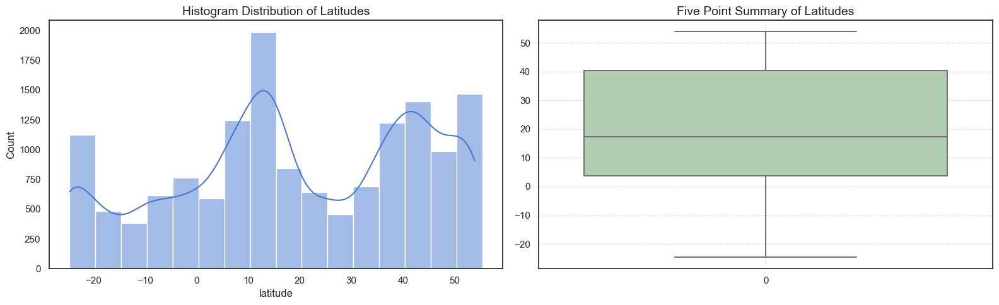

In [37]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['latitude'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Latitudes', size=14)

# Boxplot
sns.boxplot(df_new['latitude'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Latitudes', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:
# Latitude is normally distributed.
# Most of weather recorded in dataset is for latitudes between 10 and 15 degree North of equator (+10 to +15 degrees). 

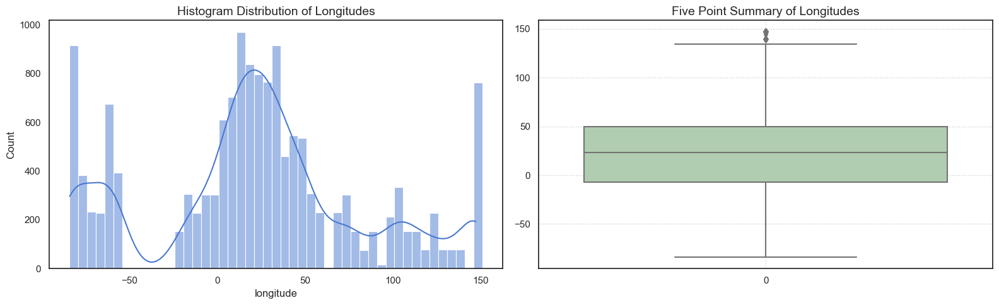

In [38]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['longitude'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Longitudes', size=14)

# Boxplot
sns.boxplot(df_new['longitude'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Longitudes', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference

# Longitude is normally distributed. 
# Most of weather recorded in dataset is for longitudes between 10 and 15 degree East of prime meridian (+10 to +15 degrees).

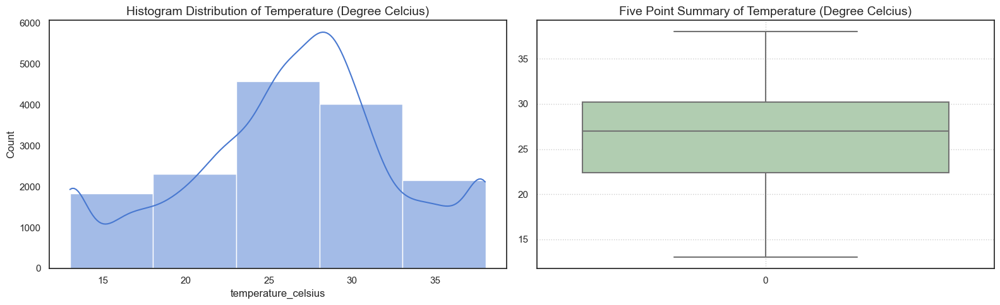

In [39]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['temperature_celsius'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Temperature (Degree Celcius)', size=14)

# Boxplot
sns.boxplot(df_new['temperature_celsius'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Temperature (Degree Celcius)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Temperature is normally distributed
# Most of weather recorded in dataset has temperature between 25  to 30  degree celsius.

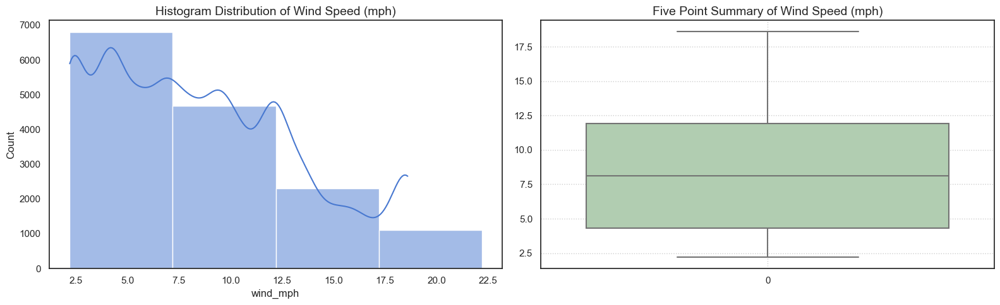

In [40]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['wind_mph'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Wind Speed (mph)', size=14)

# Boxplot
sns.boxplot(df_new['wind_mph'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Wind Speed (mph)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Wind speed  is normally distributed.
# Most of weather recorded in dataset has wind speed ranging from  2.5 to 7.5 mph.

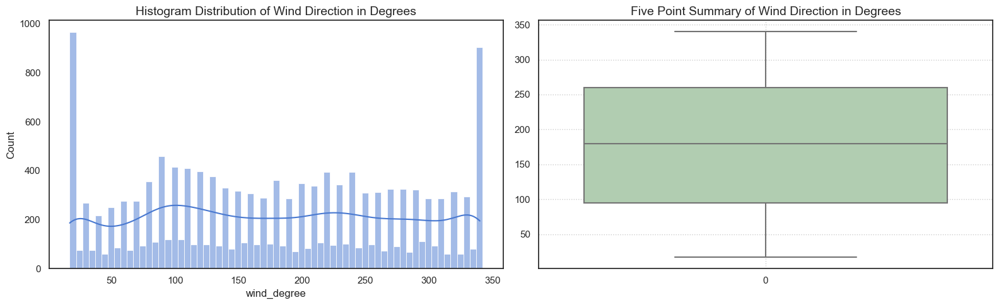

In [41]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['wind_degree'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Wind Direction in Degrees', size=14)

# Boxplot
sns.boxplot(df_new['wind_degree'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Wind Direction in Degrees', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Wind direction degrees is normally distributed.
# Most of weather recorded in dataset has wind degree ranging from  90 to 95 degrees.

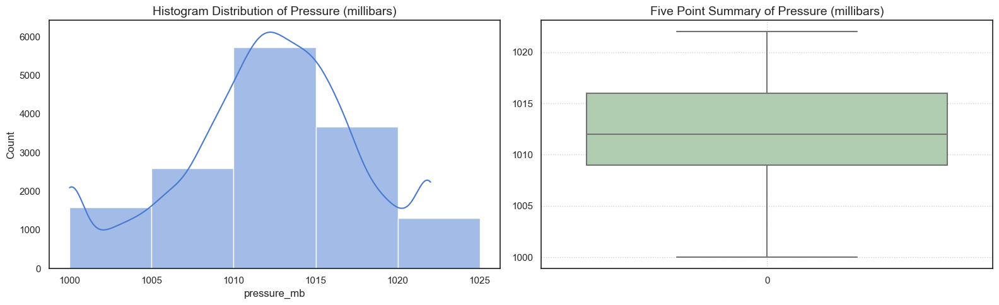

In [42]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['pressure_mb'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Pressure (millibars)', size=14)

# Boxplot
sns.boxplot(df_new['pressure_mb'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Pressure (millibars)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Pressure is normally distributed.
# Most of weather recorded in dataset has pressure ranging between 1010 to 1015 millibars.

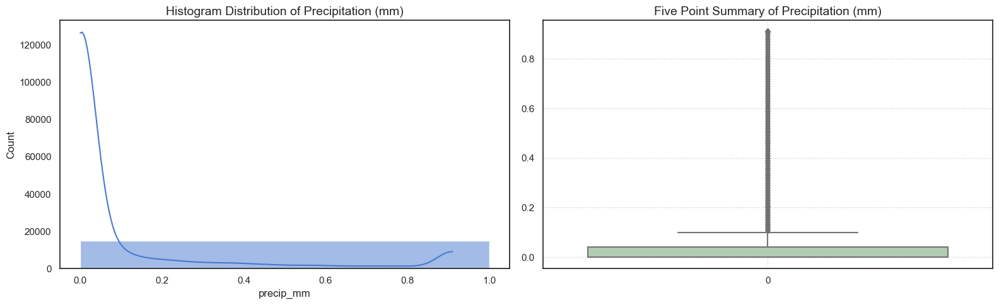

In [43]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['precip_mm'], binwidth=1, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Precipitation (mm)', size=14)

# Boxplot
sns.boxplot(df_new['precip_mm'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Precipitation (mm)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Precipitation has negligible values (0 units) from minimum to 75th quantile of data.
# Maximum has value touching 0.91 units.

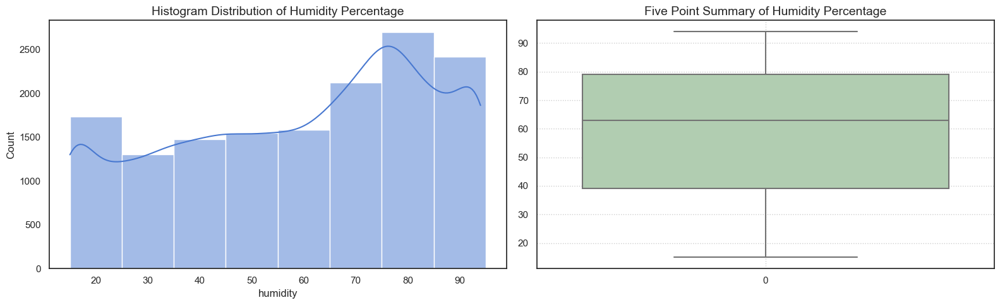

In [44]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['humidity'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Humidity Percentage', size=14)

# Boxplot
sns.boxplot(df_new['humidity'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Humidity Percentage', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Humidity is normally distributed with minor left skewness.
# Most of weather recorded in dataset have humidity percentage between 75 to 85 percent. 

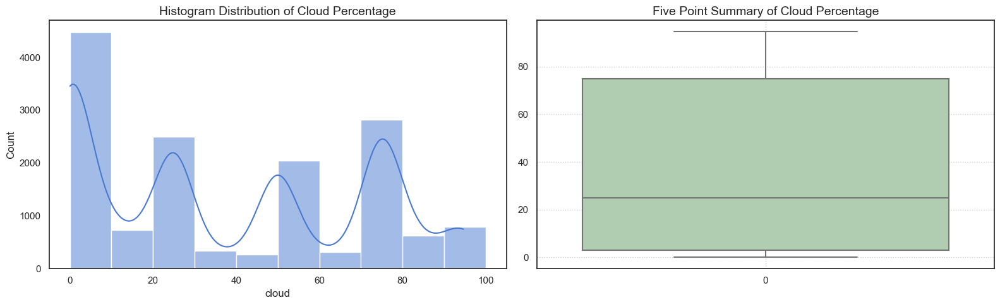

In [45]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['cloud'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Cloud Percentage', size=14)

# Boxplot
sns.boxplot(df_new['cloud'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Cloud Percentage', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Cloud cover percentage is normally distributed with some right skewness. (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has cloud cover percentage ranging from 0 to 10 percent. 

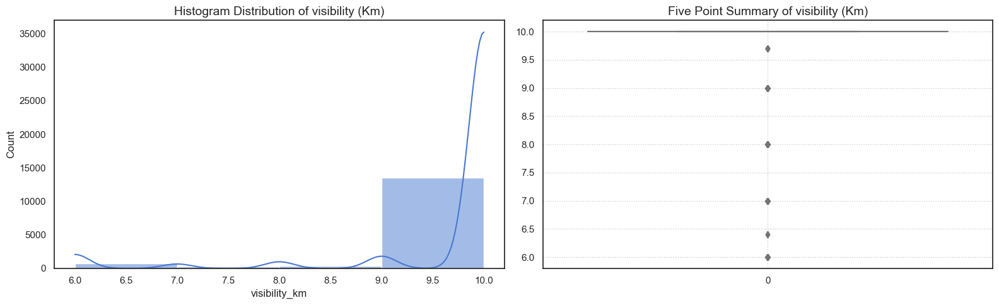

In [47]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['visibility_km'], binwidth=1, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of visibility (Km)', size=14)

# Boxplot
sns.boxplot(df_new['visibility_km'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of visibility (Km)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Visibility range is normally distributed with some minor left skewness. 
# Most of weather recorded in dataset has visibility ranging from 9 to 10 kms.

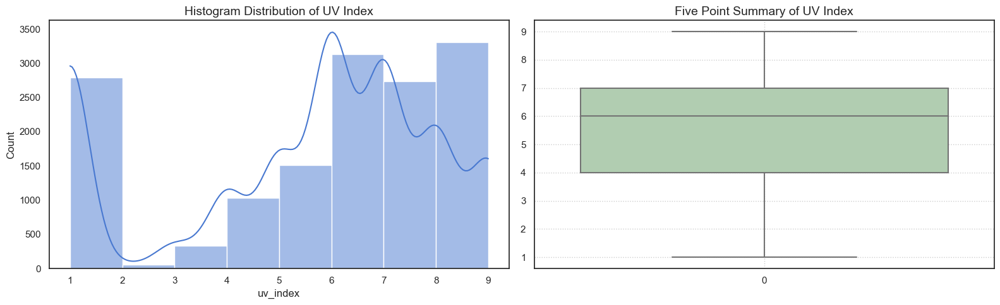

In [48]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['uv_index'], binwidth=1, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of UV Index', size=14)

# Boxplot
sns.boxplot(df_new['uv_index'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of UV Index', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# UV index is normally distributed
# Most of weather recorded in dataset has uv index ranging between 8 and 9 units. 

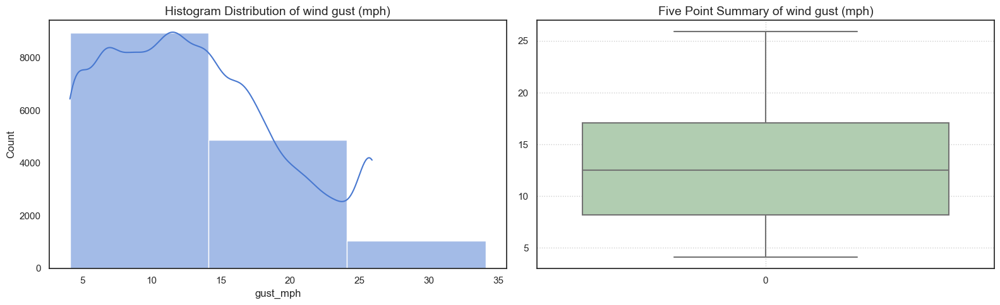

In [49]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['gust_mph'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of wind gust (mph)', size=14)

# Boxplot
sns.boxplot(df_new['gust_mph'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of wind gust (mph)', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Wind gust is normally distributed
# Most of weather recorded in dataset has Air quality measurement: carbon monoxide ranging between 161 to 14 mph. 

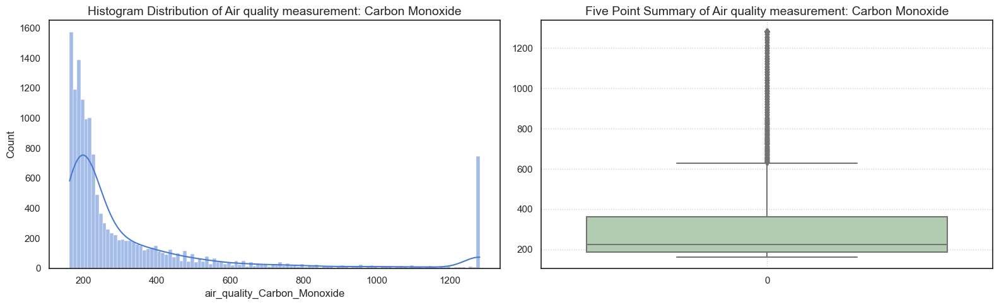

In [50]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_Carbon_Monoxide'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: Carbon Monoxide', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_Carbon_Monoxide'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: Carbon Monoxide', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# air_quality_Carbon_Monoxide is normally distributed with some right skewness. (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: carbon monoxide.. 
# ranging between 161 and 171 units.

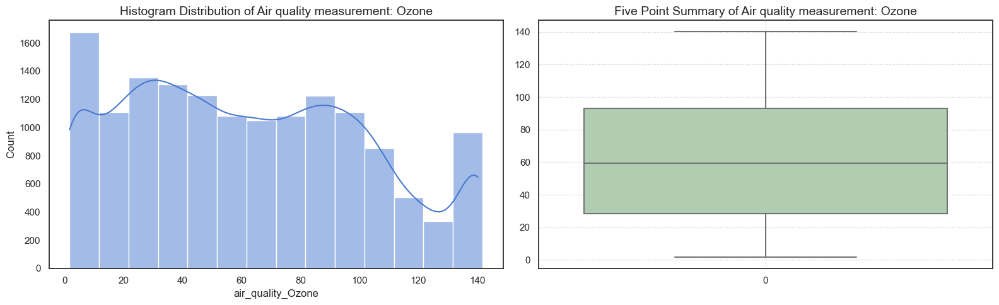

In [51]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_Ozone'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: Ozone', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_Ozone'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: Ozone', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality meaurement: Ozone is normally distributed with some right skewness. (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: ozone.. 
# ranging between 0 and 10 units.

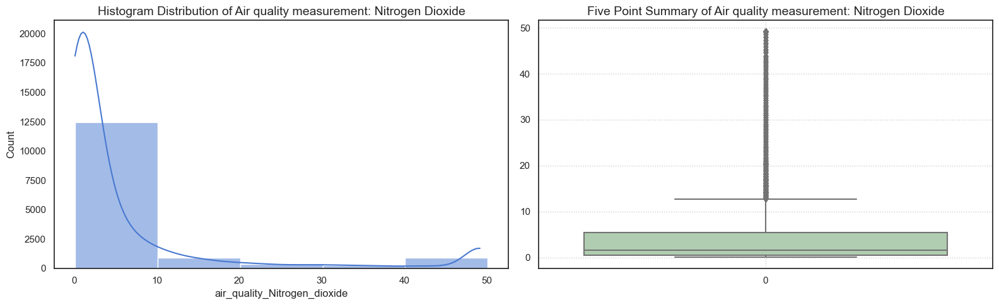

In [52]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_Nitrogen_dioxide'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: Nitrogen Dioxide', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_Nitrogen_dioxide'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: Nitrogen Dioxide', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality measurement: Nitrogen Dioxide is normally distributed with some high right skewness. 
# (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which..
## can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: Nitrogen Dioxide.. 
# ranging between 0 and 10 units.

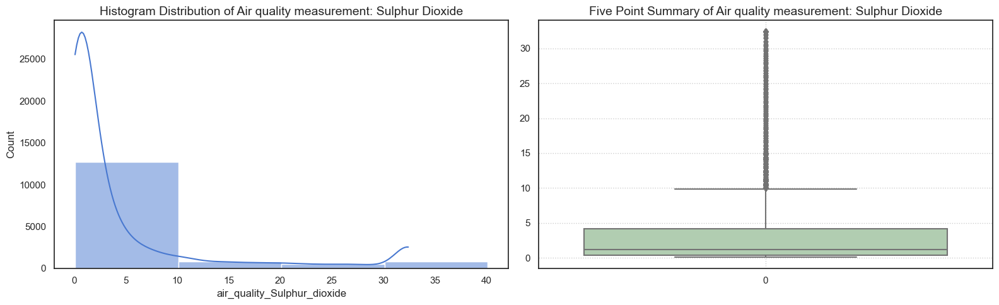

In [53]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_Sulphur_dioxide'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: Sulphur Dioxide', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_Sulphur_dioxide'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: Sulphur Dioxide', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality measurement: Sulphur Dioxide is normally distributed with some high right skewness. 
# (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which..
## can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: Sulphur Dioxide.. 
# ranging between 0 and 10 units.

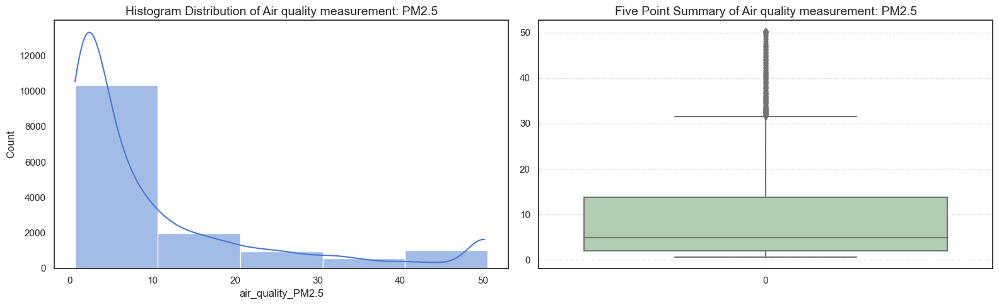

In [54]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_PM2.5'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: PM2.5', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_PM2.5'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: PM2.5', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality measurement: PM2.5 is normally distributed with some high right skewness. 
# (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which..
## can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: PM2.5 ranging between 0 and 10 units.

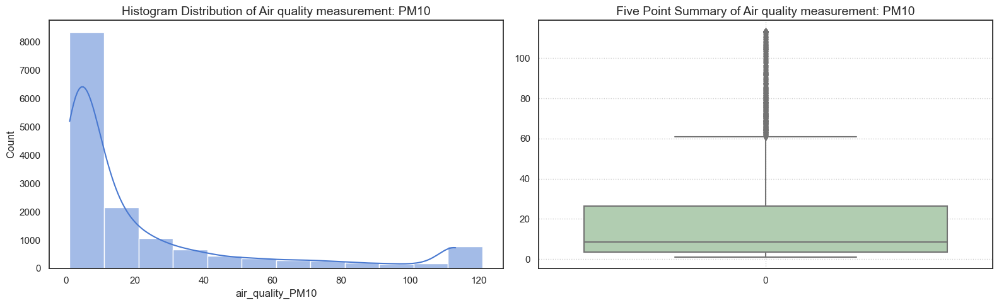

In [55]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_PM10'], binwidth=10, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: PM10', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_PM10'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: PM10', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality measurement: PM10 is normally distributed with some high right skewness. 
# (This is post outlier treatment. This is primarily due to still presence of relatively higher extreme values which..
## can’t be avoided being possible natural variation.)
# Most of weather recorded in dataset has Air quality measurement: PM10 ranging between 0 and 10 units.

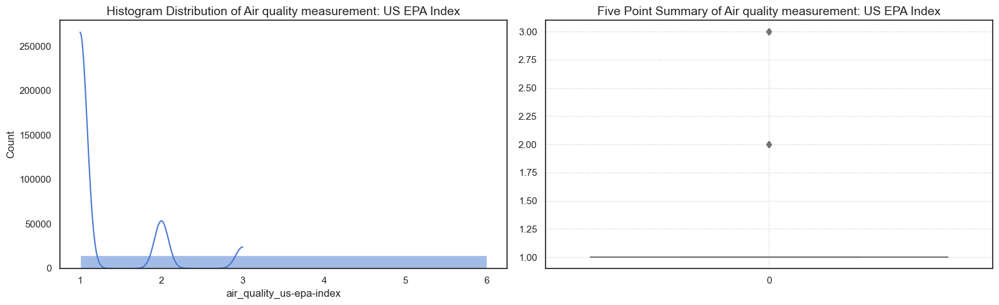

In [56]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_us-epa-index'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: US EPA Index', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_us-epa-index'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: US EPA Index', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality meaurement: US EPA Index is normally distributed. 
# Most of weather recorded in dataset has Air quality measurement: US EPA ranging between 1 and 2 units.

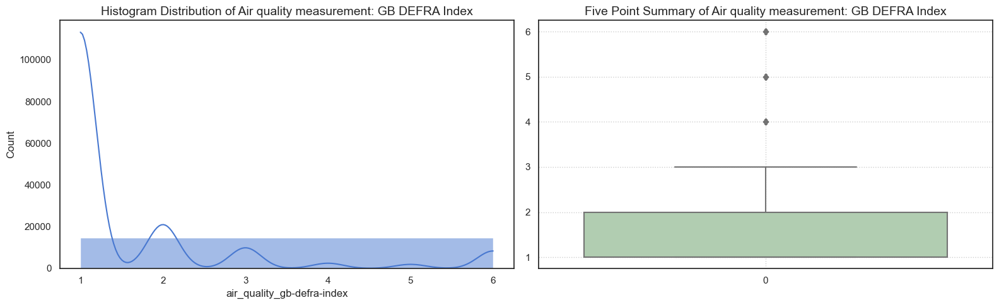

In [57]:
fig, my_ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))

# Histogram
sns.histplot(data = df_new['air_quality_gb-defra-index'], binwidth=5, ax=my_ax[0], kde=True)
my_ax[0].set_title('Histogram Distribution of Air quality measurement: GB DEFRA Index', size=14)

# Boxplot
sns.boxplot(df_new['air_quality_gb-defra-index'], color='lightgreen', saturation=0.3, ax=my_ax[1])
my_ax[1].set_title('Five Point Summary of Air quality measurement: GB DEFRA Index', size=14)

plt.grid(linestyle=':')
plt.tight_layout()
plt.show()

# Inference:

# Air quality meaurement: GB Defra Index is normally distributed. 
# Most of weather recorded in dataset has Air quality measurement: GB Defra ranging between 1 and 2 units.

In [721]:
##----------------------------END OF SECTION - Univariate Analysis of Metrics---------------------------##

<a id = Section6.3></a>

### **6.3. UNIVARIATE ANALYSIS OF DIMENSIONS**

In [58]:
df_new.select_dtypes(include=['object'])  ## Selecting all the dimensions columns in dataframe

,country,location_name,timezone,condition_text,wind_direction,sunrise,sunset,moonrise,moonset,moon_phase,Time
0,Afghanistan,Kabul,Asia/Kabul,Partly Cloudy,NNW,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,13:15:00
1,Albania,Tirana,Europe/Tirane,Partly Cloudy,NW,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,10:45:00
2,Algeria,Algiers,Africa/Algiers,Sunny,W,05:40 AM,07:50 PM,01:15 PM,02:14 AM,Waxing Gibbous,09:45:00
3,Andorra,Andorra La Vella,Europe/Andorra,Light drizzle,SW,06:31 AM,09:11 PM,02:12 PM,03:31 AM,Waxing Gibbous,10:45:00
4,Angola,Luanda,Africa/Luanda,Partly Cloudy,SSE,06:12 AM,05:55 PM,01:17 PM,12:38 AM,Waxing Gibbous,09:45:00
...,...,...,...,...,...,...,...,...,...,...,...
14883,Venezuela,Caracas,America/Caracas,Sunny,SSE,06:17 AM,06:51 PM,03:34 AM,04:49 PM,Waning Crescent,08:15:00
14884,Vietnam,Hanoi,Asia/Bangkok,Partly Cloudy,SSW,05:31 AM,06:35 PM,02:09 AM,04:17 PM,Waning Crescent,19:15:00
14885,Yemen,Sanaa,Asia/Aden,Patchy rain nearby,W,05:46 AM,06:33 PM,02:40 AM,04:19 PM,Waning Crescent,15:15:00
14886,Zambia,Lusaka,Africa/Lusaka,Sunny,E,06:30 AM,05:57 PM,03:58 AM,03:14 PM,Waning Crescent,14:15:00


In [59]:
## Analysing country attribute

len(df_new['country'].unique())    

# Total 198 unique countries in this dataset for which weather is recorded.
# Slicing to Top 50 and Least 50 countries for bar charts/countplots as plotting 210 countries
# in a chart will be cumbersome.

198

In [ ]:
## Analysing the Top 50 countries according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [60]:
max = df_new['country'].value_counts().head(50)
df_max_country = pd.DataFrame(max).reset_index()
list_max = df_max_country['country'].to_numpy()

In [61]:
list_max     ## List of Top 50 countries with most number of times weather recorded

array(['Bulgaria', 'Indonesia', 'Sudan', 'Iran', 'Madagascar', 'Turkey',
       'Bolivia', 'Thailand', 'Belgium', 'Vietnam', 'Russia', 'Malaysia',
       'Kenya', 'Malta', 'Marshall Islands', 'Afghanistan', 'Mauritania',
       'Mali', 'Mexico', 'Mozambique', 'Myanmar', 'Mauritius', 'Kuwait',
       'Albania', 'Nigeria', 'Jordan', 'Japan', 'Jamaica', 'Iraq',
       'Iceland', 'Hungary', 'Vatican City', 'Haiti', 'Guyana',
       'New Zealand', 'Poland', 'Oman', 'Panama', 'Zambia', 'Yemen',
       'Venezuela', 'Uzbekistan', 'Uruguay', 'United Arab Emirates',
       'Ukraine', 'Tuvalu', 'Turkmenistan', 'Trinidad and Tobago',
       'Tonga', 'Tanzania'], dtype=object)

In [62]:
Top_50_country_by_weather_recorded_frequency = df_new[df_new['country'].isin(list_max)]
Top_50_country_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,2024-05-16 13:15:00,26.600,Partly Cloudy,8.3,338.0,...,1.0,1.0,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55.0,2024-05-16,13:15:00
1,Albania,Tirana,41.33,19.82,Europe/Tirane,2024-05-16 10:45:00,19.000,Partly Cloudy,6.9,320.0,...,1.0,1.0,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
16,Belgium,Brussels,50.83,4.33,Europe/Brussels,2024-05-16 10:45:00,15.000,Partly Cloudy,3.8,240.0,...,1.0,2.0,05:52 AM,09:28 PM,01:45 PM,03:38 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
20,Bolivia,Sucre,-19.04,-65.26,America/La_Paz,2024-05-16 04:45:00,13.035,Clear,2.2,17.0,...,1.0,1.0,06:41 AM,05:53 PM,01:48 PM,12:51 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
25,Bulgaria,Sofia,42.68,23.32,Europe/Sofia,2024-05-16 11:45:00,13.035,Overcast,12.5,110.0,...,1.0,1.0,06:03 AM,08:44 PM,01:41 PM,03:02 AM,Waxing Gibbous,55.0,2024-05-16,11:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14881,Uzbekistan,Tashkent,41.32,69.25,Asia/Tashkent,2024-08-01 17:15:00,38.000,Sunny,11.0,292.0,...,1.0,2.0,05:19 AM,07:40 PM,01:34 AM,05:57 PM,Waning Crescent,12.0,2024-08-01,17:15:00
14883,Venezuela,Caracas,10.50,-66.92,America/Caracas,2024-08-01 08:15:00,21.500,Sunny,4.5,165.0,...,1.0,1.0,06:17 AM,06:51 PM,03:34 AM,04:49 PM,Waning Crescent,12.0,2024-08-01,08:15:00
14884,Vietnam,Hanoi,21.03,105.85,Asia/Bangkok,2024-08-01 19:15:00,26.900,Partly Cloudy,6.7,196.0,...,2.0,3.0,05:31 AM,06:35 PM,02:09 AM,04:17 PM,Waning Crescent,12.0,2024-08-01,19:15:00
14885,Yemen,Sanaa,15.35,44.21,Asia/Aden,2024-08-01 15:15:00,23.200,Patchy rain nearby,6.7,269.0,...,1.0,2.0,05:46 AM,06:33 PM,02:40 AM,04:19 PM,Waning Crescent,12.0,2024-08-01,15:15:00


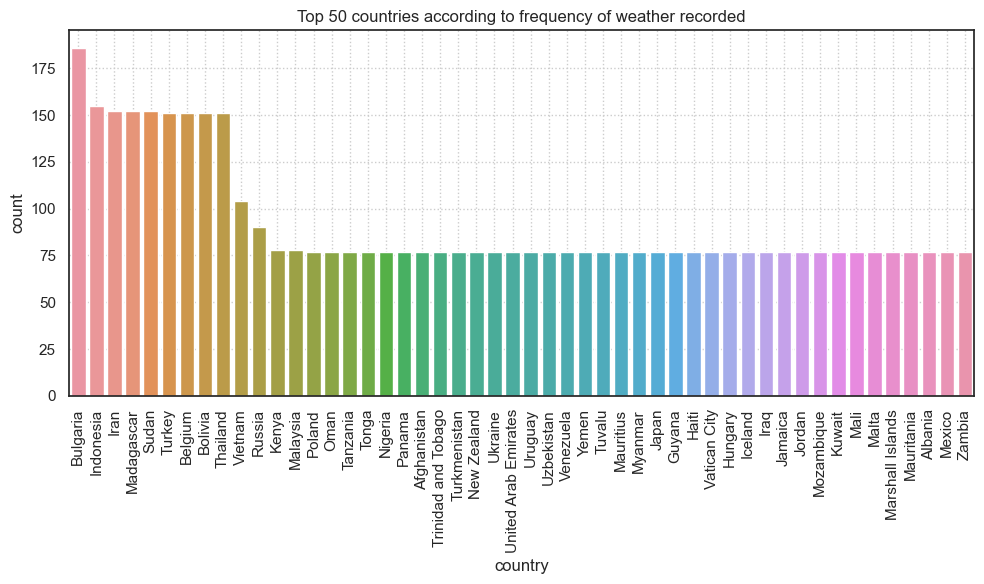

In [63]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Top_50_country_by_weather_recorded_frequency, 
              x=Top_50_country_by_weather_recorded_frequency['country'], 
              order=Top_50_country_by_weather_recorded_frequency['country'].value_counts().index, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Top 50 countries according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Bulgaria tops the list with highest number of times (186 times) weather recorded in a period - 16th May to 2nd Aug 2024.
## After Bulgaria, Indonesia to Thailand have almost same number of times weather record (around 150 times).
### Post that, Kenya to Zambia have almost same number of times weather record (around 77 times).

In [ ]:
## Analysing the Least 50 countries according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [64]:
min = df_new['country'].value_counts().sort_values(ascending=True).head(50)
df_min_country = pd.DataFrame(min).reset_index()
list_min = df_min_country['country'].to_numpy()
list_min    ## List of Least 50 countries with number of times weather recorded

array(['Kingdom of Istanbul', 'Colombia',
       "Lao People's Democratic Republic", 'Libya', 'Kosovo', 'Togo',
       'Belgica', 'Republic of Gautemala', 'Beirut', 'Polania', 'Nauru',
       'Komoren', 'USA United States of America', 'San Marino',
       'Maldives', 'Czech Republic', 'Guatemala',
       'Democratic Republic of Congo', 'Sierra Leone', 'Greece',
       'Antigua and Barbuda', 'Bahamas', 'Timor-Leste',
       'United States of America', 'Georgia', 'Zimbabwe', 'Gambia',
       'United Kingdom', 'Kiribati', 'El Salvador', 'Portugal', 'Grenada',
       'Macedonia', 'Comoros', 'Cameroon', 'Monaco', 'Ethiopia',
       'Djibouti', 'Luxembourg', 'Croatia', 'Slovakia',
       'Seychelles Islands', 'Serbia', 'Niger', 'Brunei Darussalam',
       'China', 'Costa Rica', 'Nicaragua', 'Burkina Faso', 'Liberia'],
      dtype=object)

In [65]:
Least_50_country_by_weather_recorded_frequency = df_new[df_new['country'].isin(list_min)]
Least_50_country_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
5,Antigua and Barbuda,Saint John's,17.12,-61.8500,America/Antigua,2024-05-16 04:45:00,26.000,Partly Cloudy,5.6,90.0,...,1.0,1.0,05:36 AM,06:32 PM,01:05 PM,01:14 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
11,Bahamas,Nassau,25.08,-77.3500,America/Nassau,2024-05-16 04:45:00,27.000,Partly Cloudy,16.1,180.0,...,1.0,2.0,06:24 AM,07:48 PM,02:01 PM,02:26 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
24,Brunei Darussalam,Bandar Seri Begawan,4.88,114.9300,Asia/Brunei,2024-05-16 16:45:00,32.000,Patchy light rain with thunder,6.9,310.0,...,1.0,1.0,06:06 AM,06:27 PM,01:06 PM,12:54 AM,Waxing Gibbous,55.0,2024-05-16,16:45:00
26,Burkina Faso,Ouagadougou,12.37,-1.5200,Africa/Ouagadougou,2024-05-16 08:45:00,32.000,Moderate or heavy rain with thunder,6.9,230.0,...,1.0,1.0,05:42 AM,06:24 PM,12:59 PM,01:01 AM,Waxing Gibbous,55.0,2024-05-16,08:45:00
31,Cameroon,Yaounde,3.87,11.5200,Africa/Douala,2024-05-16 09:45:00,25.000,Partly Cloudy,2.2,55.0,...,2.0,3.0,06:01 AM,06:19 PM,01:13 PM,12:59 AM,Waxing Gibbous,55.0,2024-05-16,09:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14850,Slovakia,Bratislava,48.15,17.1200,Europe/Bratislava,2024-08-01 14:15:00,32.100,Sunny,4.0,307.0,...,1.0,1.0,05:28 AM,08:27 PM,01:35 AM,07:09 PM,Waning Crescent,12.0,2024-08-01,14:15:00
14867,Timor-Leste,Dili,-8.56,125.5700,Asia/Dili,2024-08-01 21:15:00,24.100,Clear,6.7,132.0,...,1.0,1.0,06:52 AM,06:36 PM,03:57 AM,03:46 PM,Waning Crescent,12.0,2024-08-01,21:15:00
14878,United Kingdom,London,51.52,-0.1100,Europe/London,2024-08-01 13:15:00,27.900,Partly Cloudy,5.1,56.0,...,1.0,1.0,05:25 AM,08:48 PM,01:22 AM,07:44 PM,Waning Crescent,12.0,2024-08-01,13:15:00
14879,United States of America,Washington Harbor,48.08,-84.1385,America/Los_Angeles,2024-08-01 05:15:00,13.035,Clear,2.9,268.0,...,1.0,1.0,05:49 AM,08:47 PM,02:17 AM,07:48 PM,Waning Crescent,12.0,2024-08-01,05:15:00


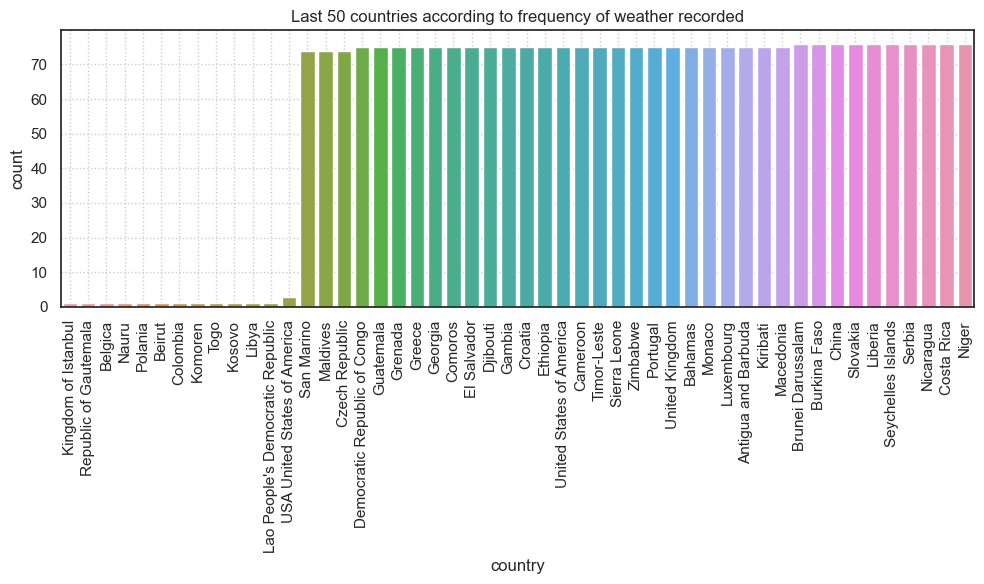

In [66]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Least_50_country_by_weather_recorded_frequency, 
              x=Least_50_country_by_weather_recorded_frequency['country'], 
              order=Least_50_country_by_weather_recorded_frequency['country'].value_counts().sort_values(ascending=True).index, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Last 50 countries according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Kingdom of Istanbul to Lao People's Democratic have the least number of times (1 instance) weather recorded in a period - 16th May to 2nd Aug 2024.
## followed by USA (3 times) and.. 
### further followed by San Marino to Niger with 70+ times weather recorded.

In [67]:
# Analysing the location attribute

df_new['location_name'].unique()   # Finding the unique values for location

# Found an ambiguous location name - '-Kingdom'. It's value can be deduced from the timezone/country value - 'Istanbul' 

array(['Kabul', 'Tirana', 'Algiers', 'Andorra La Vella', 'Luanda',
       "Saint John's", 'Buenos Aires', 'Yerevan', 'Canberra', 'Vienna',
       'Baku', 'Nassau', 'Manama', 'Dhaka', 'Bridgetown', 'Minsk',
       'Brussels', 'Belmopan', 'Porto-Novo', 'Thimphu', 'Sucre',
       'Sarajevo', 'Gaborone', 'Bras', 'Bandar Seri Begawan', 'Sofia',
       'Ouagadougou', 'Bujumbura', 'Ivory', 'Praia', 'Phnom Penh',
       'Yaounde', 'Ottawa', 'Bangui', "N'djamena", 'Santiago', 'Beijing',
       'Bogot', 'Moroni', 'Brazzaville', 'San Juan', 'Zagreb', 'Havana',
       'Nicosia', 'Prague', 'Kinshasa', 'Copenhagen', 'Djibouti',
       'Roseau', 'Santo Domingo', 'Quito', 'Cairo', 'San Salvador',
       'Malabo', 'Asmara', 'Tallinn', 'Mbabane', 'Addis Ababa', 'Suva',
       'Helsinki', 'Paris', 'Libreville', 'Banjul', 'Tbilisi', 'Berlin',
       'Accra', 'Athens', "Saint George's", 'Guatemala City', 'Conakry',
       'Bissau', 'Georgetown', 'Port-Au-Prince', 'Vatican City',
       'Tegucigalpa', 'Buda

In [68]:
df_new['location_name'] = df_new['location_name'].replace('-Kingdom', 'Istanbul') 

# Replacing the '-Kingdom' value with Istanbul.

In [69]:
len(df_new['location_name'].unique())

# Total 247 unique locations in this dataset for which weather is recorded.
# Slicing to Top 50 and Least 50 locations for bar charts/countplots as plotting 247 locations
# in a chart will be cumbersome.

247

In [ ]:
## Analysing the Top 50 locations according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [70]:
maxl = df_new['location_name'].value_counts().head(50)  # Extracting top 50 locations with most number of time weather recorded. 
df_max_location = pd.DataFrame(maxl).reset_index()      # Converting top 50 locations collection to new dataframe df_max_location.
list_maxl = df_max_location['location_name'].to_numpy() # Converting location_name from df_max_location to an array using numpy and storing it in list_maxl.
list_maxl

array(['Kabul', 'Tokyo', 'Port Louis', 'Nouakchott', 'Majuro', 'Valletta',
       'Bamako', 'Kuala Lumpur', 'Lilongwe', 'Antananarivo', 'Beirut',
       'Nairobi', 'Amman', 'Baghdad', 'Tirana', 'Tehran', 'Jakarta',
       'Budapest', 'Vatican City', 'Port-Au-Prince', 'Georgetown',
       'Bissau', 'Conakry', 'Accra', 'Berlin', 'Paris', 'Maputo', 'Abuja',
       'Suva', 'Seoul', 'Lusaka', 'Sanaa', 'Caracas', 'Tashkent',
       'Montevideo', 'Abu Dhabi', 'Kyiv', 'Funafuti', 'Port Of Spain',
       'Dodoma', 'Bern', 'Pretoria', 'Muscat', 'Honiara', 'Ljubljana',
       'Singapore', 'Dakar', 'Kingstown', 'Castries', 'Basseterre'],
      dtype=object)

In [71]:
# Creating a new dataframe for Top 50 locations according to number of times weather recorded.

Top_50_location_by_weather_recorded_frequency = df_new[df_new['location_name'].isin(list_maxl)]
Top_50_location_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,2024-05-16 13:15:00,26.6,Partly Cloudy,8.3,338.0,...,1.0,1.0,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55.0,2024-05-16,13:15:00
1,Albania,Tirana,41.33,19.82,Europe/Tirane,2024-05-16 10:45:00,19.0,Partly Cloudy,6.9,320.0,...,1.0,1.0,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
58,Fiji Islands,Suva,-18.13,147.19,Pacific/Fiji,2024-05-16 20:45:00,26.0,Light rain shower,9.4,100.0,...,1.0,1.0,06:25 AM,05:41 PM,01:09 PM,12:04 AM,Waxing Gibbous,55.0,2024-05-16,20:45:00
60,France,Paris,48.87,2.33,Europe/Paris,2024-05-16 10:45:00,15.0,Partly Cloudy,10.5,240.0,...,1.0,1.0,06:07 AM,09:28 PM,01:57 PM,03:41 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
64,Germany,Berlin,52.52,13.40,Europe/Berlin,2024-05-16 10:45:00,22.0,Sunny,18.6,120.0,...,1.0,1.0,05:08 AM,08:58 PM,01:03 PM,03:06 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14880,Uruguay,Montevideo,-24.65,-56.17,America/Montevideo,2024-08-01 09:15:00,15.7,Partly Cloudy,13.0,18.0,...,1.0,1.0,07:39 AM,06:04 PM,05:46 AM,03:09 PM,Waning Crescent,12.0,2024-08-01,09:15:00
14881,Uzbekistan,Tashkent,41.32,69.25,Asia/Tashkent,2024-08-01 17:15:00,38.0,Sunny,11.0,292.0,...,1.0,2.0,05:19 AM,07:40 PM,01:34 AM,05:57 PM,Waning Crescent,12.0,2024-08-01,17:15:00
14883,Venezuela,Caracas,10.50,-66.92,America/Caracas,2024-08-01 08:15:00,21.5,Sunny,4.5,165.0,...,1.0,1.0,06:17 AM,06:51 PM,03:34 AM,04:49 PM,Waning Crescent,12.0,2024-08-01,08:15:00
14885,Yemen,Sanaa,15.35,44.21,Asia/Aden,2024-08-01 15:15:00,23.2,Patchy rain nearby,6.7,269.0,...,1.0,2.0,05:46 AM,06:33 PM,02:40 AM,04:19 PM,Waning Crescent,12.0,2024-08-01,15:15:00


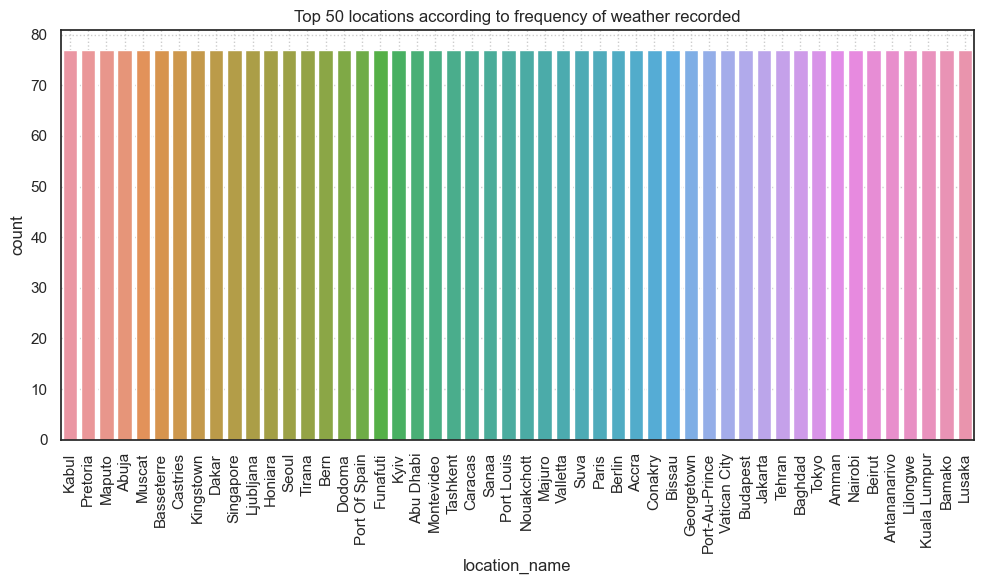

In [72]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Top_50_location_by_weather_recorded_frequency, 
              x=Top_50_location_by_weather_recorded_frequency['location_name'], 
              order=Top_50_location_by_weather_recorded_frequency['location_name'].value_counts().index, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Top 50 locations according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - All top 50 locations have the exact same number of times (77 times) the weather recorded..
## between the period - 16th May to 2nd Aug 2024.

In [ ]:
## Analysing the Least 50 locations according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [73]:
minl = df_new['location_name'].value_counts().sort_values(ascending=True).head(50)  # Extracting least 50 locations with least number of time weather recorded.
df_min_location = pd.DataFrame(minl).reset_index()                                  # Converting least 50 locations collection to new dataframe df_min_location.
list_minl = df_min_location['location_name'].to_numpy()                             # Converting location_name from df_min_location to an array using numpy and storing it in list_minl.
list_minl

array(['Istanbul', 'Pristina', 'City Of San Marino', 'Kiyabo',
       'Morocco City', 'Moldova', 'Mexico (Grupo Mexico)', 'Kuwait',
       'Ar Riyadh', 'Costa Rica', 'Beijing Shi', 'Ivory Ivory Ban',
       "Nuku'alofa", 'Lome', 'Surabaya', 'New Guatemala',
       'Krasnyy Turkmenistan', 'Melbourne', 'Bali', 'Asuncion',
       'Ho Chi Minh City', 'Male', 'Tripoli', 'Vientiane', 'New York',
       'Reykjavik', 'Grenada', 'Kingston', 'Bogota', 'Douala',
       'Phnum Penh', 'Mombasa', 'Sao Paulo', 'Saint Petersburg', 'Palau',
       'Addis Abeba', 'Carreria', "'S Gravenjansdyk", 'Washington Park',
       'Yaounde', 'Meyungs', "'S Gravenstaffel", 'San Juan', 'Pathein',
       'Bafoussam', 'Adkip', 'Rangoon', 'Pasto', 'Ban Lom', 'Felidhoo'],
      dtype=object)

In [74]:
# Creating a new dataframe for Least 50 locations according to number of times weather recorded.

Least_50_location_by_weather_recorded_frequency = df_new[df_new['location_name'].isin(list_minl)]
Least_50_location_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
31,Cameroon,Yaounde,3.87,11.52,Africa/Douala,2024-05-16 09:45:00,25.0,Partly Cloudy,2.2,55.0,...,2.0,3.0,06:01 AM,06:19 PM,01:13 PM,12:59 AM,Waxing Gibbous,55.0,2024-05-16,09:45:00
40,Costa Rica,San Juan,9.97,-84.08,America/Costa_Rica,2024-05-16 02:45:00,21.0,Fog,2.2,17.0,...,2.0,2.0,05:15 AM,05:51 PM,12:42 PM,12:37 AM,Waxing Gibbous,55.0,2024-05-16,02:45:00
104,Maldives,Felidhoo,3.48,73.53,Indian/Maldives,2024-05-16 13:45:00,29.5,Patchy rain nearby,13.4,289.0,...,1.0,1.0,05:54 AM,06:11 PM,12:58 PM,12:43 AM,Waxing Gibbous,55.0,2024-05-16,13:45:00
118,Myanmar,Pathein,16.78,94.73,Asia/Yangon,2024-05-16 15:15:00,37.5,Sunny,15.0,307.0,...,1.0,1.0,05:40 AM,06:35 PM,12:48 PM,01:02 AM,Waxing Gibbous,55.0,2024-05-16,15:15:00
132,Palau,Meyungs,7.35,134.45,Pacific/Palau,2024-05-16 17:45:00,31.0,Partly Cloudy,6.9,60.0,...,1.0,1.0,05:45 AM,06:12 PM,12:43 PM,12:37 AM,Waxing Gibbous,55.0,2024-05-16,17:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14089,Vietnam,Ban Lom,21.13,104.70,Asia/Bangkok,2024-07-28 19:45:00,25.8,Moderate or heavy rain shower,2.9,85.0,...,1.0,1.0,05:34 AM,06:42 PM,11:45 PM,12:16 PM,Last Quarter,51.0,2024-07-28,19:45:00
14283,Vietnam,Ban Lom,21.13,104.70,Asia/Bangkok,2024-07-29 19:15:00,24.9,Light rain shower,2.2,315.0,...,1.0,1.0,05:34 AM,06:41 PM,No moonrise,01:18 PM,Waning Crescent,40.0,2024-07-29,19:15:00
14478,Vietnam,Ban Lom,21.13,104.70,Asia/Bangkok,2024-07-30 19:30:00,24.4,Light rain shower,2.5,255.0,...,1.0,1.0,05:35 AM,06:41 PM,12:30 AM,02:20 PM,Waning Crescent,30.0,2024-07-30,19:30:00
14673,Vietnam,Ban Lom,21.13,104.70,Asia/Bangkok,2024-07-31 19:15:00,24.1,Light rain shower,3.1,246.0,...,1.0,1.0,05:35 AM,06:40 PM,01:20 AM,03:23 PM,Waning Crescent,20.0,2024-07-31,19:15:00


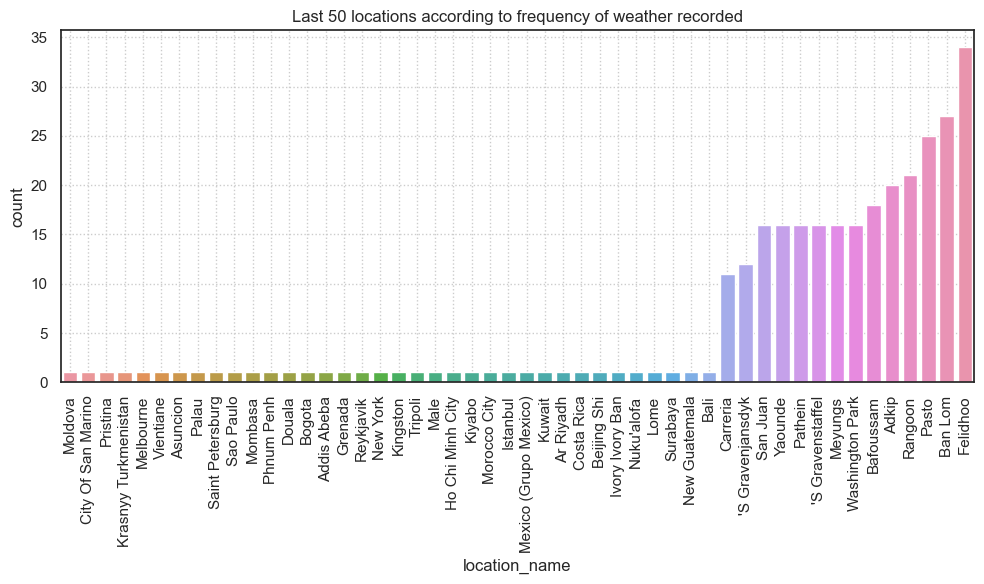

In [75]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Least_50_location_by_weather_recorded_frequency, 
              x=Least_50_location_by_weather_recorded_frequency['location_name'], 
              order=Least_50_location_by_weather_recorded_frequency['location_name'].value_counts().sort_values(ascending=True).index, ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Last 50 locations according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Moldova to Bali has negligible number of times (1 instance) the weather recorded..
## between the period - 16th May to 2nd Aug 2024.

In [76]:
# Analysing the timezone attribute

len(df_new['timezone'].unique())

# Total 190 timezones in this dataset for which weather is recorded.
# Slicing to Top 50 and Least 50 locations for bar charts/countplots as plotting 190 timezones
# in a chart will be cumbersome.

190

In [621]:
## Analysing the Top 50 timezones according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [77]:
maxt = df_new['timezone'].value_counts().head(50)  # Extracting top 50 timezones with most number of times weather recorded. 
df_max_timezone = pd.DataFrame(maxt).reset_index() # Converting top 50 timezones collection to new dataframe df_max_timezone.
list_maxt = df_max_timezone['timezone'].to_numpy() # Converting timezone from df_max_timezone to an array using numpy and storing it in list_maxt.
list_maxt

array(['Asia/Bangkok', 'Europe/Rome', 'America/La_Paz', 'Asia/Jakarta',
       'Africa/Johannesburg', 'Europe/Istanbul', 'Indian/Antananarivo',
       'Africa/Khartoum', 'Africa/Douala', 'Europe/Brussels',
       'Asia/Tehran', 'Africa/Brazzaville', 'Europe/Sofia',
       'Europe/Bucharest', 'Europe/Moscow', 'Europe/Warsaw',
       'Africa/Accra', 'Africa/Nairobi', 'Atlantic/Reykjavik',
       'Europe/Budapest', 'America/Port-au-Prince', 'America/Guyana',
       'Africa/Bissau', 'Africa/Conakry', 'Asia/Qatar',
       'Pacific/Funafuti', 'Europe/Berlin', 'Europe/Kiev', 'Asia/Dubai',
       'Europe/Paris', 'Asia/Baghdad', 'Asia/Kabul', 'America/Jamaica',
       'Asia/Tokyo', 'Africa/Maputo', 'Pacific/Auckland',
       'America/Port_of_Spain', 'Indian/Mauritius', 'Africa/Nouakchott',
       'Pacific/Majuro', 'Europe/Malta', 'Africa/Bamako', 'Africa/Lagos',
       'Asia/Kuala_Lumpur', 'Africa/Blantyre', 'Europe/Tirane',
       'Pacific/Tongatapu', 'Asia/Muscat', 'Pacific/Palau', 'Asia/Kuwa

In [78]:
# Creating a new dataframe for Top 50 timezones according to number of times weather recorded.

Top_50_timezone_by_weather_recorded_frequency = df_new[df_new['timezone'].isin(list_maxt)]
Top_50_timezone_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
0,Afghanistan,Kabul,34.52,69.18,Asia/Kabul,2024-05-16 13:15:00,26.600,Partly Cloudy,8.3,338.0,...,1.0,1.0,04:50 AM,06:50 PM,12:12 PM,01:11 AM,Waxing Gibbous,55.0,2024-05-16,13:15:00
1,Albania,Tirana,41.33,19.82,Europe/Tirane,2024-05-16 10:45:00,19.000,Partly Cloudy,6.9,320.0,...,1.0,1.0,05:21 AM,07:54 PM,12:58 PM,02:14 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
16,Belgium,Brussels,50.83,4.33,Europe/Brussels,2024-05-16 10:45:00,15.000,Partly Cloudy,3.8,240.0,...,1.0,2.0,05:52 AM,09:28 PM,01:45 PM,03:38 AM,Waxing Gibbous,55.0,2024-05-16,10:45:00
20,Bolivia,Sucre,-19.04,-65.26,America/La_Paz,2024-05-16 04:45:00,13.035,Clear,2.2,17.0,...,1.0,1.0,06:41 AM,05:53 PM,01:48 PM,12:51 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
25,Bulgaria,Sofia,42.68,23.32,Europe/Sofia,2024-05-16 11:45:00,13.035,Overcast,12.5,110.0,...,1.0,1.0,06:03 AM,08:44 PM,01:41 PM,03:02 AM,Waxing Gibbous,55.0,2024-05-16,11:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14872,Turkey,Ankara,39.93,32.86,Europe/Istanbul,2024-08-01 15:15:00,28.900,Sunny,4.0,307.0,...,1.0,1.0,05:48 AM,08:02 PM,02:11 AM,06:22 PM,Waning Crescent,12.0,2024-08-01,15:15:00
14874,Tuvalu,Funafuti,-8.52,147.19,Pacific/Funafuti,2024-08-02 00:15:00,28.400,Light rain shower,15.4,65.0,...,1.0,1.0,06:17 AM,06:02 PM,03:13 AM,03:02 PM,Waning Crescent,12.0,2024-08-02,00:15:00
14876,Ukraine,Kyiv,50.43,30.52,Europe/Kiev,2024-08-01 15:15:00,30.000,Sunny,12.8,302.0,...,1.0,1.0,05:26 AM,08:41 PM,01:24 AM,07:29 PM,Waning Crescent,12.0,2024-08-01,15:15:00
14877,United Arab Emirates,Abu Dhabi,24.47,54.37,Asia/Dubai,2024-08-01 16:15:00,35.100,Partly Cloudy,13.4,329.0,...,3.0,6.0,05:51 AM,07:06 PM,02:34 AM,05:00 PM,Waning Crescent,12.0,2024-08-01,16:15:00


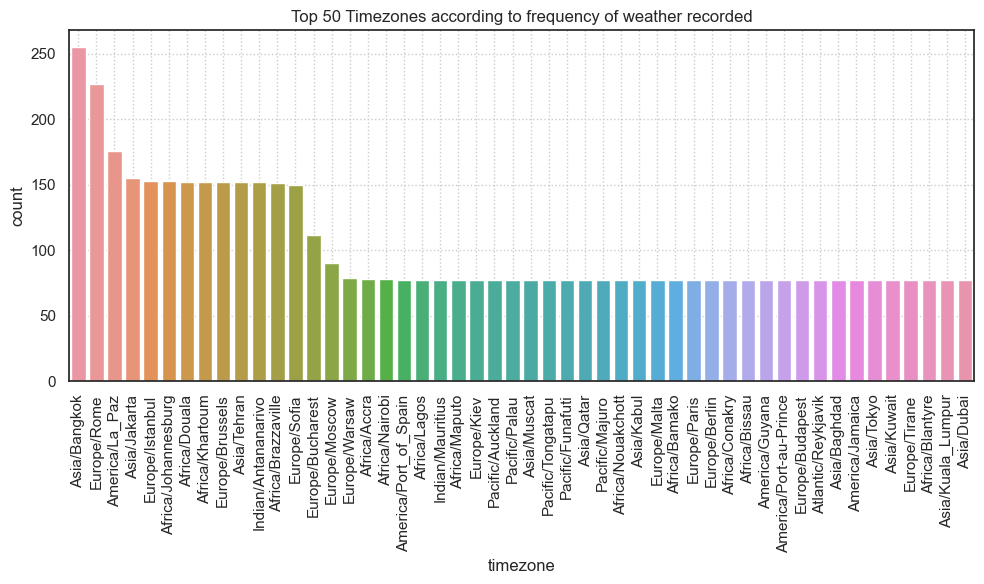

In [79]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Top_50_timezone_by_weather_recorded_frequency, 
              x=Top_50_timezone_by_weather_recorded_frequency['timezone'], 
              order=Top_50_timezone_by_weather_recorded_frequency['timezone'].value_counts().index, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Top 50 Timezones according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Asia/Bangkok timezone tops the list with 255 times the weather recorded..
## between the period - 16th May to 2nd Aug 2024.
### followed by timezones like Europe/Rome, America/La_Paz etc.
### Timezones from Europe/Warsaw till Asia/Dubai have almost same number of times weather recorded.

In [ ]:
## Analysing the Last 50 timezones according to number of times weather recorded.. 
# in the period of 78 days i.e between 16th May to 2nd Aug 2024.

In [80]:
mint = df_new['timezone'].value_counts().sort_values(ascending=True).head(50)  # Extracting least 50 timezones with least number of time weather recorded.
df_min_timezone = pd.DataFrame(mint).reset_index()                             # Converting least 50 timezones collection to new dataframe df_min_timezone.
list_mint = df_min_timezone['timezone'].to_numpy()                             # Converting timezone from df_min_timezone to an array using numpy and storing it in list_mint.
list_mint

array(['America/Hermosillo', 'America/Sao_Paulo', 'America/Denver',
       'America/Chicago', 'Asia/Kuching', 'Africa/Tripoli',
       'Asia/Ho_Chi_Minh', 'Australia/Melbourne', 'America/New_York',
       'America/Bogota', 'America/Asuncion', 'America/Argentina/Cordoba',
       'Indian/Maldives', 'Europe/Prague', 'America/Los_Angeles',
       'America/Antigua', 'Africa/Banjul', 'Africa/Freetown', 'Asia/Dili',
       'Europe/London', 'Africa/Harare', 'America/Costa_Rica',
       'Europe/Luxembourg', 'Europe/Lisbon', 'America/Nassau',
       'America/El_Salvador', 'Africa/Addis_Ababa', 'Europe/Zagreb',
       'Asia/Tbilisi', 'Europe/Athens', 'America/Grenada',
       'Pacific/Tarawa', 'Europe/Monaco', 'Europe/Skopje',
       'Africa/Djibouti', 'Europe/Bratislava', 'Asia/Jerusalem',
       'Africa/Windhoek', 'Africa/Casablanca', 'Africa/Cairo',
       'Asia/Famagusta', 'America/Dominica', 'Europe/Copenhagen',
       'Pacific/Efate', 'Indian/Comoro', 'Asia/Shanghai',
       'America/Santo_

In [81]:
# Creating a new dataframe for Last 50 timezones according to number of times weather recorded.

Least_50_timezones_by_weather_recorded_frequency = df_new[df_new['timezone'].isin(list_mint)]
Least_50_timezones_by_weather_recorded_frequency

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_us-epa-index,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time
5,Antigua and Barbuda,Saint John's,17.12,-61.8500,America/Antigua,2024-05-16 04:45:00,26.000,Partly Cloudy,5.6,90.0,...,1.0,1.0,05:36 AM,06:32 PM,01:05 PM,01:14 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
11,Bahamas,Nassau,25.08,-77.3500,America/Nassau,2024-05-16 04:45:00,27.000,Partly Cloudy,16.1,180.0,...,1.0,2.0,06:24 AM,07:48 PM,02:01 PM,02:26 AM,Waxing Gibbous,55.0,2024-05-16,04:45:00
36,China,Beijing,39.93,116.3900,Asia/Shanghai,2024-05-16 16:45:00,29.000,Sunny,9.4,180.0,...,3.0,6.0,04:58 AM,07:24 PM,12:17 PM,01:39 AM,Waxing Gibbous,55.0,2024-05-16,16:45:00
38,Comoros,Moroni,-11.70,43.2400,Indian/Comoro,2024-05-16 11:45:00,27.500,Patchy rain nearby,14.5,161.0,...,1.0,1.0,06:16 AM,05:51 PM,01:17 PM,12:31 AM,Waxing Gibbous,55.0,2024-05-16,11:45:00
40,Costa Rica,San Juan,9.97,-84.0800,America/Costa_Rica,2024-05-16 02:45:00,21.000,Fog,2.2,17.0,...,2.0,2.0,05:15 AM,05:51 PM,12:42 PM,12:37 AM,Waxing Gibbous,55.0,2024-05-16,02:45:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14867,Timor-Leste,Dili,-8.56,125.5700,Asia/Dili,2024-08-01 21:15:00,24.100,Clear,6.7,132.0,...,1.0,1.0,06:52 AM,06:36 PM,03:57 AM,03:46 PM,Waning Crescent,12.0,2024-08-01,21:15:00
14878,United Kingdom,London,51.52,-0.1100,Europe/London,2024-08-01 13:15:00,27.900,Partly Cloudy,5.1,56.0,...,1.0,1.0,05:25 AM,08:48 PM,01:22 AM,07:44 PM,Waning Crescent,12.0,2024-08-01,13:15:00
14879,United States of America,Washington Harbor,48.08,-84.1385,America/Los_Angeles,2024-08-01 05:15:00,13.035,Clear,2.9,268.0,...,1.0,1.0,05:49 AM,08:47 PM,02:17 AM,07:48 PM,Waning Crescent,12.0,2024-08-01,05:15:00
14882,Vanuatu,Port Vila,-17.73,147.1900,Pacific/Efate,2024-08-01 23:15:00,23.000,Patchy rain nearby,16.3,112.0,...,1.0,1.0,06:13 AM,05:33 PM,03:21 AM,02:25 PM,Waning Crescent,12.0,2024-08-01,23:15:00


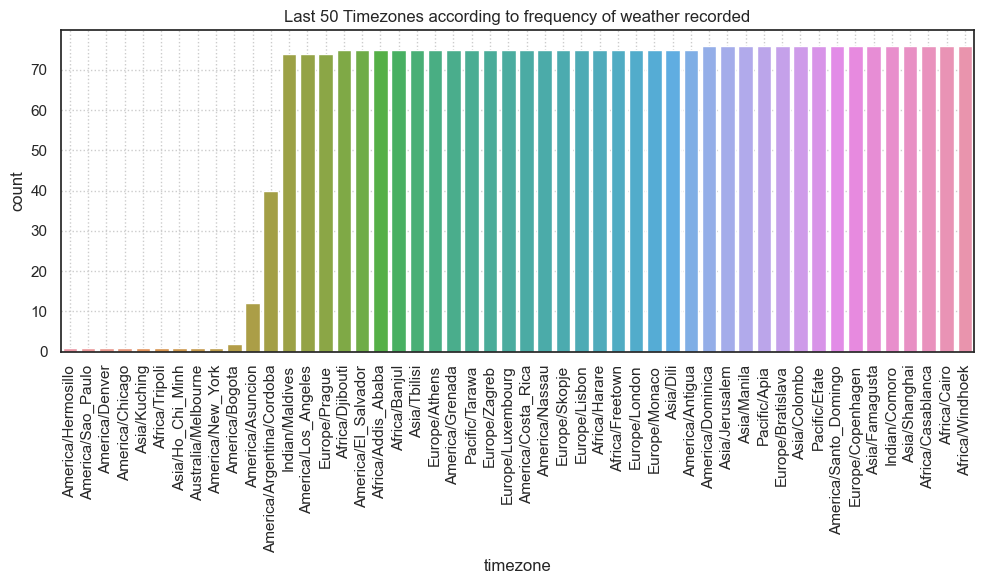

In [82]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.countplot(data = Least_50_timezones_by_weather_recorded_frequency, 
              x=Least_50_timezones_by_weather_recorded_frequency['timezone'], 
              order=Least_50_timezones_by_weather_recorded_frequency['timezone'].value_counts().sort_values(ascending=True).index, ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Last 50 Timezones according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - America/Hermosillo to America/Bogota has negligible number of times (1 or 2 instances) the weather recorded..
## between the period - 16th May to 2nd Aug 2024.

In [83]:
# Creating and Analysing a new attribute - Continent/Region

df_new[['Continent/Region','City','Extra']] = df_new['timezone'].str.split('/',expand=True)

# Extracting continent/region name from splitting timezone.

In [84]:
df_new.drop(['City','Extra'],axis=1,inplace=True)   #Dropping the unwanted created columns post splitting of timezone attribute

In [85]:
df_Continent = df_new.groupby('Continent/Region').agg({'last_updated':'count'}).sort_values(by='last_updated',ascending=False).reset_index(drop=False)

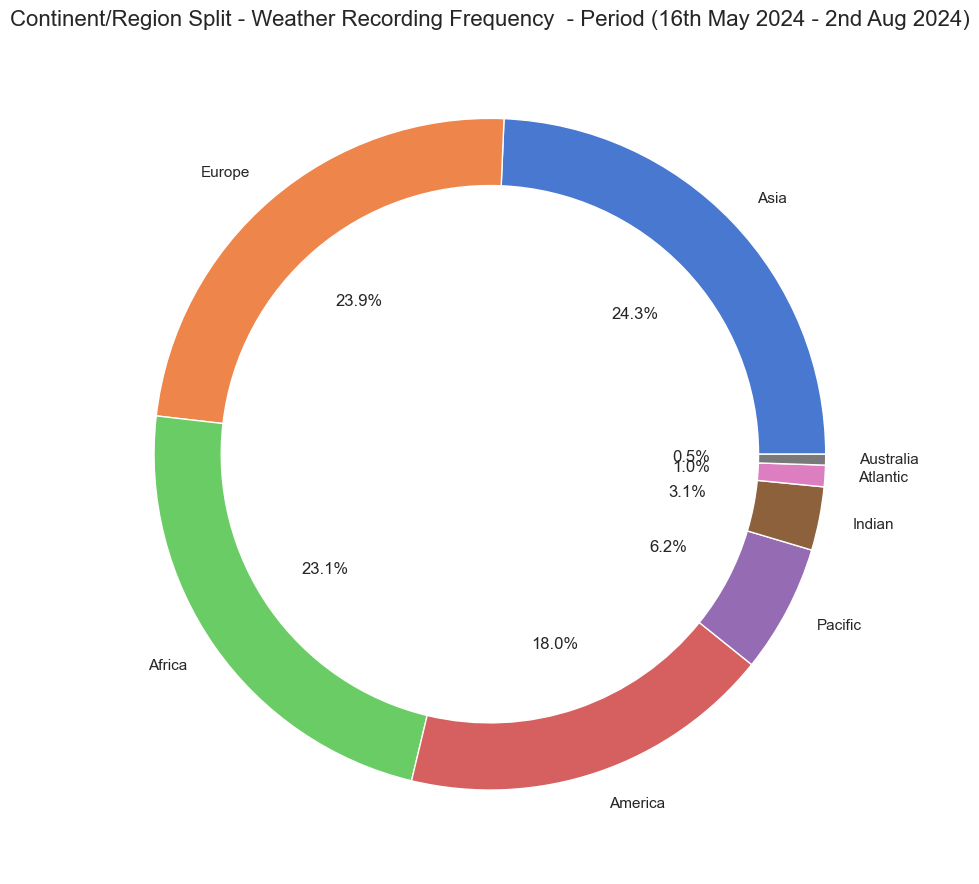

In [981]:
# Canvas
fig, ax = plt.subplots(figsize=(9, 9))

# # # Plotting
plt.pie(x=df_Continent['last_updated'],
        labels = df_Continent['Continent/Region'],
        wedgeprops=dict({'width': 0.2}),
        autopct='%.1f%%')
plt.title('Continent/Region Split - Weather Recording Frequency  - Period (16th May 2024 - 2nd Aug 2024)', fontsize=16)
plt.tight_layout()
plt.show()

# Inference - Asia contributes to most (24.3 percent) of total weather records
## followed by Europe & Africa contributing to 23 percent.
## While Australia contributes to the least (0.5%).

In [87]:
# Analysing the condition_text attribute

df_new['condition_text'].value_counts()

condition_text
Partly Cloudy                          5886
Sunny                                  4825
Patchy rain nearby                     1170
Light rain shower                       811
Clear                                   510
Overcast                                507
Mist                                    281
Moderate or heavy rain with thunder     175
Patchy light rain with thunder          167
Moderate rain                           117
Cloudy                                   98
Patchy light drizzle                     66
Fog                                      64
Light drizzle                            57
Thunder outbreaks in nearby              47
Moderate or heavy rain shower            39
Patchy light rain                        33
Moderate rain at times                   10
Patchy rain possible                      7
Heavy rain                                7
Heavy rain at times                       4
Thunder outbreaks possible                3
Torrential rain s

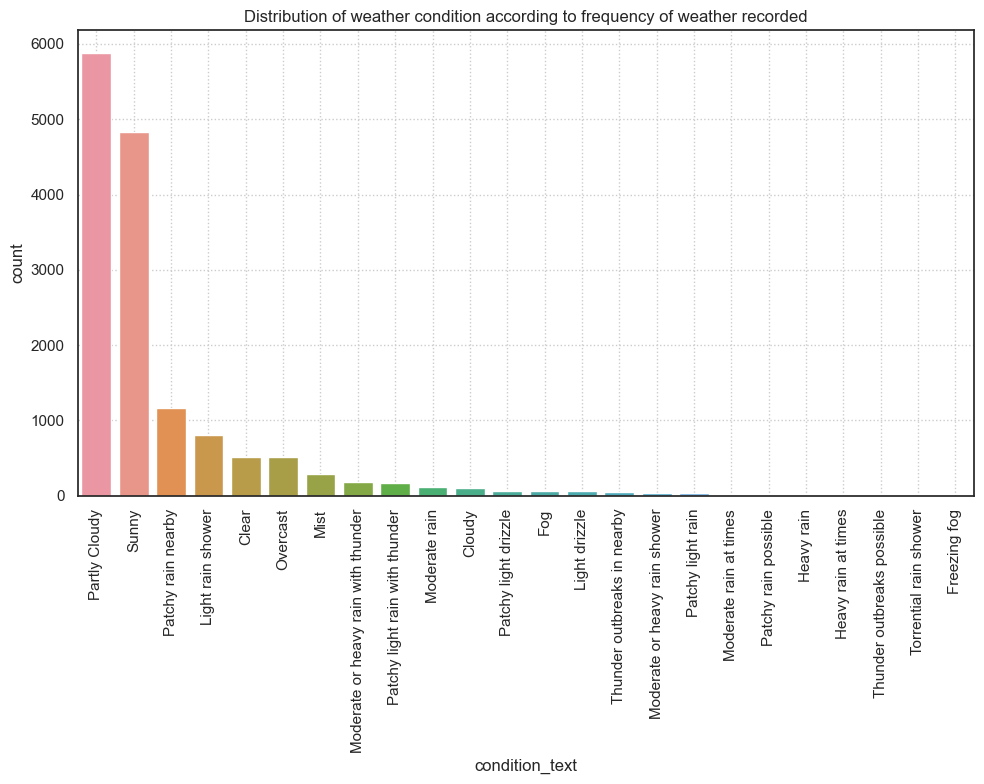

In [88]:
fig, my_ax = plt.subplots(figsize=(10,8))

sns.countplot(data = df_new, 
              x=df_new['condition_text'], 
              order=df_new['condition_text'].value_counts().index, ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Distribution of weather condition according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Most of the weather recorded between the period - 16th May to 2nd Aug 2024..
## has partly cloudy condition (5886 weather records)..
### followed by Sunny condition (4825 weather records) and patchy rain condition (1170 weather records).
# Least number of weather recorded has freezing fog weather condition.

In [89]:
# Analysing weather condition split by precentage

df_condition = df_new.groupby('condition_text').agg({'last_updated': 'count'}).sort_values(by='last_updated', ascending=False)
df_condition.reset_index(inplace=True)
df_condition

,condition_text,last_updated
0,Partly Cloudy,5886
1,Sunny,4825
2,Patchy rain nearby,1170
3,Light rain shower,811
4,Clear,510
5,Overcast,507
6,Mist,281
7,Moderate or heavy rain with thunder,175
8,Patchy light rain with thunder,167
9,Moderate rain,117


In [90]:
summation = df_condition[5:]['last_updated'].sum() 

# Summing up 'last_updated' isntances from 5th row till end. 
## This sum will be assigned to new row value - 'Others' as in the below code.

summation

1686

In [91]:
df_condition.loc[len(df_condition.index)] = ['Others', summation] # Adding a new row that has values as 'Others' and summation in condition_text and last_updated columns respectively.
df_condition

,condition_text,last_updated
0,Partly Cloudy,5886
1,Sunny,4825
2,Patchy rain nearby,1170
3,Light rain shower,811
4,Clear,510
5,Overcast,507
6,Mist,281
7,Moderate or heavy rain with thunder,175
8,Patchy light rain with thunder,167
9,Moderate rain,117


In [92]:
df_condition.drop(df_condition[5:24].index, inplace=True) # Dropping rows from 5th to 23rd index.
df_condition

,condition_text,last_updated
0,Partly Cloudy,5886
1,Sunny,4825
2,Patchy rain nearby,1170
3,Light rain shower,811
4,Clear,510
24,Others,1686


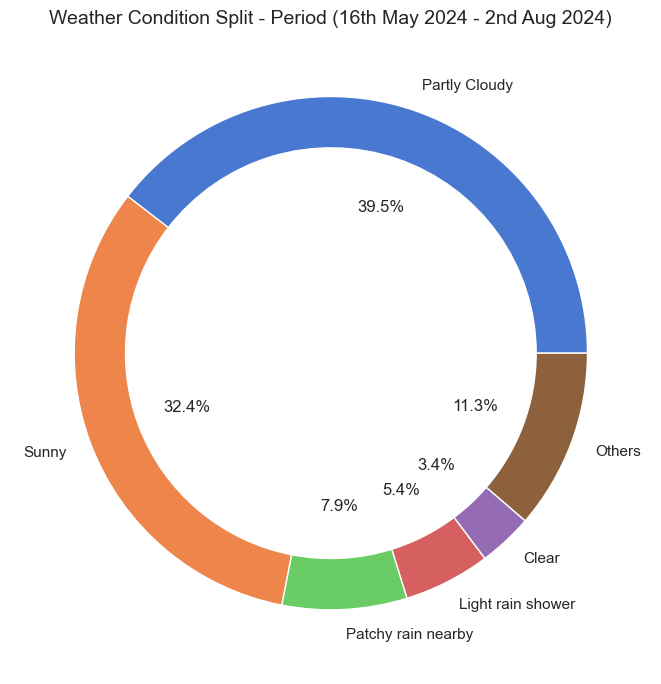

In [93]:
# Canvas
fig, ax = plt.subplots(figsize=(7, 7))

# # # Plotting
plt.pie(x=df_condition['last_updated'],
        labels = df_condition['condition_text'],
        wedgeprops=dict({'width': 0.2}),
        autopct='%.1f%%')
plt.title('Weather Condition Split - Period (16th May 2024 - 2nd Aug 2024)', fontsize=14)
plt.tight_layout()
plt.show()

# Inference - Partly Cloudy weather contributes to most (39.5 percent) of total weather records
## followed by Sunny contributing to 32.4 percent.

In [94]:
# Analysing the wind direction attribute

df_new['wind_direction'].value_counts()

wind_direction
E      1387
N      1142
W      1092
ESE    1080
S      1066
SW      982
WSW     933
SE      929
SSW     890
SSE     885
WNW     832
ENE     780
NNW     769
NW      766
NNE     718
NE      637
Name: count, dtype: int64

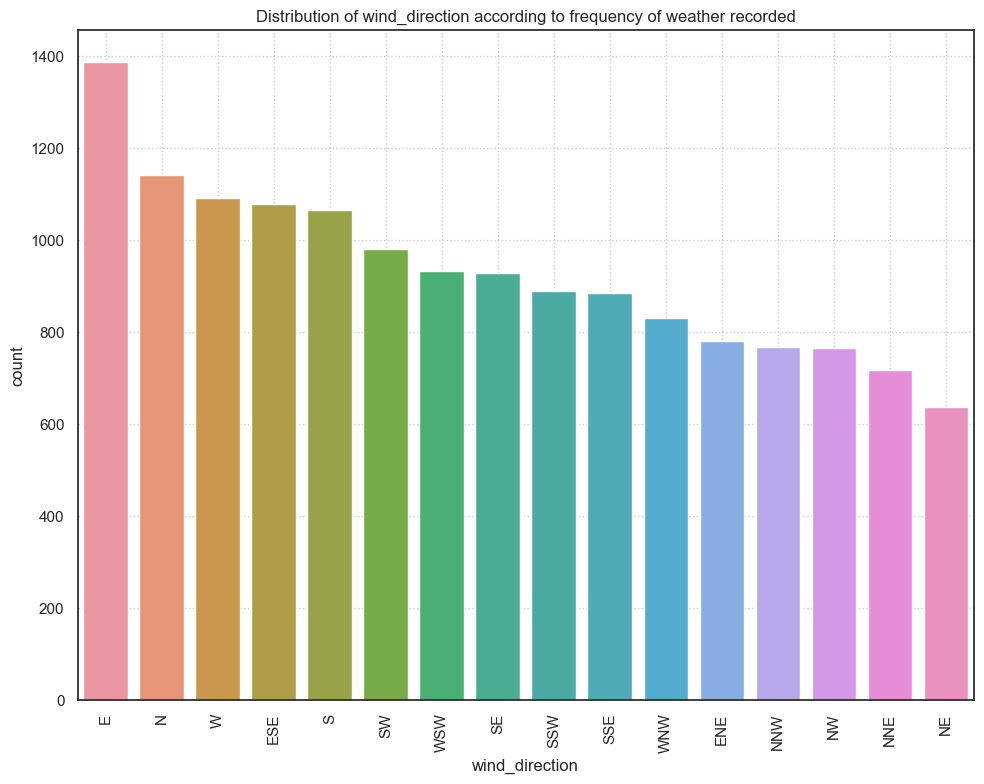

In [95]:
fig, my_ax = plt.subplots(figsize=(10,8))

sns.countplot(data = df_new, 
              x=df_new['wind_direction'], 
              order=df_new['wind_direction'].value_counts().index, ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Distribution of wind_direction according to frequency of weather recorded')
plt.tight_layout()
plt.show()

# Inference - Most of the weather recorded between the period - 16th May to 2nd Aug 2024..
## has wind direction towards East (1387 weather records)..
### followed by North (1142 weather records) and West (1092 weather records).
# Least number of weather recorded for wind direction towards North East (637 weather records) .

In [191]:
# Analysing the moon phase attribute

df_new['moon_phase'].value_counts()

moon_phase
Waxing Gibbous     4074
Waning Crescent    3119
Waning Gibbous     3077
Waxing Crescent    2728
Last Quarter        584
Full Moon           577
New Moon            388
First Quarter       341
Name: count, dtype: int64

In [102]:
df_moon = df_new.groupby('moon_phase').agg({'last_updated':'count'}).reset_index()
df_moon

,moon_phase,last_updated
0,First Quarter,341
1,Full Moon,577
2,Last Quarter,584
3,New Moon,388
4,Waning Crescent,3119
5,Waning Gibbous,3077
6,Waxing Crescent,2728
7,Waxing Gibbous,4074


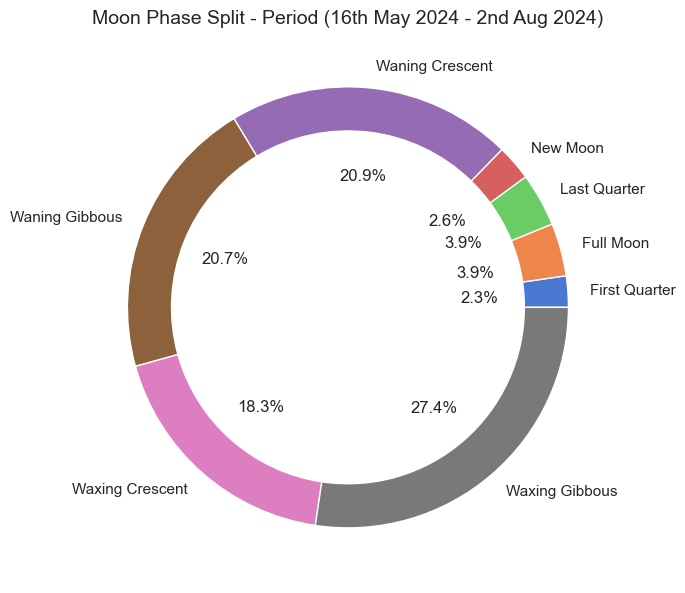

In [103]:
# Canvas
fig, ax = plt.subplots(figsize=(7, 7))

# # # Plotting
plt.pie(x=df_moon['last_updated'],
        labels = df_moon['moon_phase'],
        wedgeprops=dict({'width': 0.2}),
        autopct='%.1f%%')
plt.title('Moon Phase Split - Period (16th May 2024 - 2nd Aug 2024)', fontsize=14)
plt.tight_layout()
plt.show()

# Inference - Waxing Gibbous moon condition contributes to most (27.4 percent) of total weather records
## followed by Waning Gibbous contributing to 20.7 percent.
## First Quarter contributes to least (2.3 percent) of total weather records.

In [720]:
##----------------------------END OF SECTION - Univariate Analysis of Dimensions---------------------------##

<a id = Section6.4></a>

### **6.4. BIVARIATE ANALYSIS**

<a id = Section6.4.1></a>

##### **6.4.1** BIVARIATE ANALYSIS BETWEEN METRICS

In [104]:
column = df_new.select_dtypes(include=['int','float'])
column

# The column dataset has 22 metrices columns which is quite cumbersome to plot in a pairplot.
## Hence, creating 3 sub dataframes below - df1, df2, df3 based on column slicing and thus creating 3 seperate pairplots.

,latitude,longitude,temperature_celsius,wind_mph,wind_degree,pressure_mb,precip_mm,humidity,cloud,feels_like_celsius,...,gust_mph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
0,34.52,69.18,26.600,8.3,338.0,1012.0,0.0,24.0,30.00,25.3,...,9.5,277.0,103.0,1.100,0.2,8.4,26.6,1.0,1.0,55.0
1,41.33,19.82,19.000,6.9,320.0,1012.0,0.1,94.0,75.00,19.0,...,11.4,193.6,97.3,0.900,0.1,1.1,2.0,1.0,1.0,55.0
2,36.76,3.05,23.000,9.4,280.0,1011.0,0.0,29.0,0.00,24.6,...,13.9,540.7,12.2,49.155,13.4,10.4,18.4,1.0,1.0,55.0
3,42.50,1.52,13.035,7.4,215.0,1007.0,0.3,61.0,94.65,12.5,...,8.5,170.2,64.4,1.600,0.2,0.7,1.0,1.0,1.0,55.0
4,-8.84,13.23,26.000,8.1,150.0,1011.0,0.0,89.0,50.00,28.7,...,12.5,1281.7,19.0,49.155,31.5,50.2,113.2,3.0,6.0,55.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14883,10.50,-66.92,21.500,4.5,165.0,1017.0,0.0,80.0,6.00,21.5,...,6.4,567.4,3.5,10.900,15.5,5.3,6.4,1.0,1.0,12.0
14884,21.03,105.85,26.900,6.7,196.0,1003.0,0.0,84.0,53.00,30.5,...,11.2,1041.4,9.6,49.155,32.4,25.7,34.9,2.0,3.0,12.0
14885,15.35,44.21,23.200,6.7,269.0,1010.0,0.1,44.0,84.00,24.6,...,7.7,237.0,65.8,1.700,3.5,12.6,35.8,1.0,2.0,12.0
14886,-15.42,28.28,26.600,11.6,82.0,1018.0,0.0,15.0,0.00,24.9,...,13.4,594.1,81.5,1.300,2.3,10.9,15.4,1.0,1.0,12.0


In [105]:
df1 = column.iloc[:,0:8]
df1

,latitude,longitude,temperature_celsius,wind_mph,wind_degree,pressure_mb,precip_mm,humidity
0,34.52,69.18,26.600,8.3,338.0,1012.0,0.0,24.0
1,41.33,19.82,19.000,6.9,320.0,1012.0,0.1,94.0
2,36.76,3.05,23.000,9.4,280.0,1011.0,0.0,29.0
3,42.50,1.52,13.035,7.4,215.0,1007.0,0.3,61.0
4,-8.84,13.23,26.000,8.1,150.0,1011.0,0.0,89.0
...,...,...,...,...,...,...,...,...
14883,10.50,-66.92,21.500,4.5,165.0,1017.0,0.0,80.0
14884,21.03,105.85,26.900,6.7,196.0,1003.0,0.0,84.0
14885,15.35,44.21,23.200,6.7,269.0,1010.0,0.1,44.0
14886,-15.42,28.28,26.600,11.6,82.0,1018.0,0.0,15.0


In [106]:
df2 = column.iloc[:,8:16]
df2

,cloud,feels_like_celsius,visibility_km,uv_index,gust_mph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide
0,30.00,25.3,10.0,7.0,9.5,277.0,103.0,1.100
1,75.00,19.0,10.0,5.0,11.4,193.6,97.3,0.900
2,0.00,24.6,10.0,5.0,13.9,540.7,12.2,49.155
3,94.65,12.5,6.0,2.0,8.5,170.2,64.4,1.600
4,50.00,28.7,10.0,8.0,12.5,1281.7,19.0,49.155
...,...,...,...,...,...,...,...,...
14883,6.00,21.5,10.0,6.0,6.4,567.4,3.5,10.900
14884,53.00,30.5,10.0,1.0,11.2,1041.4,9.6,49.155
14885,84.00,24.6,10.0,5.0,7.7,237.0,65.8,1.700
14886,0.00,24.9,10.0,8.0,13.4,594.1,81.5,1.300


In [107]:
df3 = column.iloc[:,16:]
df3

,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
0,0.2,8.4,26.6,1.0,1.0,55.0
1,0.1,1.1,2.0,1.0,1.0,55.0
2,13.4,10.4,18.4,1.0,1.0,55.0
3,0.2,0.7,1.0,1.0,1.0,55.0
4,31.5,50.2,113.2,3.0,6.0,55.0
...,...,...,...,...,...,...
14883,15.5,5.3,6.4,1.0,1.0,12.0
14884,32.4,25.7,34.9,2.0,3.0,12.0
14885,3.5,12.6,35.8,1.0,2.0,12.0
14886,2.3,10.9,15.4,1.0,1.0,12.0


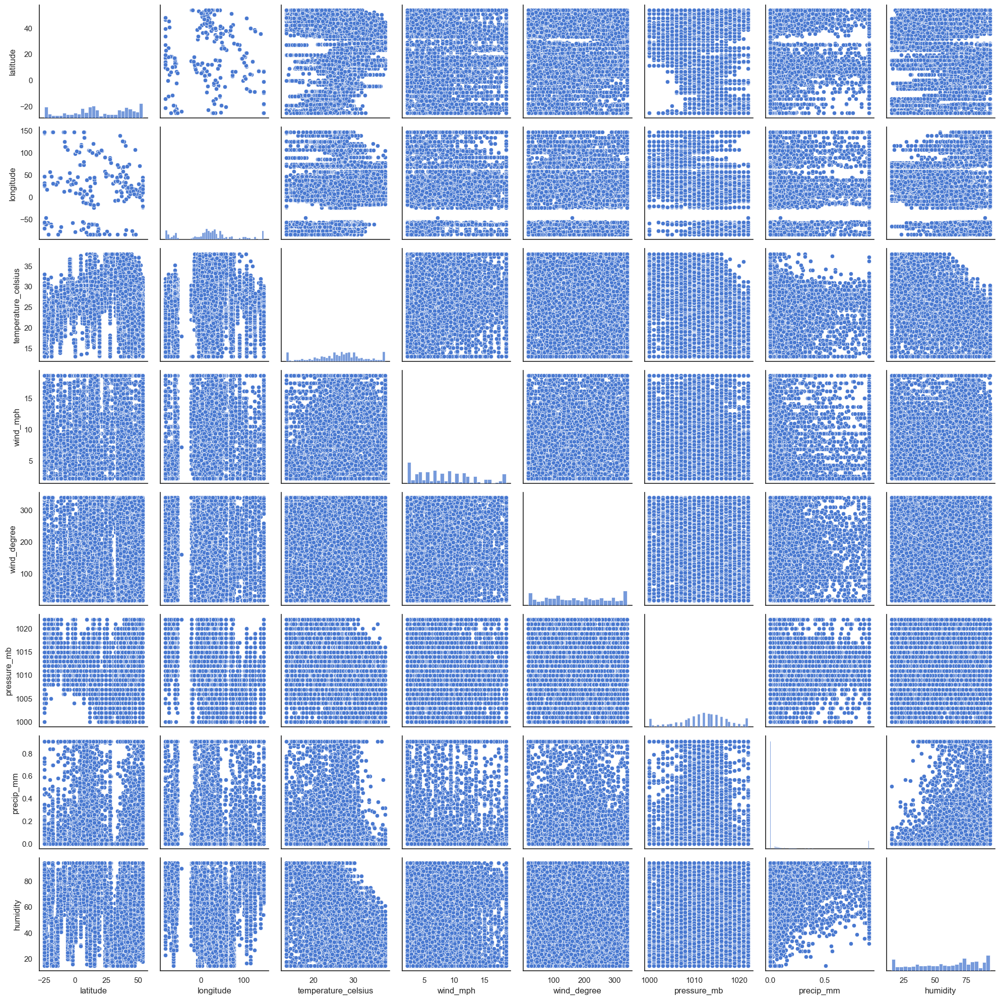

In [108]:
# Pairplot for df1

sns.pairplot(data = df1)

plt.tight_layout()
plt.show()

# Potential Correlations:
# 1. latitude vs temperature
# 2. temperature vs pressure (mb)
    

In [109]:
# Correlation matrix for df1

corr1 = df1.corr()     
corr1

,latitude,longitude,temperature_celsius,wind_mph,wind_degree,pressure_mb,precip_mm,humidity
latitude,1.000000,-0.016032,0.086794,0.138930,0.197108,-0.277364,-0.002335,-0.214263
longitude,-0.016032,1.000000,0.113255,-0.007069,0.028165,-0.369026,0.059272,-0.063759
temperature_celsius,0.086794,0.113255,1.000000,0.131051,0.027737,-0.471061,-0.121946,-0.453765
wind_mph,0.138930,-0.007069,0.131051,1.000000,0.111335,-0.116806,-0.082826,-0.168043
wind_degree,0.197108,0.028165,0.027737,0.111335,1.000000,-0.132050,-0.017234,-0.133058
pressure_mb,-0.277364,-0.369026,-0.471061,-0.116806,-0.132050,1.000000,-0.064704,0.122658
precip_mm,-0.002335,0.059272,-0.121946,-0.082826,-0.017234,-0.064704,1.000000,0.340904
humidity,-0.214263,-0.063759,-0.453765,-0.168043,-0.133058,0.122658,0.340904,1.000000


<Axes: >

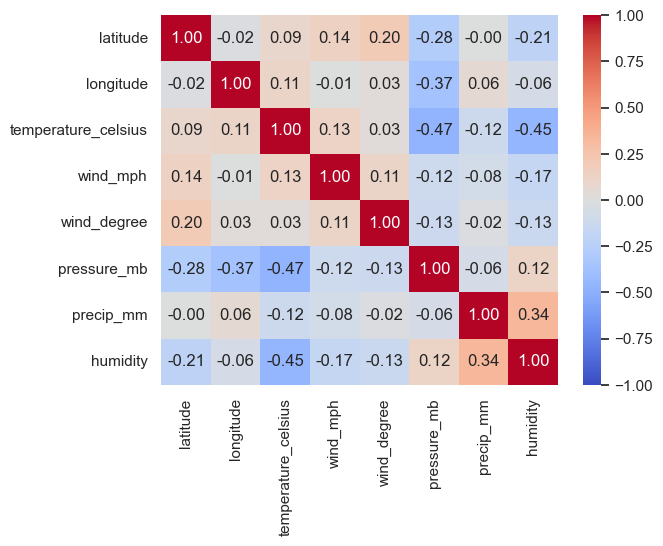

In [110]:
# Heatmap for df1

sns.heatmap(corr1, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)

# Inference:

# Latitude has 9 percent correlation with temperature.
# Latitude has 14 percent correlation with wind speed.
# Latitude has 20 percent correlation with wind direction.
# Latitude has 28 percent negative correlation with pressure.
# Latitude has 21 percent negative correlation with humidity.
# Longitude has 11 percent correlation with temperature
# Longitude has 37 percent negative correlation with pressure.
# Temperature has 13 percent correlation with windspeed. 
# Temperature has 47 percent negative correlation with windspeed. 
# Windspeed has 11 percent correlation with wind direction.
# Windspeed has 12 percent negative correlation with wind pressure.

<Axes: >

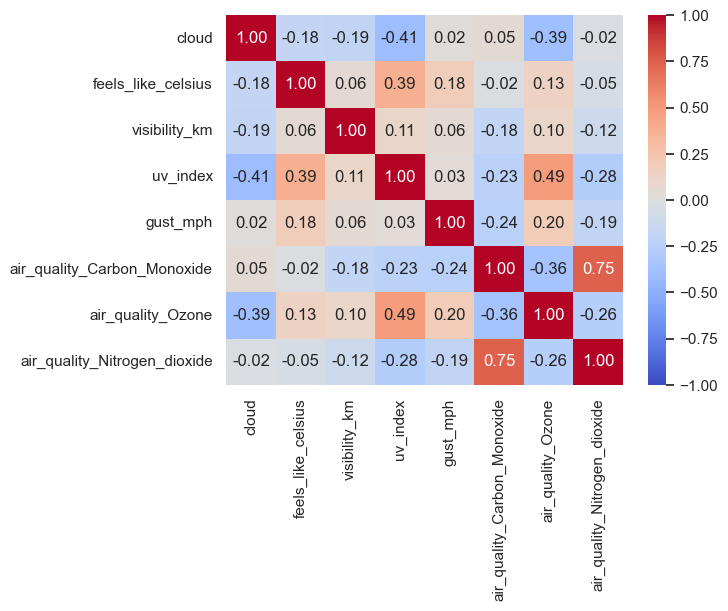

In [1122]:
sns.heatmap(corr2, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)

In [111]:
df_latitude_mean_temp = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'temperature_celsius':'mean'}).sort_values(by='temperature_celsius', ascending=False)

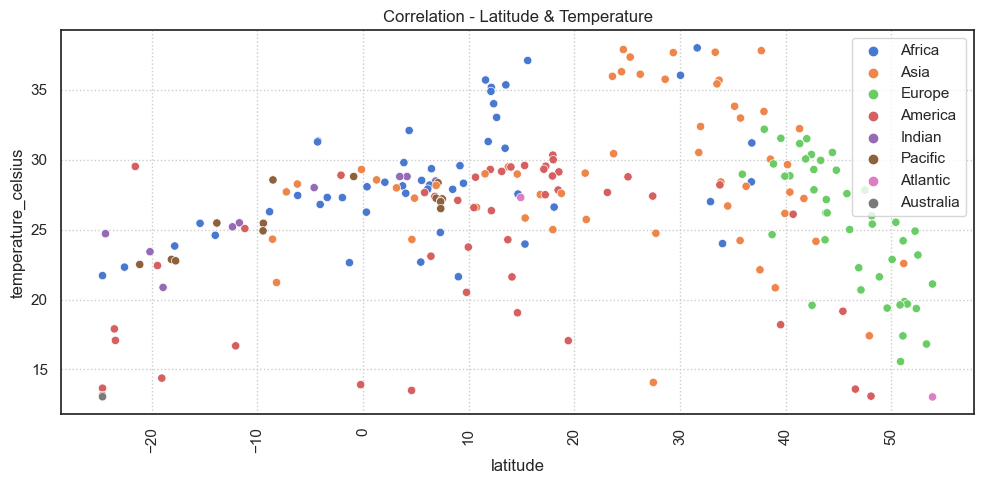

In [112]:
# Analysing Correlation between Latitude & Temperature

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_latitude_mean_temp, y='temperature_celsius', x='latitude',hue='Continent/Region', ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Temperature')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show() 

# Inference:

# Asia, Africa and some parts of Europe have highest average temperature - 37 - 38 degree celsius
# Atlantic, Northern Europe (North Pole) and Australia, Southern America and Pacific touching lowest average temperature - 13 degree celsius

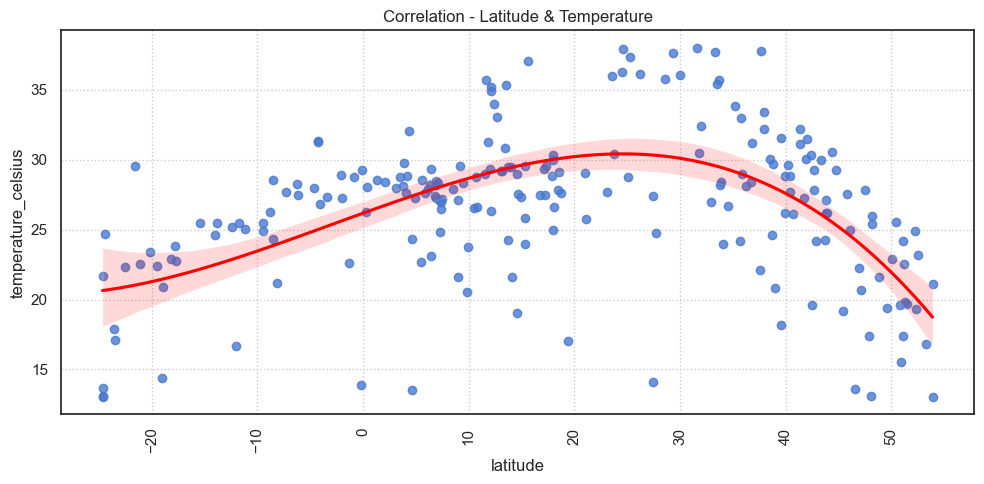

In [113]:
# Analysing Correlation between Latitude & Temperature

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_latitude_mean_temp, y='temperature_celsius', x='latitude', order=3,
            scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Temperature')

plt.tight_layout()
plt.show() 

# Inference:

# Average temperature overall shares a linear polynomical equation with latitude.
# Average Temperature increases linearly for every increase in latitude till around 35 degree North Latitude, post which temperature decrease with increase in latitude as we approach towards North pole.
# Average Temperature is fairly hot near equator (between 25 to 35 degree North) while it’ low near the North pole (35 to 53 degree North) and South pole (-24 to -10 degree South)

In [117]:
df_latitude_mean_pressure = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'pressure_mb':'mean'}).sort_values(by='pressure_mb', ascending=False)

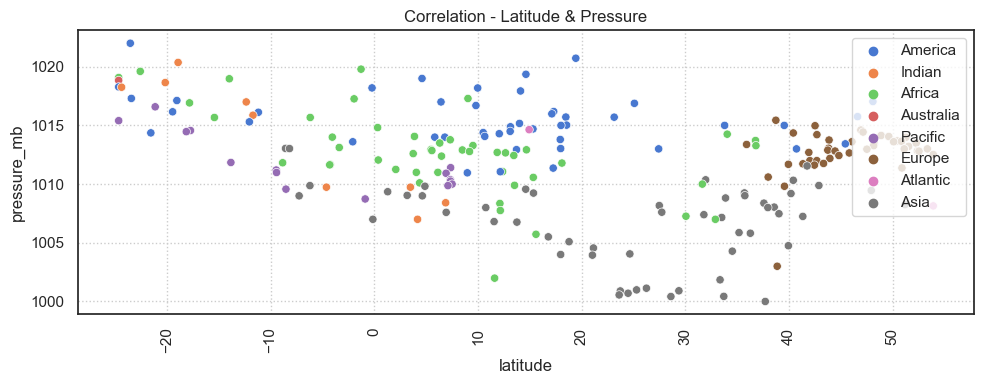

In [118]:
# Analysing Correlation between Latitude & Pressure 

fig, my_ax = plt.subplots(figsize=(10,4))

sns.scatterplot(data = df_latitude_mean_pressure, y='pressure_mb', x='latitude',hue='Continent/Region',ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Pressure')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# South America, Indian , Southern Africa and Australia (South pole) have highest average pressure - 1018 - 1022 milibars.
# North America, Northern Europe, Atlantic and North Africa (North Pole) have highest average pressure - max. 1017 milibars.
# Asia, Southern Europe (near Equator) have lowest average pressure - 1000 - 1008 milibars

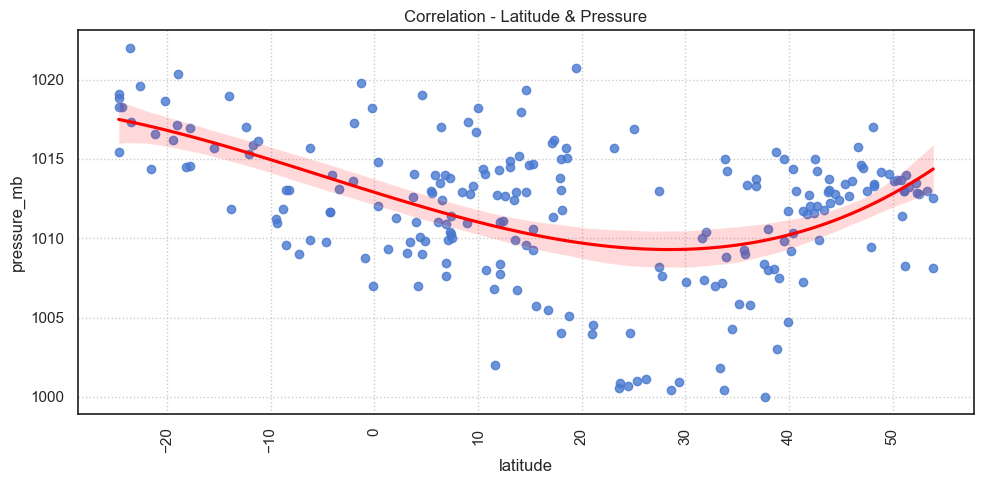

In [119]:
# Analysing Correlation between Latitude & Pressure 

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_latitude_mean_pressure, y='pressure_mb', x='latitude', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Pressure')

plt.tight_layout()
plt.show()   

# Inference:

# Average Pressure shares a reverse linear polynomial equation with latitude.
# Average Pressure decreases linearly for every increase in latitude till around 38 degree North Latitude, post which pressure increase with increase in latitude as we approach towards North pole.
# Average Pressure is less near equator (between 0.14 to 38 degree North) while it’ high near the North pole (38 to 53 degree North) and South pole (-25 to -11 degree South)

In [120]:
df_latitude_mean_humidity = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'humidity':'mean'}).sort_values(by='humidity', ascending=False)

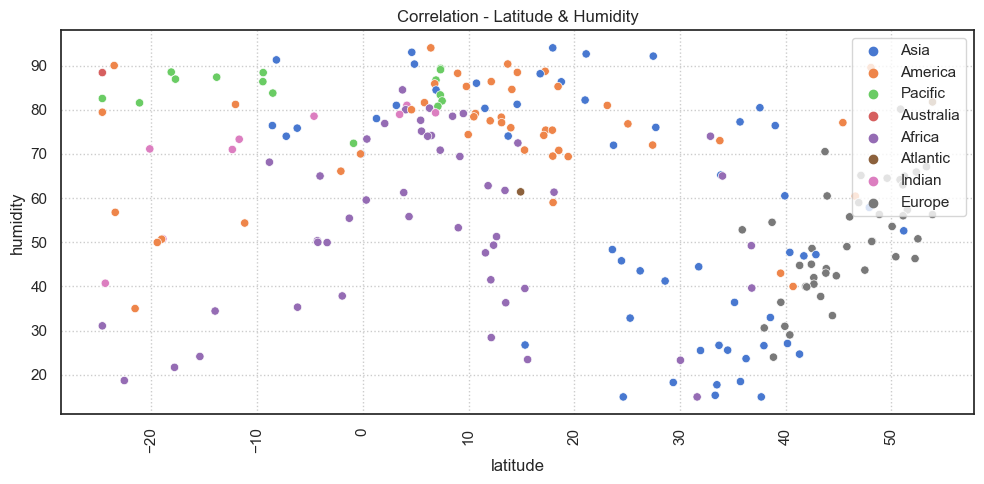

In [121]:
# Analysing Correlation between Latitude & Humidity

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_latitude_mean_humidity, y='humidity', x='latitude',hue='Continent/Region',ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Humidity')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# Southern parts of Asia,  America ,  some regions in Africa have 85 - 95  percentage average humidity.
# Europe, Northern Asia and Northern America have average humidity between 35 - 75 percentage.
# Pacific, despite being near south pole has high average humidity percentage (85 - 90 percent).
# It implies humidity is affected by other climatic factors too than latitudes.

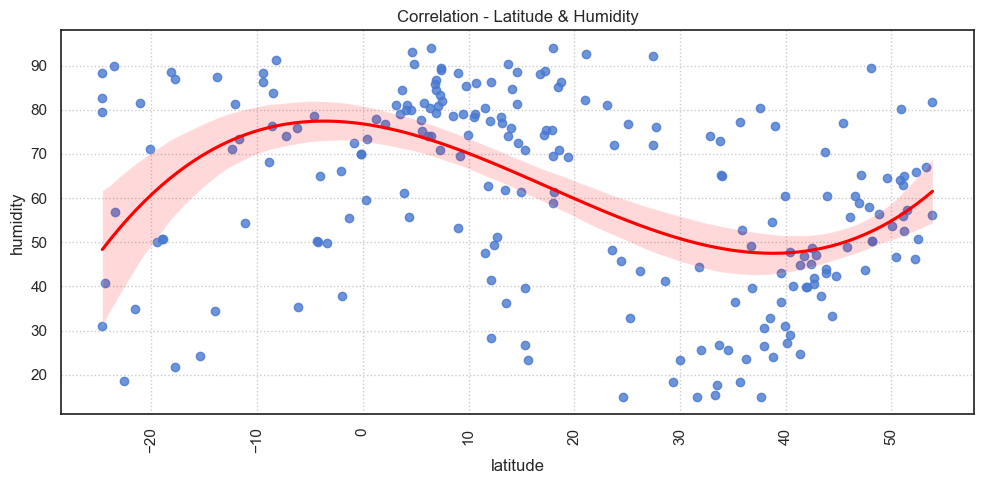

In [122]:
# Analysing Correlation between Latitude & Humidity 

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_latitude_mean_humidity, y='humidity', x='latitude', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Humidity')

plt.tight_layout()
plt.show()   

# Inference:

# Average Humidity shares a reverse linear polynomial equation with latitude.
# Average humidity is highly concentrated at 85 - 95 humidity percentage between 10 to 30 degree North Latitude (Near Equator).
# Average humidty is less as concentrated at 35 - 75 humidity percentage near North pole (between 45 to 53 degree North).
# Average humidity in southern hemisphere near south ploes (-10 to -30 degree south).. 
## is scattered between lowest to highest humidity (20 to 94 humidity percentage).
# It implies humidty is affected by other climatic factors too than latitudes.

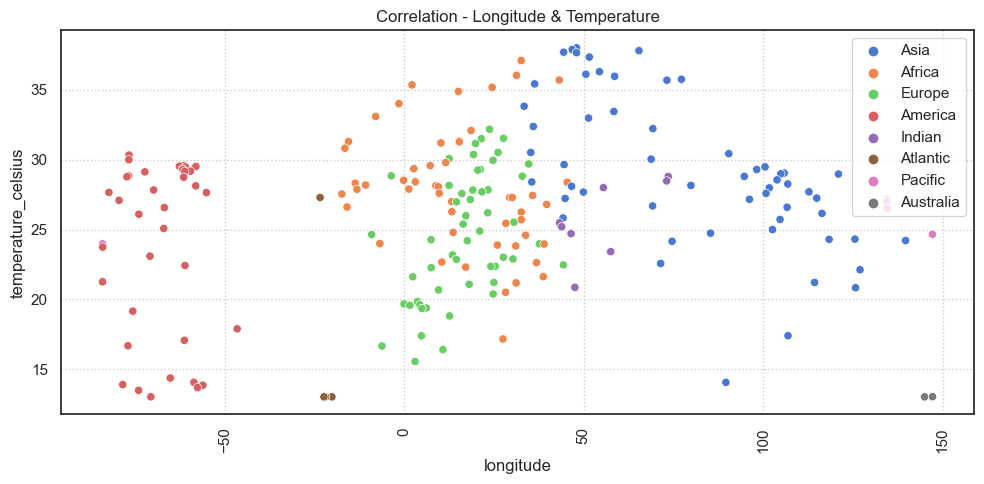

In [123]:
# Analysing Correlation between Longitude & Temperature 

df_longitude_mean_temp = df_new.groupby(['longitude','Continent/Region'],as_index=False).agg({'temperature_celsius':'mean'}).sort_values(by='temperature_celsius', ascending=False)

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_longitude_mean_temp, y='temperature_celsius', x='longitude',hue='Continent/Region',ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Longitude & Temperature')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# Southern parts of Asia,  America ,  some regions in Africa have 85 - 95  percentage average humidity.
# Europe, Northern Asia and Northern America have average humidity between 35 - 75 percentage.
# Pacific, despite being near south pole has high average humidity percentage (85 - 90 percent).
# It implies humidity is affected by other climatic factors too than latitudes.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


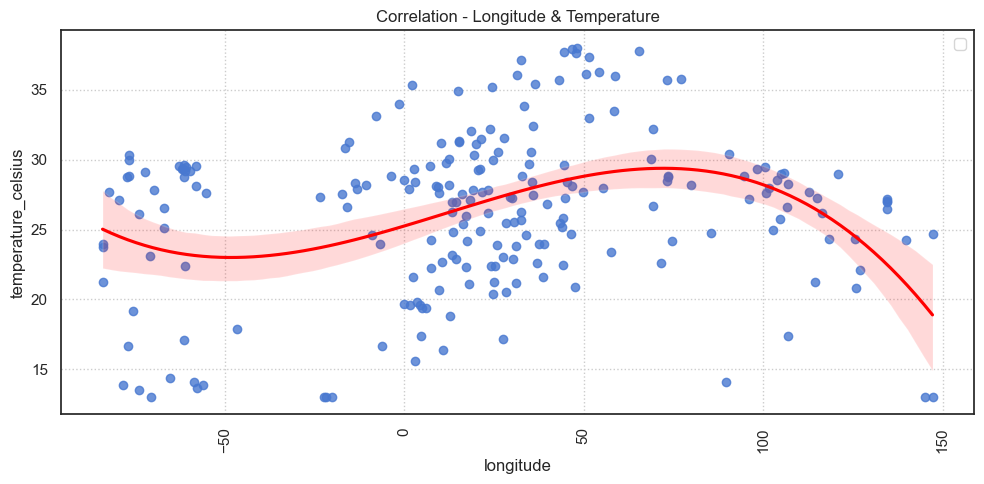

In [124]:
# Analysing Correlation between Longitude & Temperature

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_longitude_mean_temp, y='temperature_celsius', x='longitude', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Longitude & Temperature')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()   

# Inference:

# Average temperature shares a  linear polynomial equation with longitude.
# Average Temperature increases  with longitude from West to East till around 80 degree East Longitude, post which temperature decrease with increase in longitude till 150 degree East.
# Average Temperature near prime meridian (-25 degree west to 80 degree East) is fairly hot(as high as 38 degree celsius) while it’ low (13 to 30 degree celsius) 
# near the farthest East (Past 80 degree East) and 13 to 30 degree celsius near the farthest West (West of -50 degree).
# There are countries in Europe, Atlantic etc. which are located near prime meridian  (-25 degree west to 80 degree East) 
# which have very low temperatures, for eg:- Iceland. This is because their presence in either near North pole or South pole. 
# Hence, temperature is affected by both latitude and longitude.

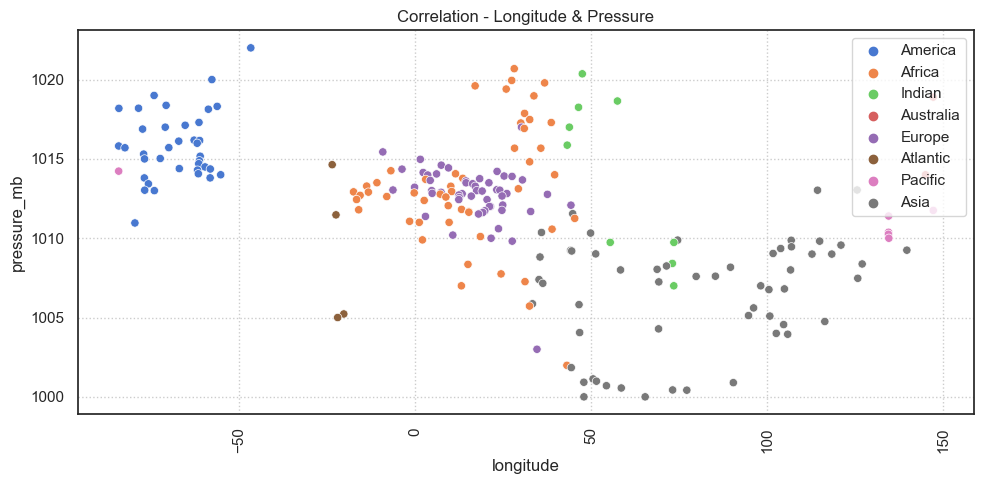

In [125]:
# Analysing Correlation between Longitude & Pressure 

df_longitude_mean_pressure = df_new.groupby(['longitude','Continent/Region'],as_index=False).agg({'pressure_mb':'mean'}).sort_values(by='pressure_mb', ascending=False)

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_longitude_mean_pressure, y='pressure_mb', x='longitude',hue='Continent/Region',ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Longitude & Pressure')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# Southern parts of Asia, America, some regions in Africa have 1010-1020 mb average pressure.
# Asia and Southern Africa  have average pressure as low as 1000 mb.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


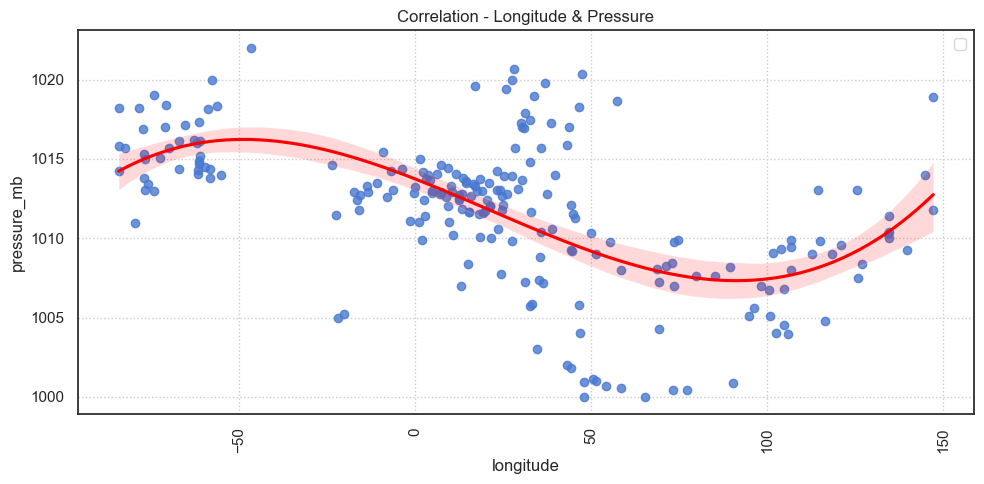

In [126]:
# Analysing Correlation between Longitude & Pressure

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_longitude_mean_pressure, y='pressure_mb', x='longitude', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Longitude & Pressure')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()   

# Inference:

# Average Pressure shares a  reverse linear polynomial equation with longitude.
# Average Pressure decreases  with longitude from West to East till around 100 degree East Longitude, 
# post which pressure increases with increase in longitude till 150 degree East.
# Average Pressure near prime meridian (-25 degree west to 80 degree East) is fairly low (as low as 1000 mb) 
# while it’ high (1010 to 1020 mb) near the farthest East (Past 80 degree East) and 1010 to 1020 mb near the farthest West (West of -50 degree).
# There are countries in Europe, Atlantic etc. which are located near prime meridian  (-25 degree west to 80 degree East) 
# which have very high pressures, for eg:- Iceland. 
# This is because their presence in either near North pole or South pole and other environmental factors. 
# Hence, pressure is affected by both latitude and longitude.

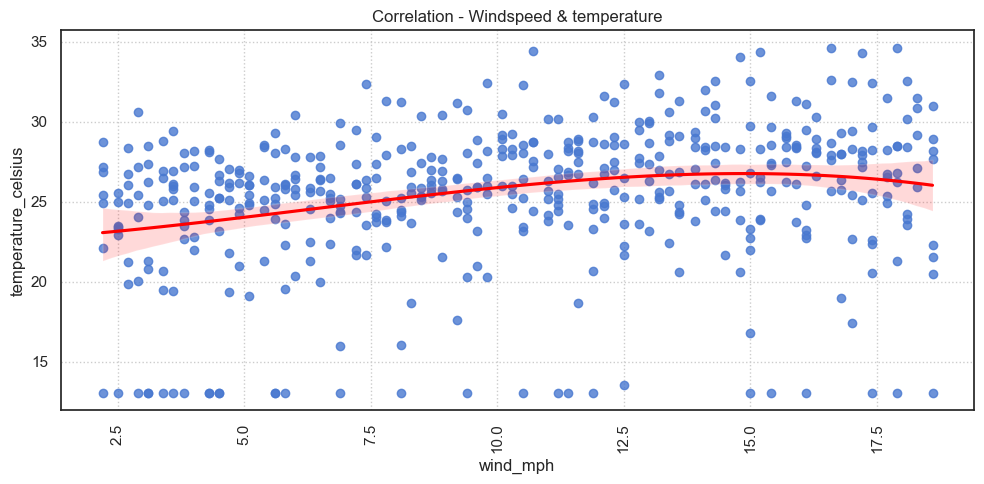

In [128]:
# Analysing Correlation between Windspeed & Temperature

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_windspeed_mean_temp, x='wind_mph', y='temperature_celsius', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Windspeed & temperature')

plt.tight_layout()
plt.show()   

# Inference:

# Average wind speed slightly increases with temperature increase.
# High temperature regions have high wind speed.
# This hypothesis not always hold true as countries near North pole have high winds despite low temperatures.
# Hence, there are other climatic conditions which largely impacts wind speed.

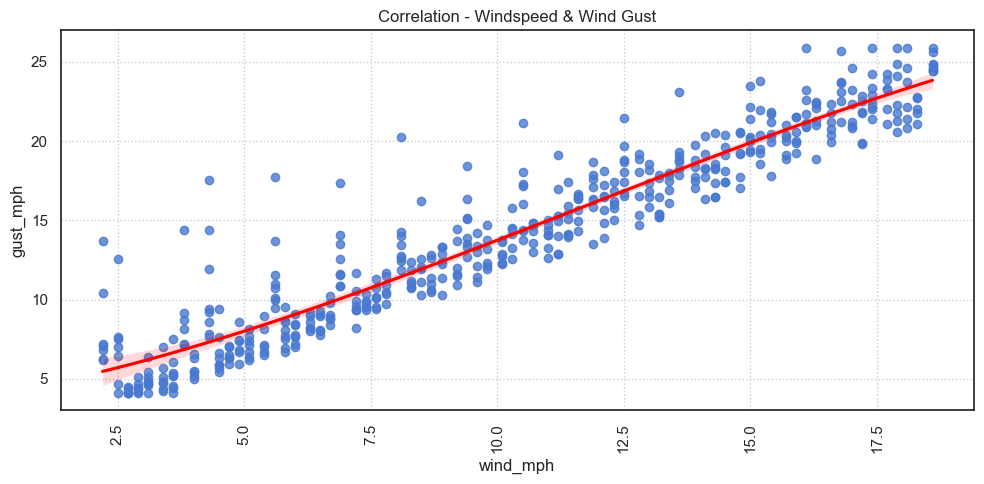

In [1124]:
# Analysing Correlation between Windspeed & Wind Direction

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_windspeed_mean_gust, x='wind_mph', y='gust_mph', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Windspeed & Wind Gust')

plt.tight_layout()
plt.show()   

# Inference:

# Average wind gust increases linearly with increase in wind speed.

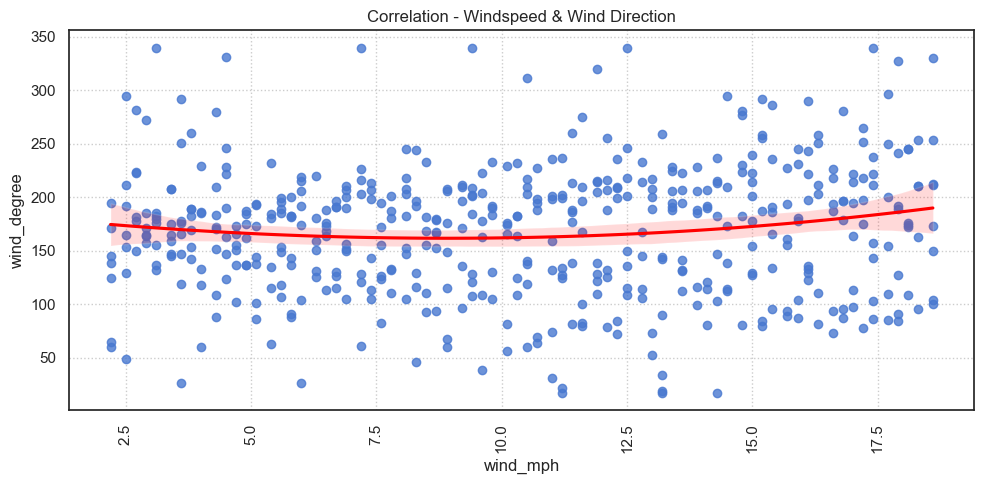

In [130]:
# Analysing Correlation between Windspeed & Wind Direction

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_windspeed_mean_wind_degree, x='wind_mph', y='wind_degree', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Windspeed & Wind Direction')

plt.tight_layout()
plt.show()   

# Inference:
# There's not much direct correlation between wind direction and average wind speed.

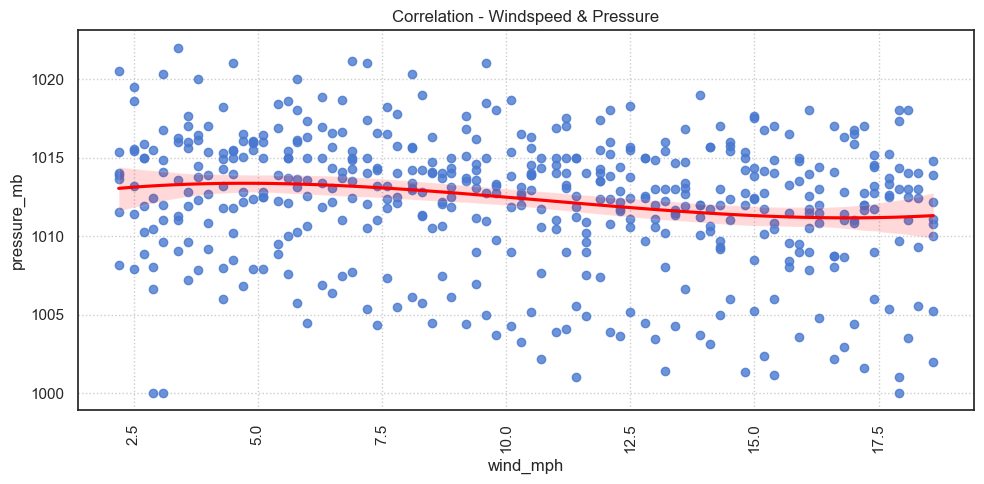

In [132]:
# Analysing Correlation between Windspeed & Pressure

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_windspeed_mean_pressure, x='wind_mph', y='pressure_mb', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Windspeed & Pressure')

plt.tight_layout()
plt.show()   

# Inference:

# Average pressure slightly decreases with  increase in wind speed.

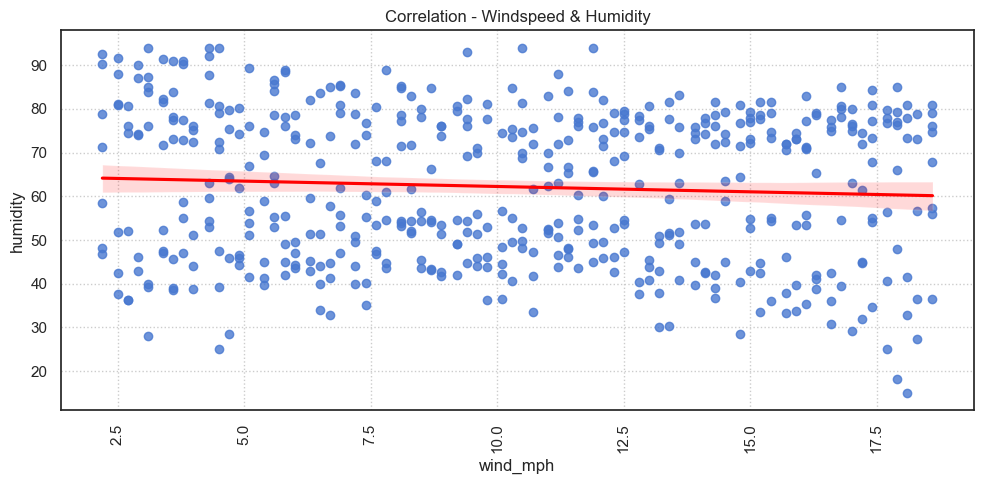

In [1129]:
# Analysing Correlation between Windspeed & Humidity

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_windspeed_mean_humidity, x='wind_mph', y='humidity', 
            scatter=True, order=1, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Windspeed & Humidity')

plt.tight_layout()
plt.show()   

# Inference:

# Average wind speed slightly decreases with  increase in humidity and doesn't hold a strong correlation.

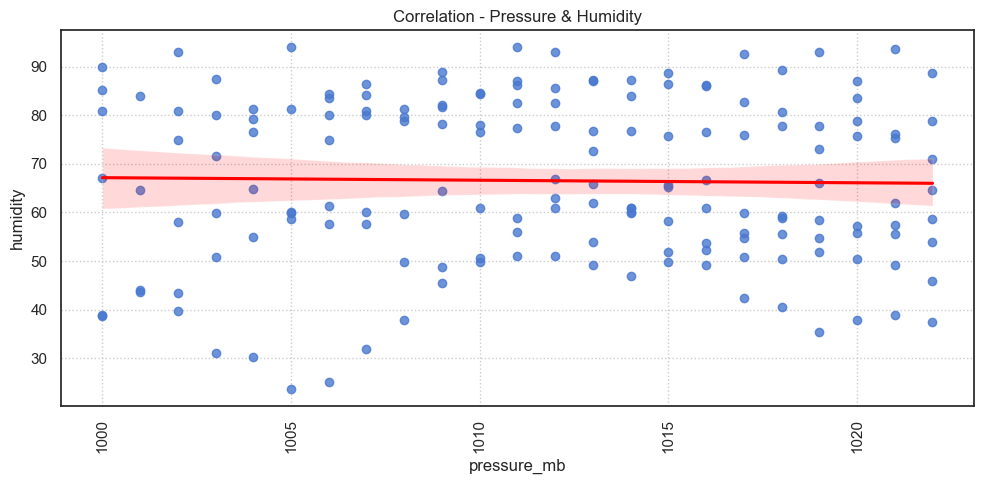

In [1131]:
# Analysing Correlation between Pressure & Humidity

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_Pressure_mean_humidity, x='pressure_mb', y='humidity', 
            scatter=True, order=1, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Pressure & Humidity')

plt.tight_layout()
plt.show()   

# Inference:
# There's not much direct correlation between pressure and average humidity.

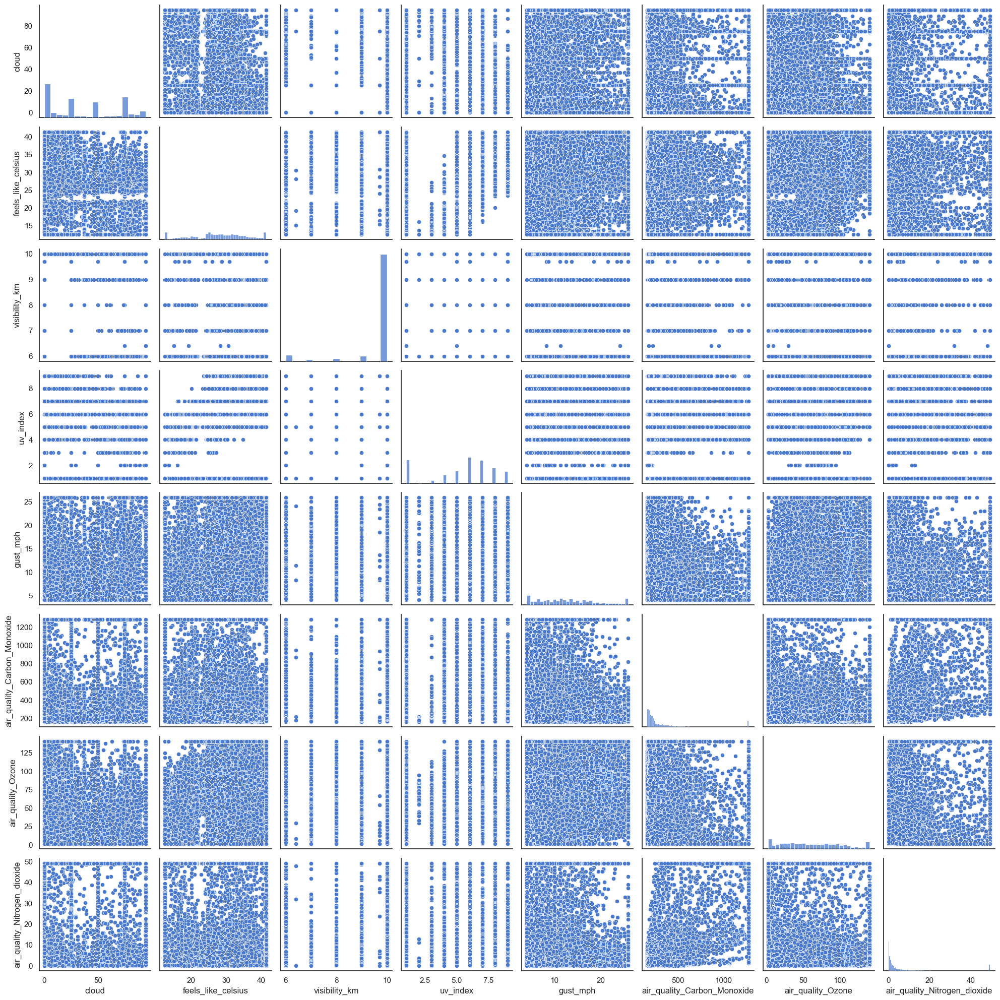

In [135]:
# Pairplot for df2

sns.pairplot(data = df2)

plt.tight_layout()
plt.show()

# Potential Correlations:
# 1. 

In [136]:
# Correlation matrix for df2

corr2 = df2.corr()  
corr2

,cloud,feels_like_celsius,visibility_km,uv_index,gust_mph,air_quality_Carbon_Monoxide,air_quality_Ozone,air_quality_Nitrogen_dioxide
cloud,1.000000,-0.175442,-0.188149,-0.413280,0.022763,0.049393,-0.393428,-0.024252
feels_like_celsius,-0.175442,1.000000,0.056142,0.386028,0.176548,-0.018832,0.134406,-0.049543
visibility_km,-0.188149,0.056142,1.000000,0.108495,0.056942,-0.179822,0.104374,-0.120474
uv_index,-0.413280,0.386028,0.108495,1.000000,0.031882,-0.232414,0.485127,-0.278405
gust_mph,0.022763,0.176548,0.056942,0.031882,1.000000,-0.242771,0.195197,-0.188568
air_quality_Carbon_Monoxide,0.049393,-0.018832,-0.179822,-0.232414,-0.242771,1.000000,-0.360861,0.748044
air_quality_Ozone,-0.393428,0.134406,0.104374,0.485127,0.195197,-0.360861,1.000000,-0.259645
air_quality_Nitrogen_dioxide,-0.024252,-0.049543,-0.120474,-0.278405,-0.188568,0.748044,-0.259645,1.000000


<Axes: >

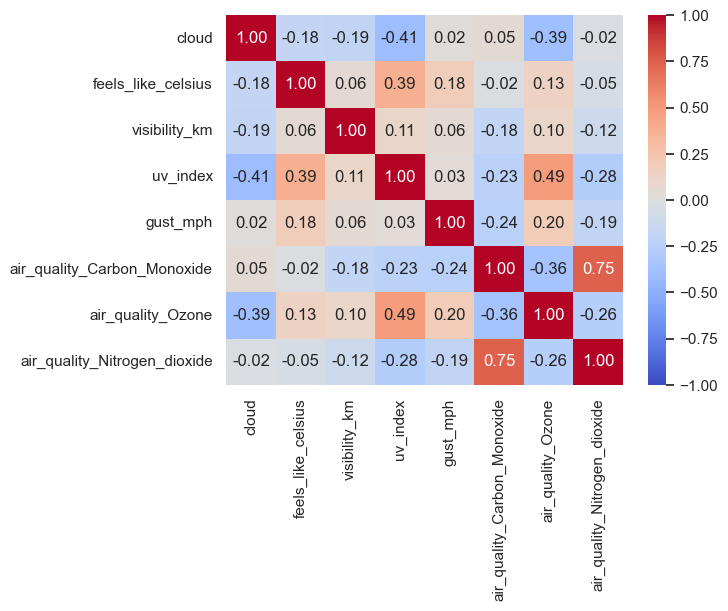

In [137]:
# Heatmap for df2

sns.heatmap(corr2, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)  # Heatmap for df2

# Inference:

# Cloud has 18 percent negative correlation with feels like temperature.
# Cloud has 19 percent negative correlation with visibility.
# Cloud has 41 percent negative correlation with uv index.
# Cloud has 39 percent negative correlation with air quality measurement: ozone.
# Feels like temperature has 39 percent negative correlation with uv index.
# Feels like temperature has 18 percent correlation with wind gust.
# Feels like temperature has 13 percent correlation with air quality measurement: ozone.
# Visibility has 18 percent negative correlation wit air quality measurement: ozone.
# UV_index has 23 percent negative correlation wit air quality measurement: carbon monoxide.
# Wind gust has 24 percent negative correlation wit air quality measurement: carbon monoxide.
# Air quality measurement: carbon monoxide has 75 percent correlation with air quality measurement: Nitrogen dioxide.
# Air quality measurement: carbon monoxide has 36 percent negative correlation with air quality measurement: ozone.

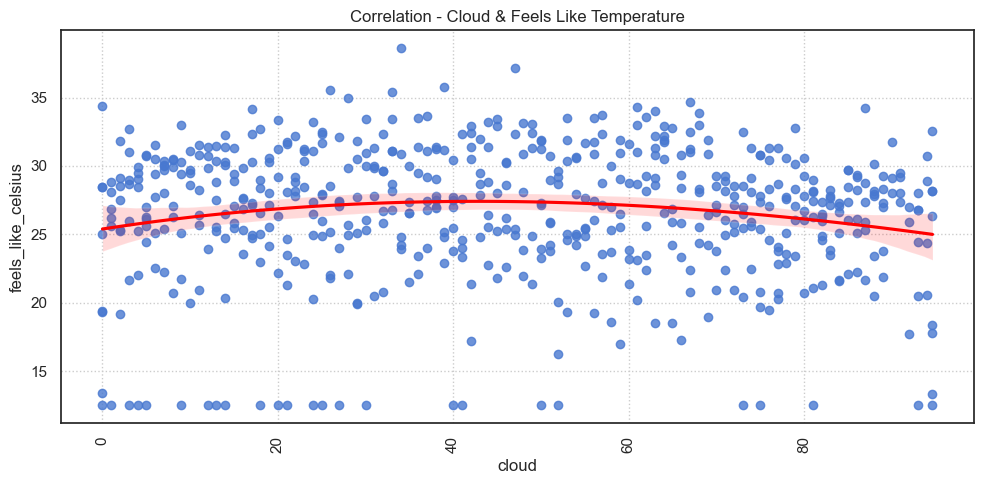

In [139]:
# Analysing Correlation between Windspeed & Humidity

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_cloud_mean_feelslike_temp, x='cloud', y='feels_like_celsius', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Cloud & Feels Like Temperature')

plt.tight_layout()
plt.show()   

# Inference:

# Average cloud slightly decreases with  increase in feels like temperature.

In [1418]:
# Analysing Correlation between Cloud & UV Index

df_cloud_mean_uv_index = df_new.groupby(['cloud','Continent/Region'],as_index=False).agg({'uv_index':'mean'}).sort_values(by='uv_index', ascending=False)

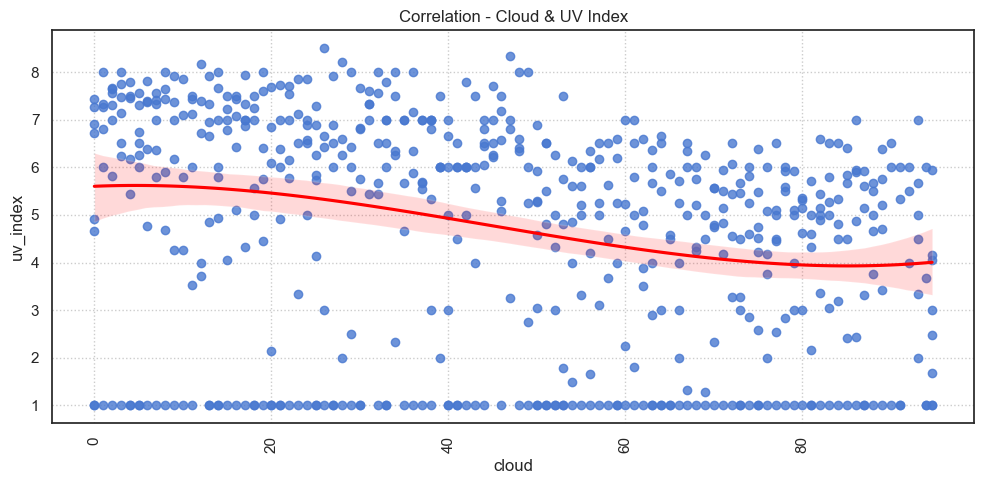

In [143]:
# Analysing Correlation between Cloud & UV index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_cloud_mean_uv_index, x='cloud', y='uv_index', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Cloud & UV Index')

plt.tight_layout()
plt.show()   

# Inference:

# Both share a reverse linear polynomial relationship.
# Higher the cloud cover percentage, lower is the average uv index.

In [1419]:
# Analysing Correlation between Cloud & Air Quality Measurement: Ozone

df_cloud_mean_ozone = df_new.groupby(['cloud','Continent/Region'],as_index=False).agg({'air_quality_Ozone':'mean'}).sort_values(by='air_quality_Ozone', ascending=False)

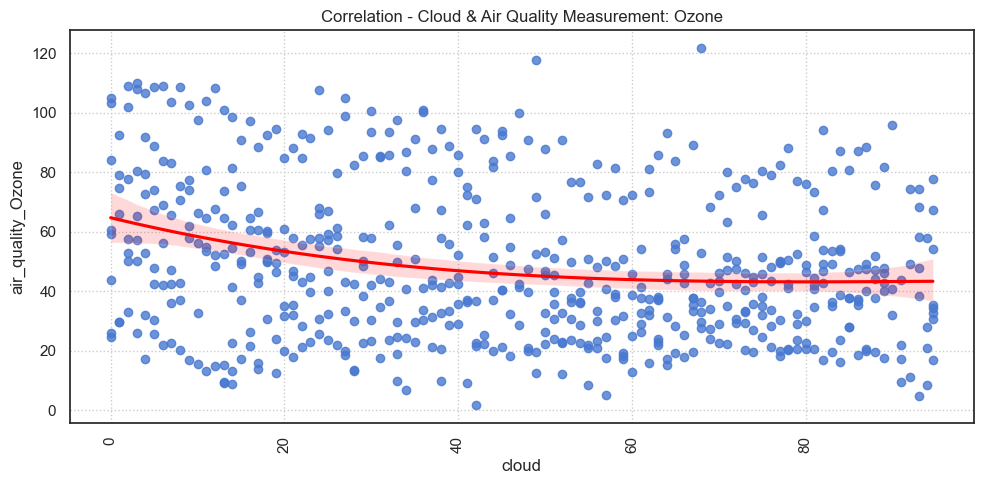

In [145]:
# Analysing Correlation between Cloud & Air Quality Measurement: Ozone

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_cloud_mean_ozone, x='cloud', y='air_quality_Ozone', 
            scatter=True, order=3, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Cloud & Air Quality Measurement: Ozone')

plt.tight_layout()
plt.show()   

# Inference:

# Both share a slight reverse linear polynomial relationship.
# Higher the cloud cover percentage, lower is the average air quality: ozone measurement.

In [1398]:
# Analysing Correlation between Temperature & UV Index

df_temp_mean_uv_index = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'uv_index':'mean'}).sort_values(by='uv_index', ascending=False)

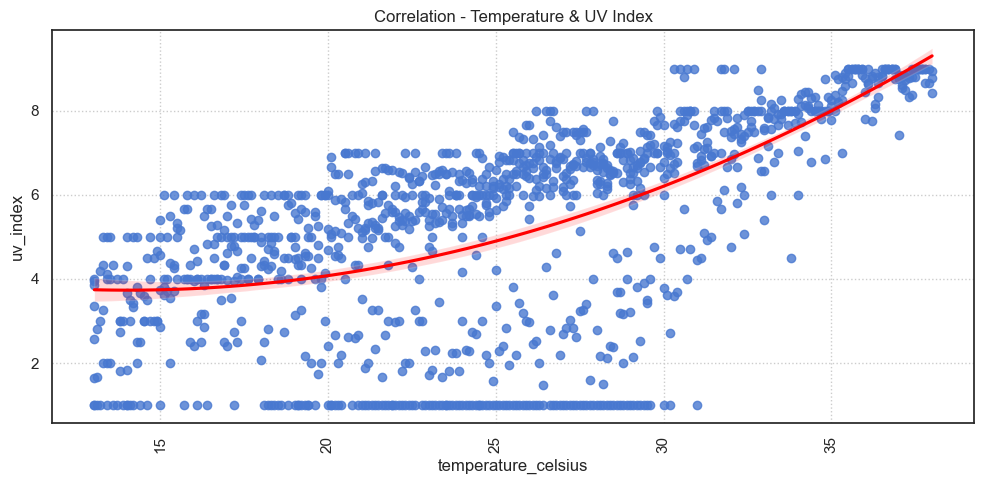

In [147]:
# Analysing Correlation between Temperature & UV Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_uv_index, x='temperature_celsius', y='uv_index', 
            order=2, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & UV Index')

plt.tight_layout()
plt.show()   

# Inference:

# Average UV index increases with temperature increase.
# High UV index regions have high temperatures.
# This hypothesis can be supported with a fact that countries near the poles low temperature as low UV index while  countries near the equator have high temperature as high UV index. 

In [1399]:
# Analysing Correlation between Temperature & Pressure

df_temp_mean_pressure = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'pressure_mb':'mean'}).sort_values(by='pressure_mb', ascending=False)

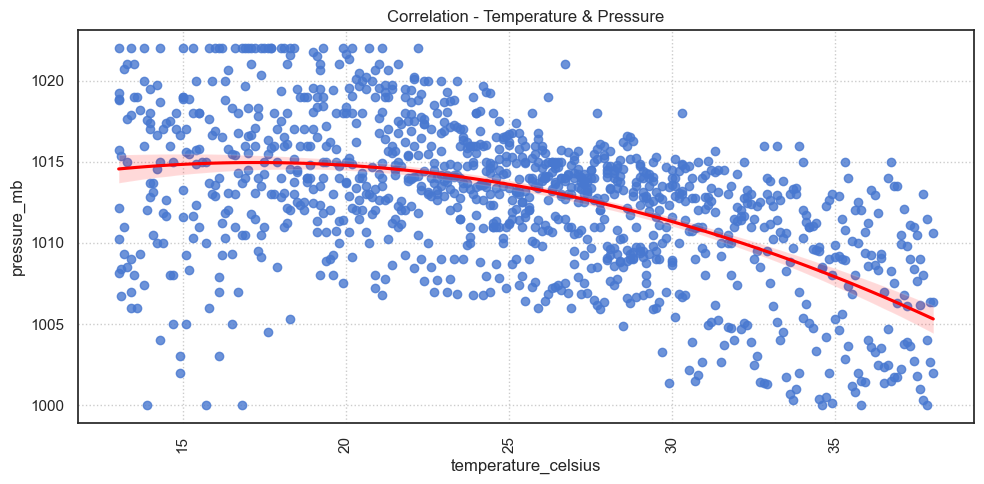

In [1111]:
# Analysing Correlation between Temperature & Pressure

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_pressure, x='temperature_celsius', y='pressure_mb', 
            order=2, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & Pressure')

plt.tight_layout()
plt.show()   

# Inference:

# Average temperature decreases with pressure.
# High temperature regions have low pressures.
# This hypothesis can be supported with a fact that countries near the poles have high pressure as low temperature 
# while  countries near the equator have low pressure as high temperature. 

In [1400]:
# Analysing Correlation between Temperature & Humidity

df_temp_mean_humidity = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'humidity':'mean'}).sort_values(by='humidity', ascending=False)

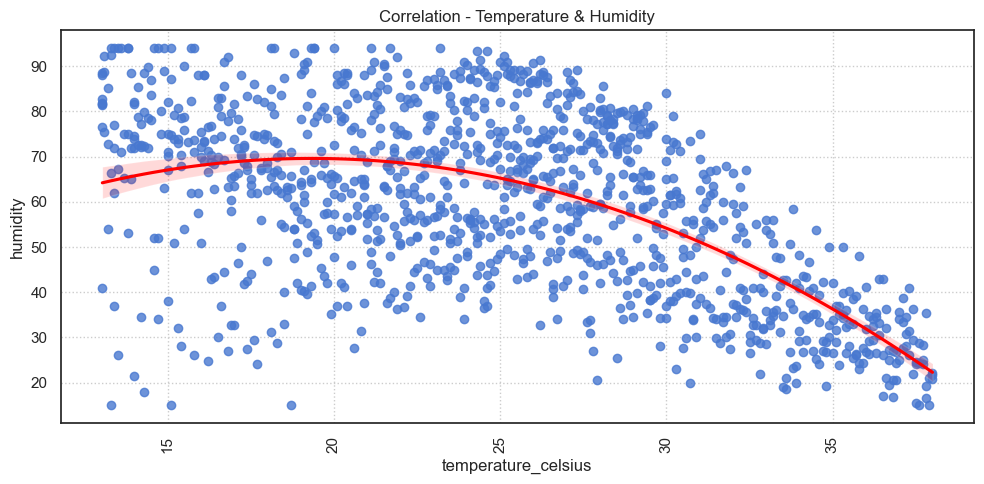

In [1117]:
# Analysing Correlation between Temperature & Humidity

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_humidity, x='temperature_celsius', y='humidity', 
            order=2, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & Humidity')

plt.tight_layout()
plt.show()   

# Inference:

# Average humidity decreases with temperature increase.
# Hot regions have low humidity than cold regions.

In [1401]:
# Analysing Correlation between Temperature & Wind Speed

df_temp_mean_wind = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'wind_mph':'mean'}).sort_values(by='wind_mph', ascending=False)

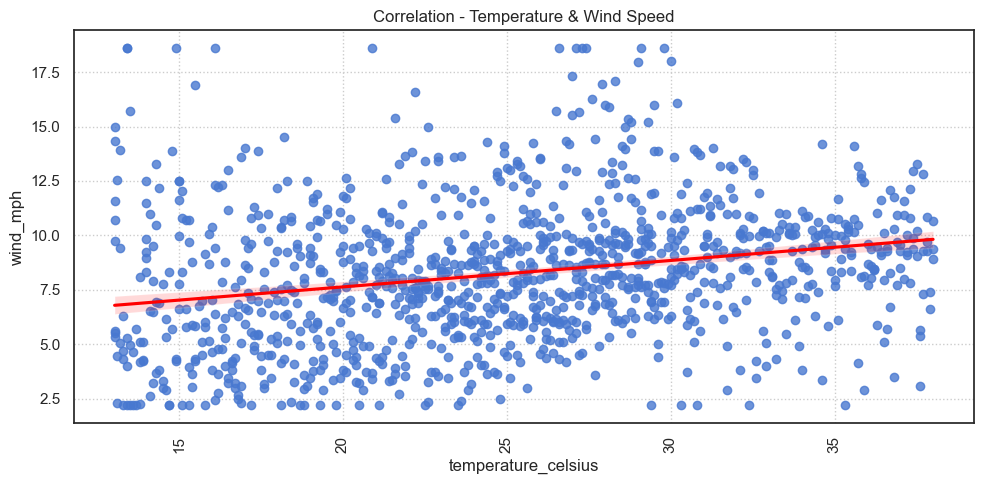

In [1121]:
# Analysing Correlation between Temperature & Wind Speed

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_wind, x='temperature_celsius', y='wind_mph', 
            scatter=True, order=1, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & Wind Speed')

plt.tight_layout()
plt.show()   

# Inference:

# Average wind speed slightly increases with temperature increase.
# High temperature regions have high wind speed.
# This hypothesis not always hold true as countries near North pole have high winds despite low temperatures.
# Hence, there are other climatic conditions which largely impacts wind speed.

In [1402]:
# Analysing Correlation between Temperature & Air quality measurement: ozone

df_temp_mean_air_ozone = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'air_quality_Ozone':'mean'}).sort_values(by='air_quality_Ozone', ascending=False)

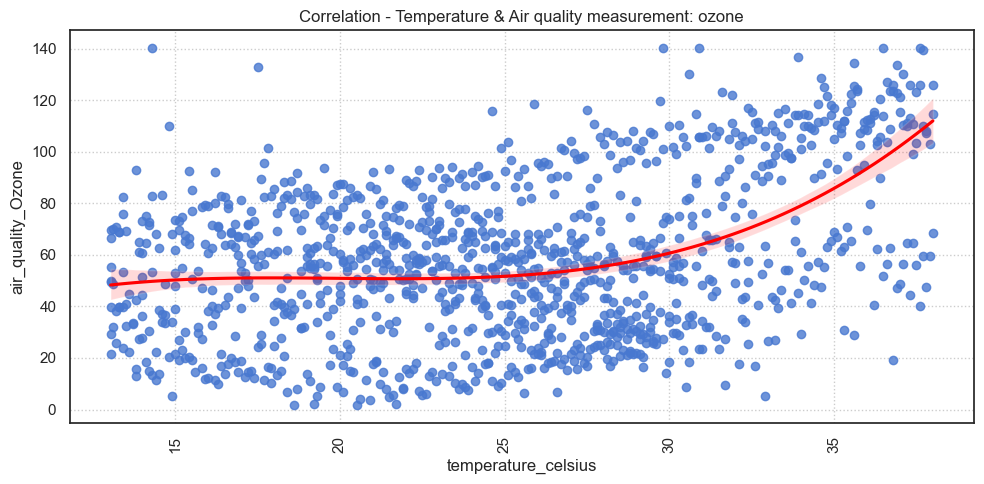

In [151]:
# Analysing Correlation between Temperature & Air quality measurement: ozone

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_air_ozone, x='temperature_celsius', y='air_quality_Ozone', 
            scatter=True, order=3, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & Air quality measurement: ozone')

plt.tight_layout()
plt.show()   

# Inference:

# Both share a linear polynomial relationship with a slow slope till 28 degree celsius,
# post which, air quality ozone increases linearly with a decent slope.
# It can be generalised that Higher the temperature, higher is the average air quality ozone measurement.

In [1403]:
# Analysing Correlation between Wind Speed & Air quality measurement: Carbon monoxide

df_wind_mean_air_carbon_monoxide = df_new.groupby(['wind_mph','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

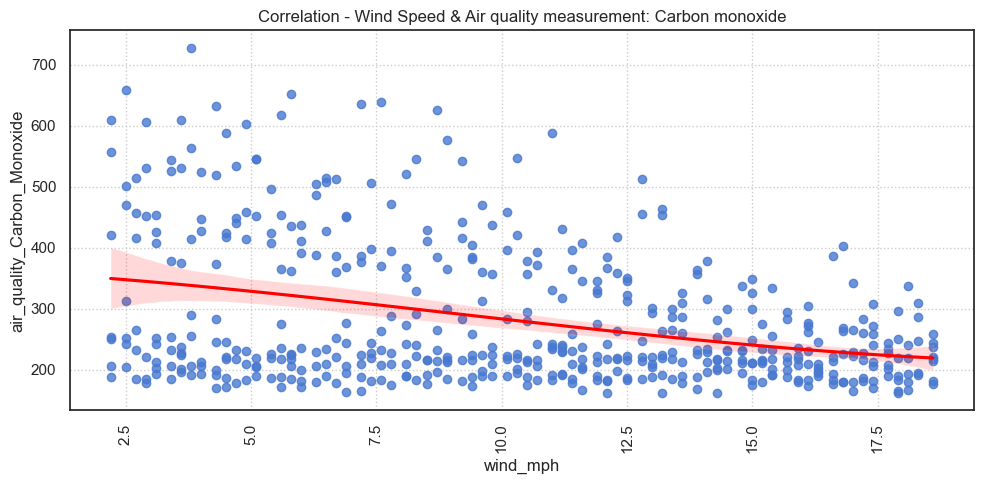

In [1191]:
# Analysing Correlation between Wind Speed & Air quality measurement: Carbon monoxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_wind_mean_air_carbon_monoxide, x='wind_mph', y='air_quality_Carbon_Monoxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Wind Speed & Air quality measurement: Carbon monoxide')

plt.tight_layout()
plt.show()   

# Inference:

# Average carbon monoxide levels in air decreases with  increase in wind speed.

In [1404]:
# Analysing Correlation between Latitude & Air quality measurement: Carbon monoxide

df_lat_mean_air_carbon_monoxide = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

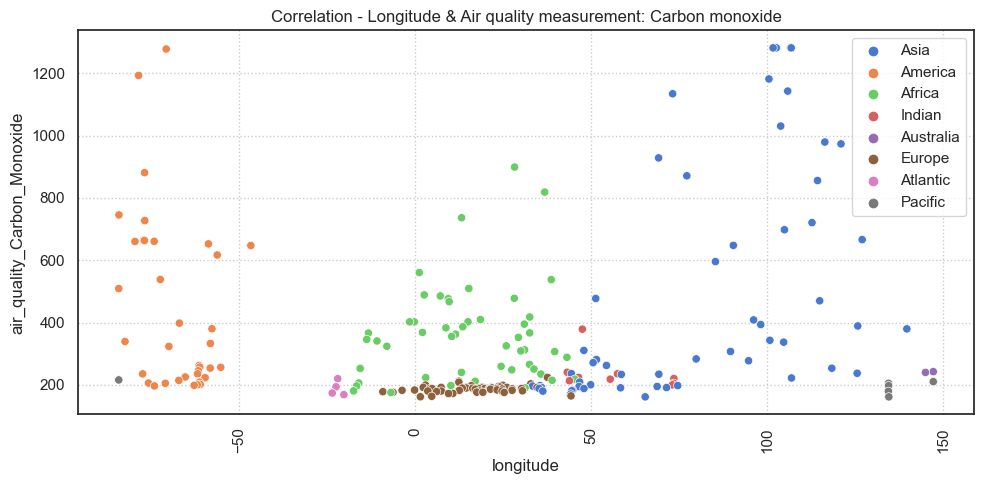

In [1173]:
# Analysing Correlation between Longitude & Air quality measurement: Carbon monoxide

df_long_mean_air_carbon_monoxide = df_new.groupby(['longitude','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_long_mean_air_carbon_monoxide, x='longitude', y='air_quality_Carbon_Monoxide',hue='Continent/Region', ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Longitude & Air quality measurement: Carbon monoxide')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# Longitude don’t have much impact on the presence of Carbon Monoxide in air.

In [1405]:
# Analysing Correlation between Temperature & Air quality measurement: Carbon monoxide

df_temp_mean_air_carbon_monoxide = df_new.groupby(['temperature_celsius','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

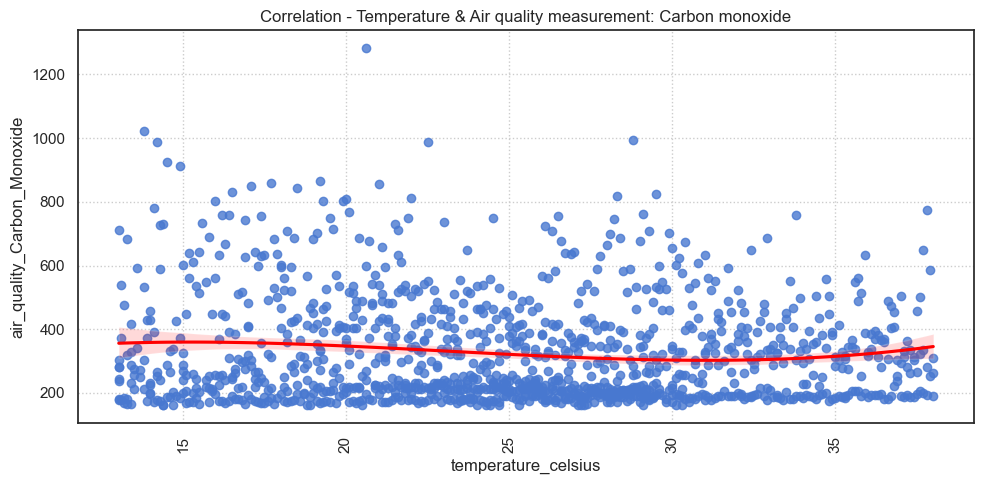

In [1150]:
# Analysing Correlation between Temperature & Air quality measurement: Carbon monoxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_temp_mean_air_carbon_monoxide, x='temperature_celsius', y='air_quality_Carbon_Monoxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Temperature & Air quality measurement: Carbon monoxide')

plt.tight_layout()
plt.show()   

# Inference:

# Average carbon monoxide levels in air slightly decreases with  increase in temperature.

In [1406]:
# Analysing Correlation between Pressure & Air quality measurement: Carbon monoxide

df_pressure_mean_air_carbon_monoxide = df_new.groupby(['pressure_mb','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

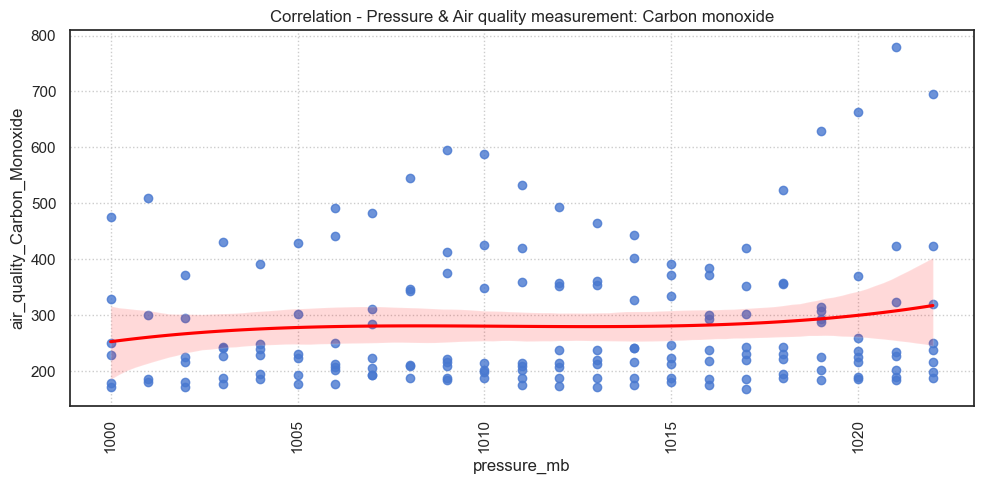

In [1178]:
# Analysing Correlation between Pressure & Air quality measurement: Carbon monoxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_pressure_mean_air_carbon_monoxide, x='pressure_mb', y='air_quality_Carbon_Monoxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Pressure & Air quality measurement: Carbon monoxide')

plt.tight_layout()
plt.show()   

# Inference:

# Average carbon monoxide levels in air slightly increases with  increase in pressure.

In [1407]:
# Analysing Correlation between Humidity & Air quality measurement: Carbon monoxide

df_humidity_mean_air_carbon_monoxide = df_new.groupby(['humidity','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

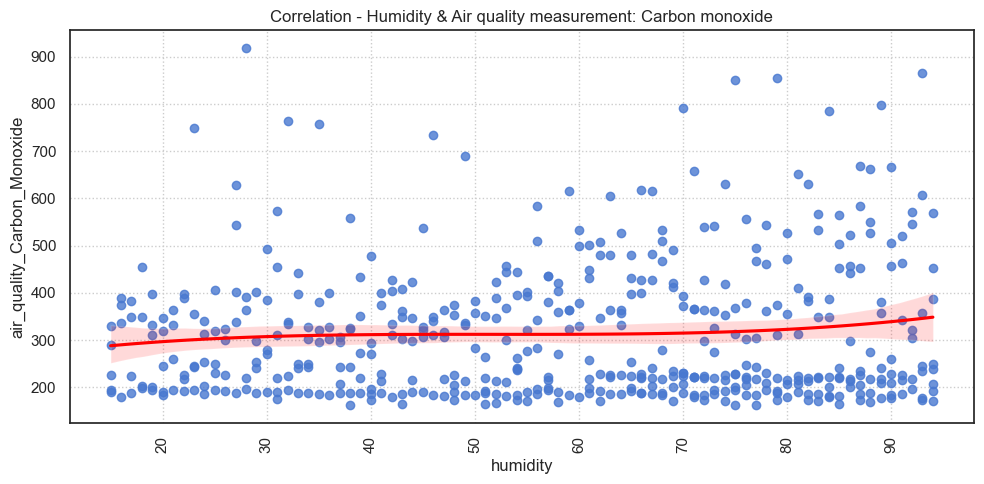

In [1180]:
# Analysing Correlation between Humidity & Air quality measurement: Carbon monoxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_humidity_mean_air_carbon_monoxide, x='humidity', y='air_quality_Carbon_Monoxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Humidity & Air quality measurement: Carbon monoxide')

plt.tight_layout()
plt.show()   

# Inference:

# There's slight postive linearity between humidity and carbon monoxide levels in air.
# For humidity less than 25 percent, the average carbon monoxide levels is as low as 286 units 
## while for humidity greater than 80 percent, the average carbon monoxide levels is as high as 334 units.
# More Humid regions have more carbon monoxide levels than less humid ones.

In [1422]:
# Analysing Correlation between UV Index & Air quality measurement: Ozone

df_uv_index_mean_ozone = df_new.groupby(['uv_index','Continent/Region'],as_index=False).agg({'air_quality_Ozone':'mean'}).sort_values(by='air_quality_Ozone', ascending=False)

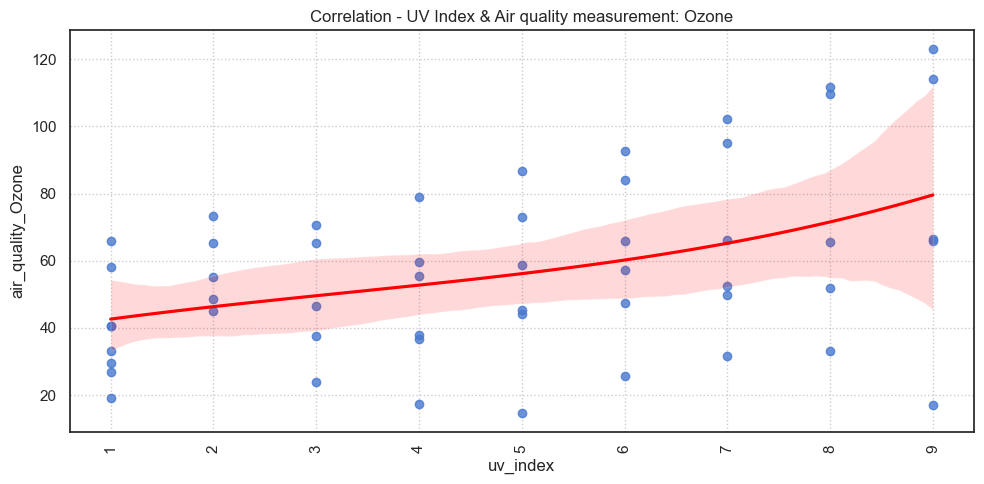

In [1200]:
# Analysing Correlation between UV Index & Air quality measurement: Ozone

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_uv_index_mean_ozone, x='uv_index', y='air_quality_Ozone', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - UV Index & Air quality measurement: Ozone')

plt.tight_layout()
plt.show()   

# Inference:

# Higher the uv index, higher is the average air quality ozone range.

In [1421]:
# Analysing Correlation between Cloud & Air quality measurement: Ozone

df_cloud_mean_ozone = df_new.groupby(['cloud','Continent/Region'],as_index=False).agg({'air_quality_Ozone':'mean'}).sort_values(by='air_quality_Ozone', ascending=False)

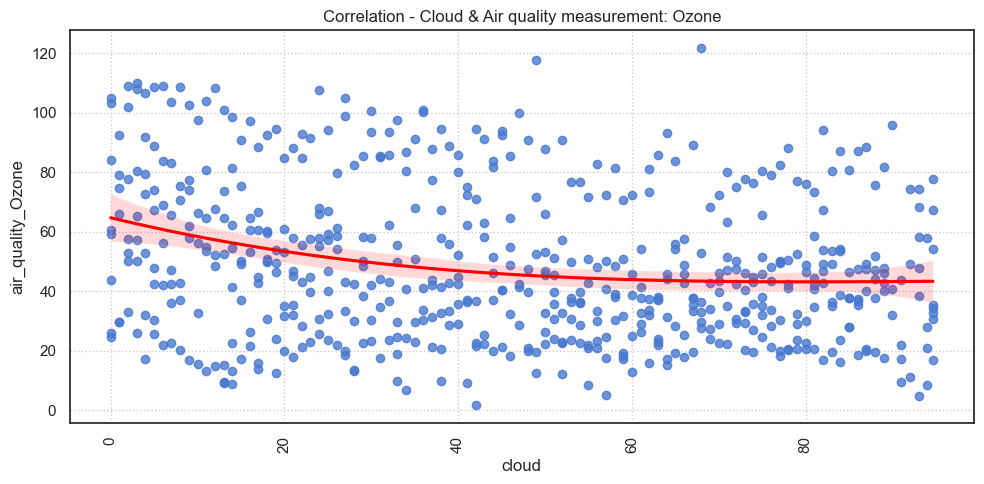

In [1202]:
# Analysing Correlation between Cloud & Air quality measurement: Ozone

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_cloud_mean_ozone, x='cloud', y='air_quality_Ozone', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Cloud & Air quality measurement: Ozone')

plt.tight_layout()
plt.show()   

# Inference:

# Slight inverse relationship between cloud and average air quality:ozone.

In [1408]:
# Analysing Correlation between Air quality measurement: Carbon monoxide & Air quality measurement: Nitrogen dioxide

df_carbon_monoxide_mean_air_nitrogen_oxide = df_new.groupby(['air_quality_Carbon_Monoxide','Continent/Region'],as_index=False).agg({'air_quality_Nitrogen_dioxide':'mean'}).sort_values(by='air_quality_Nitrogen_dioxide', ascending=False)

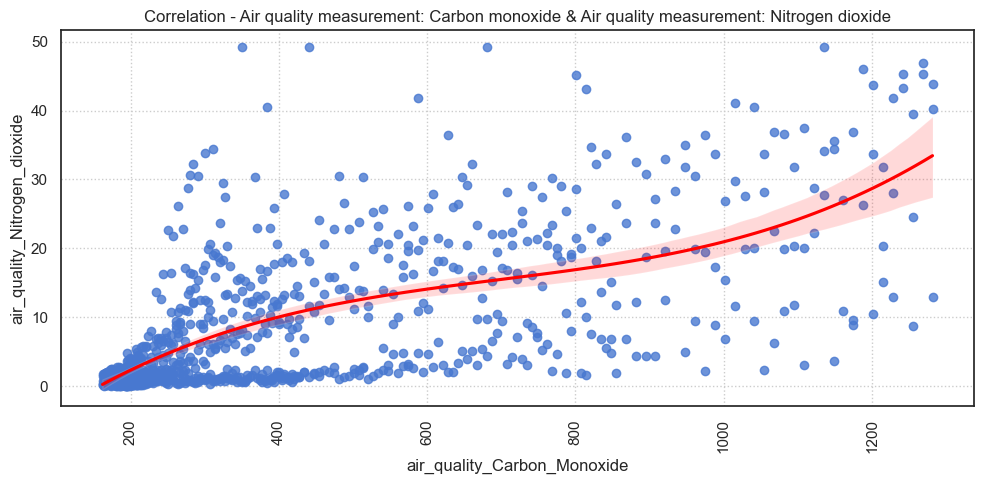

In [160]:
# Analysing Correlation between Air quality measurement: Carbon monoxide & Air quality measurement: Nitrogen dioxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_carbon_monoxide_mean_air_nitrogen_oxide, x='air_quality_Carbon_Monoxide', y='air_quality_Nitrogen_dioxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Carbon monoxide & Air quality measurement: Nitrogen dioxide')

plt.tight_layout()
plt.show()   

# Inference:

# medium to high correlation.

In [1409]:
# Analysing Correlation between Air quality measurement: Carbon monoxide & Air quality measurement: Ozone

df_carbon_monoxide_mean_ozone = df_new.groupby(['air_quality_Carbon_Monoxide','Continent/Region'],as_index=False).agg({'air_quality_Ozone':'mean'}).sort_values(by='air_quality_Ozone', ascending=False)

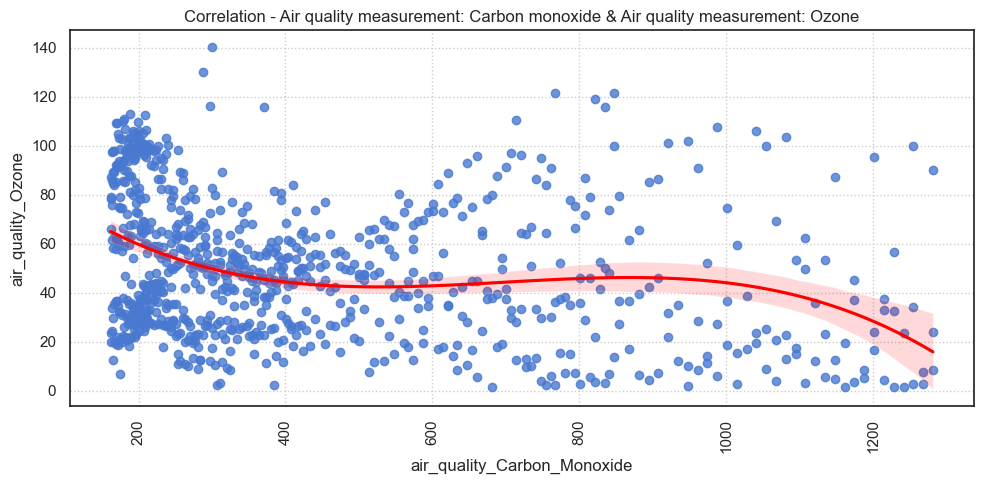

In [162]:
# Analysing Correlation between Air quality measurement: Carbon monoxide & Air quality measurement: Ozone

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_carbon_monoxide_mean_ozone, x='air_quality_Carbon_Monoxide', y='air_quality_Ozone', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Carbon monoxide & Air quality measurement: Ozone')

plt.tight_layout()
plt.show()   

# Inference:

# negative correlation.

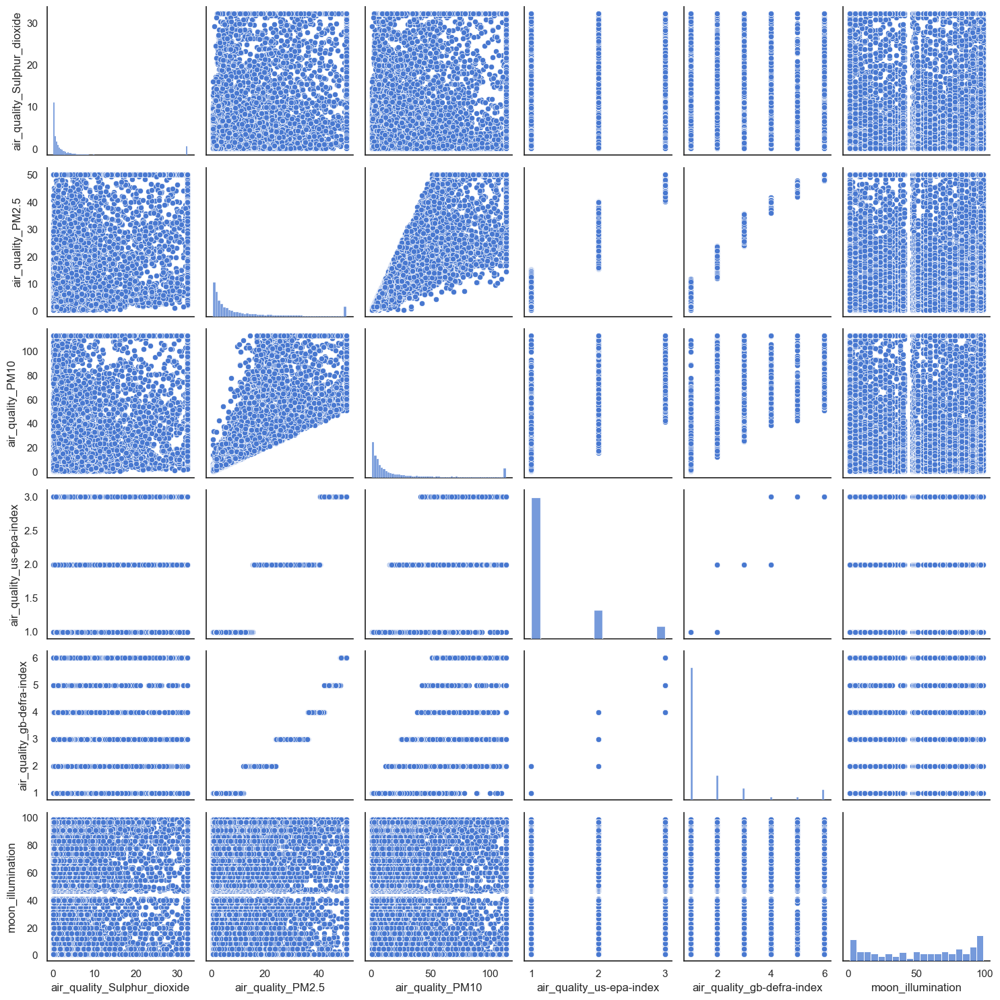

In [163]:
# Pairplot for df3

sns.pairplot(data = df3)

plt.tight_layout()
plt.show()

In [164]:
# Correlation matrix for df3

corr3 = df3.corr()    
corr3

,air_quality_Sulphur_dioxide,air_quality_PM2.5,air_quality_PM10,air_quality_us-epa-index,air_quality_gb-defra-index,moon_illumination
air_quality_Sulphur_dioxide,1.000000,0.637257,0.465058,0.600431,0.627890,0.005432
air_quality_PM2.5,0.637257,1.000000,0.885135,0.945409,0.964008,0.007388
air_quality_PM10,0.465058,0.885135,1.000000,0.839990,0.842052,0.005820
air_quality_us-epa-index,0.600431,0.945409,0.839990,1.000000,0.937928,0.008590
air_quality_gb-defra-index,0.627890,0.964008,0.842052,0.937928,1.000000,0.004731
moon_illumination,0.005432,0.007388,0.005820,0.008590,0.004731,1.000000


<Axes: >

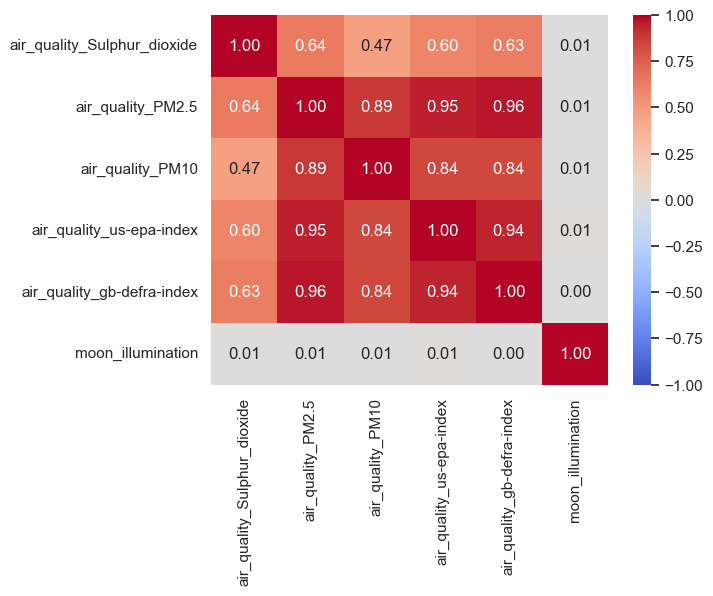

In [165]:
 # Heatmap for df3

sns.heatmap(corr3, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)  # Heatmap for df3

# Inference:

# Air quality suplhur dioxide has 63 percent correlation with air_quality_gb-defra-index.
# Air quality PM2.5 has 96 percent correlation with air_quality_gb-defra-index.
# Air quality PM10 has 84 percent correlation with air_quality_gb-defra-index.
# Air quality US EPA index has 94 percent correlation with air_quality_gb-defra-index.

In [1411]:
# Analysing Correlation between Air quality measurement: Sulphur dioxide & Air quality measurement: GB DEFRA Index

df_suplhur_dioxide_mean_gb_defra = df_new.groupby(['air_quality_Sulphur_dioxide','Continent/Region'],as_index=False).agg({'air_quality_gb-defra-index':'mean'}).sort_values(by='air_quality_gb-defra-index', ascending=False)

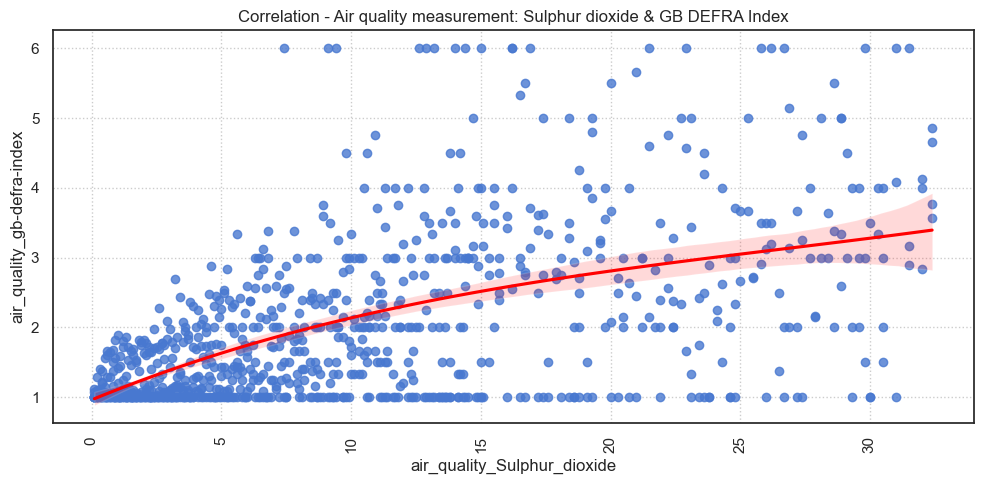

In [167]:
# Analysing Correlation between Air quality measurement: Sulphur dioxide & Air quality measurement: GB DEFRA Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_suplhur_dioxide_mean_gb_defra, x='air_quality_Sulphur_dioxide', y='air_quality_gb-defra-index', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Sulphur dioxide & GB DEFRA Index')
plt.tight_layout()
plt.show()   

# Inference:

# medium to high correlation.

In [1412]:
# Analysing Correlation between Air quality measurement: Air quality PM2.5 & Air quality measurement: GB DEFRA Index

df_air_qualityPM2_mean_gb_defra = df_new.groupby(['air_quality_PM2.5','Continent/Region'],as_index=False).agg({'air_quality_gb-defra-index':'mean'}).sort_values(by='air_quality_gb-defra-index', ascending=False)

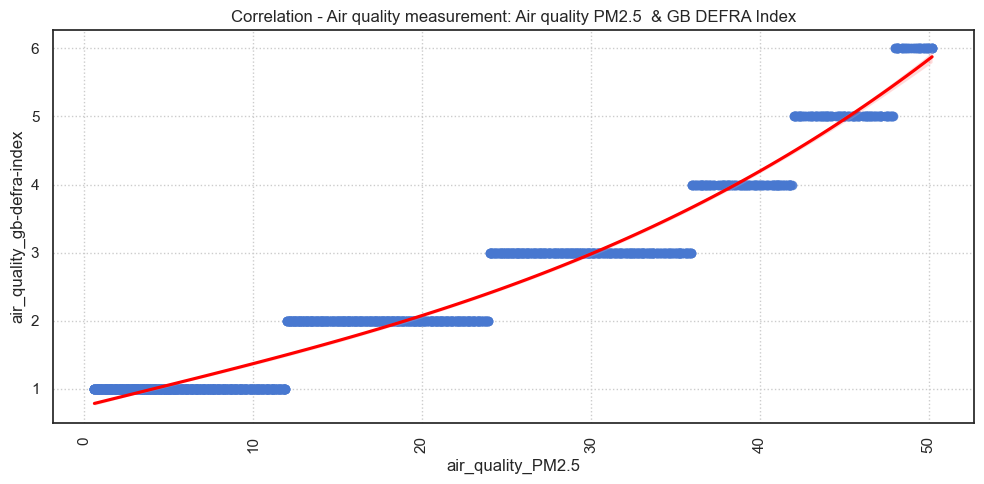

In [1142]:
# Analysing Correlation between Air quality measurement: Air quality PM2.5 & Air quality measurement: GB DEFRA Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_air_qualityPM2_mean_gb_defra, x='air_quality_PM2.5', y='air_quality_gb-defra-index', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Air quality PM2.5  & GB DEFRA Index')
plt.tight_layout()
plt.show()   

# Inference:

# medium to high correlation.

In [1413]:
# Analysing Correlation between Air quality measurement: Air quality PM10 & Air quality measurement: GB DEFRA Index

df_air_qualityPM10_mean_gb_defra = df_new.groupby(['air_quality_PM10','Continent/Region'],as_index=False).agg({'air_quality_gb-defra-index':'mean'}).sort_values(by='air_quality_gb-defra-index', ascending=False)

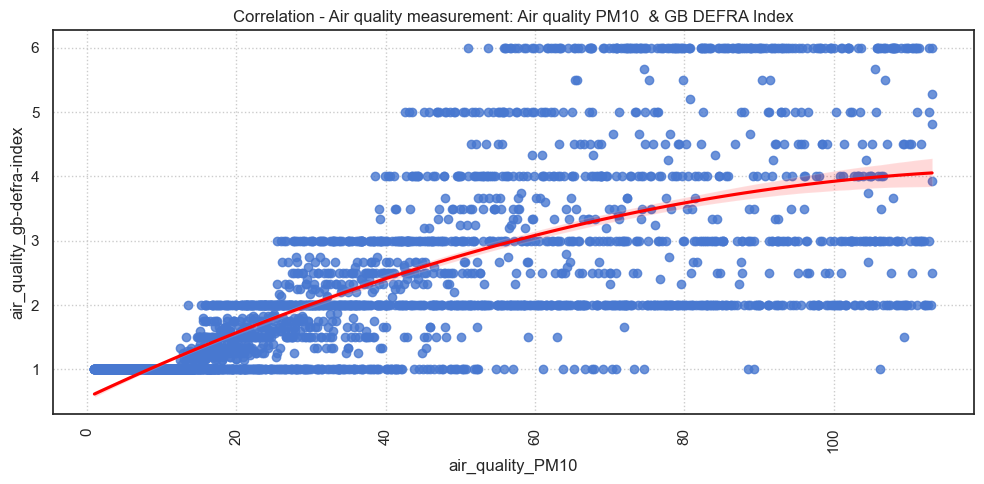

In [171]:
# Analysing Correlation between Air quality measurement: Air quality PM10 & Air quality measurement: GB DEFRA Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_air_qualityPM10_mean_gb_defra, x='air_quality_PM10', y='air_quality_gb-defra-index', 
            order=2, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Air quality PM10  & GB DEFRA Index')
plt.tight_layout()
plt.show()   

# Inference:

# medium to high correlation.

In [1414]:
# Analysing Correlation between Air quality measurement: Ozone & UV Index

df_ozone_mean_uv_index = df_new.groupby(['air_quality_Ozone','Continent/Region'],as_index=False).agg({'uv_index':'mean'}).sort_values(by='uv_index', ascending=False)

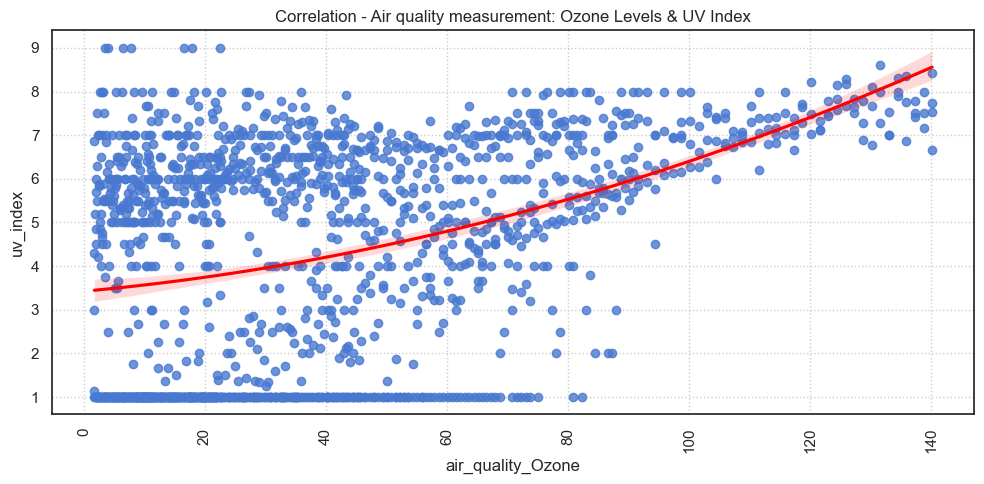

In [1388]:
# Analysing Correlation between Air quality measurement: Ozone & UV Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_ozone_mean_uv_index, x='air_quality_Ozone', y='uv_index', 
            order=2, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Air quality measurement: Ozone Levels & UV Index')
plt.tight_layout()
plt.show()   

# Inference:

# medium to high correlation.

In [ ]:
# Other Correlations:

# Latitude with UV Index
# Latitude with Air Quality Index
# Latitude with Moon Illumination
# Temperature with Moon Illumination
# Windspeed and Windgust

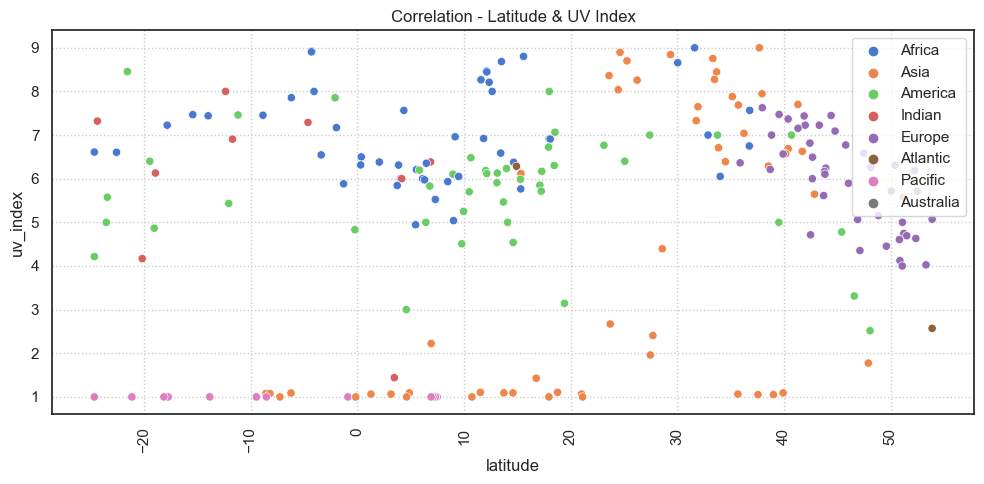

In [172]:
# Analysing Correlation between Latitude & UV Index

df_latitude_mean_uv_index = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'uv_index':'mean'}).sort_values(by='uv_index', ascending=False)

fig, my_ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data = df_latitude_mean_uv_index, x='latitude', y='uv_index',hue='Continent/Region', ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & UV Index')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

# Inference:

# Parts of Asia and Africa (Near the equator) have maximum 8 - 9 units  average UV index.
# Europe, Northern Asia and Northern America (Near North pole) have average UV index range  between 4 - 7 units.
# Pacific & Australia (Near South pole) have average UV index as low as 1 unit.
# However, certain countries in America and Africa, despite being near south pole has high average UV Index (7 - 8.5 units).
# It implies UV index  is affected by other climatic factors too than just latitudes.

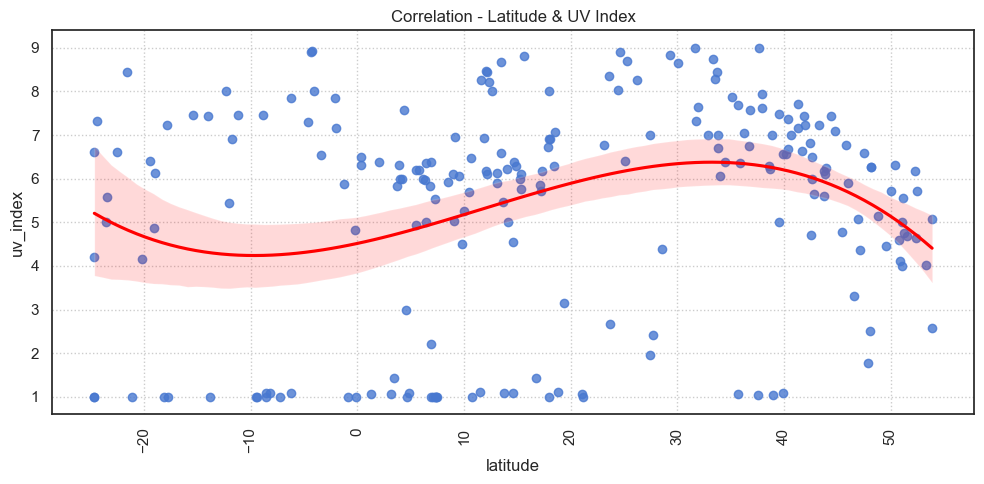

In [173]:
# Analysing Correlation between Latitude & UV Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_latitude_mean_uv_index, x='latitude', y='uv_index', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & UV Index')
plt.tight_layout()
plt.show()   

# Inference:

# Average UV index shares a  linear polynomial equation with latitude.
# Average UV index is slightly higher near equator (Avg. 6 units) than near poles (4 - 5 units).
# However, Certain regions despite being near South pole have high UV index.
# It implies UV index is affected by other climatic factors too than latitudes.

In [1416]:
# Analysing Correlation between Cloud Cover Percentage & UV Index

df_cloud_mean_uv_index = df_new.groupby(['cloud','Continent/Region'],as_index=False).agg({'uv_index':'mean'}).sort_values(by='uv_index', ascending=False)

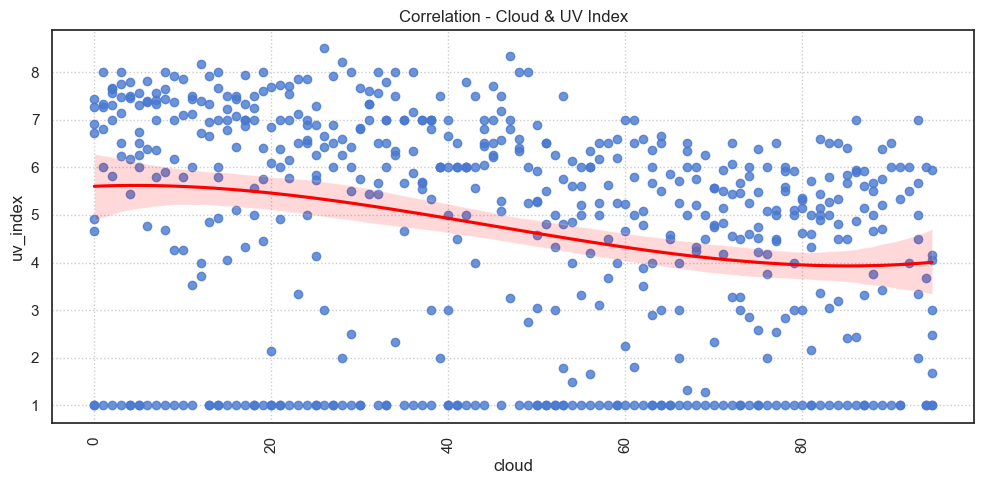

In [1385]:
# Analysing Correlation between Cloud & UV Index

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_cloud_mean_uv_index, x='cloud', y='uv_index', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Cloud & UV Index')
plt.tight_layout()
plt.show()   

# Inference:

# Higher the cloud cover percentage, lower the average uv index.

In [1415]:
# Analysing Correlation between Latitude & Air Quality Measurement: Carbon Monoxide

df_latitude_mean_air_quality_Carbon_Monoxide = df_new.groupby(['latitude','Continent/Region'],as_index=False).agg({'air_quality_Carbon_Monoxide':'mean'}).sort_values(by='air_quality_Carbon_Monoxide', ascending=False)

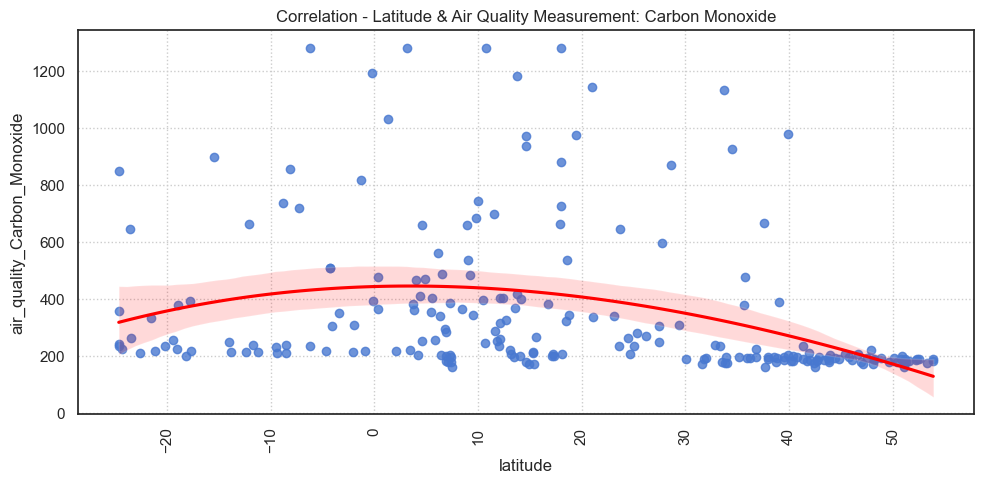

In [175]:
# Analysing Correlation between Latitude & Air Quality Measurement: Carbon Monoxide

fig, my_ax = plt.subplots(figsize=(10,5))

sns.regplot(data = df_latitude_mean_air_quality_Carbon_Monoxide, x='latitude', y='air_quality_Carbon_Monoxide', 
            order=3, scatter=True, fit_reg=True, line_kws={"color": "red"}, ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Correlation - Latitude & Air Quality Measurement: Carbon Monoxide')
plt.tight_layout()
plt.show()   

# Inference:

# Latitude don’t have much impact on the presence of Carbon Monoxide in air.

In [ ]:
##------------------END OF SUB-SECTION - Bivariate Analysis between Metrices--------------##

<a id = Section6.4.2></a>

##### **6.4.2** BIVARIATE ANALYSIS - METRICS AND DIMENSIONS

In [ ]:
# The following bivariate relations can be analysed:

# Comparison of weather features for different continents/regions.

# Relation between country/location and temperature
# Relation between location and precipitation
# Relation between location and wind direction

# Relation between weather condition and temperature
# Relation between weather condition and wind speed and wind degree
# Relation between weather condition and pressure
# Relation between weather condition and precipitation
# Relation between weather condition and visibility
# Relation between weather condition and uv index
# Relation between weather condition and air quality index
# Relation between weather condition and moon illumination

# Relation between wind direction and metrices

# Relation between sun rise or sunset times and metrices

# Relation between moonrise or moonset times and metrices

# Relation between moonphase and metrices

In [ ]:
# Comparison of weather features for different major timezones.

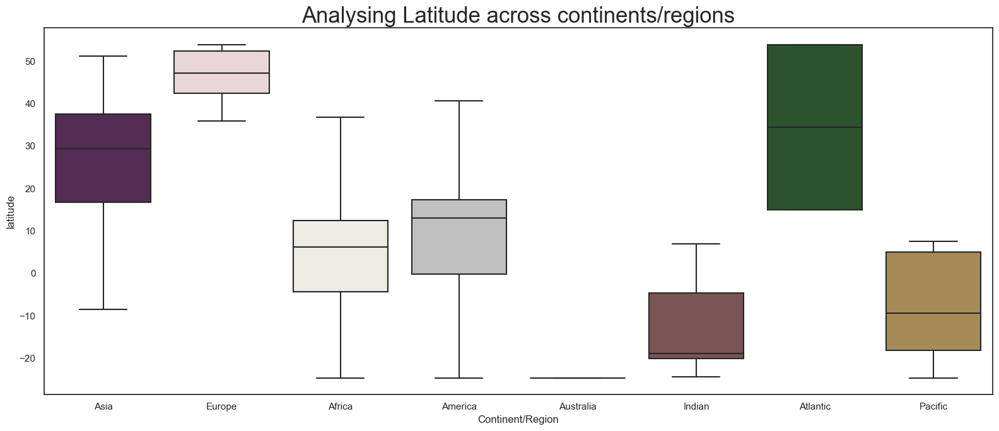

In [1107]:
# Analysing Latitudes across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], 
            y = df_new['latitude'], showfliers=False,
            palette=my_colors, saturation=0.3, ax=my_ax).set_title('Analysing Latitude across continents/regions', fontdict = { 'fontsize': 25})

plt.tight_layout()

# Median latitude for Europe is higher than other timezones.
# Median latitude for Australian timezone is lowest of all.
# Atlantic and Europe timezone has the highest maximum latitude of all.
# Australia the lowest minimum latitudes.
# Atlantic timezone has most dispersed while Australia has least dispersed latitudes.

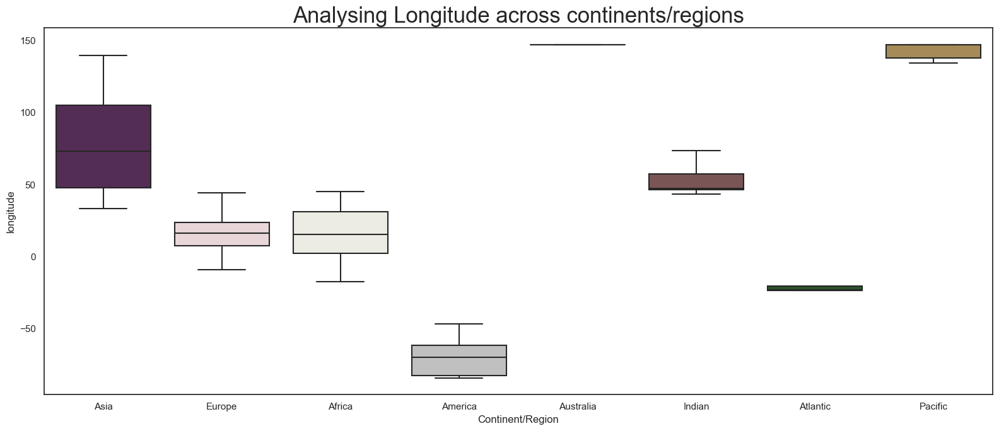

In [826]:
# Analysing Longitude across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], 
            y = df_new['longitude'], showfliers=False,
            palette=my_colors, saturation=0.3, ax=my_ax).set_title('Analysing Longitude across continents/regions', 
                                                                   fontdict = { 'fontsize': 25})
plt.tight_layout()

# Median longitude for Australia and Pacific timezones respectively is higher than other regions/continents.
# Median longitude for American timezone is lowest of all.
# Australia and Pacific timezones respectively have the highest maximum longitude of all.
# America has the lowest minimum longitudes.
# Asia has most dispersed while Australia has least dispersed latitudes.

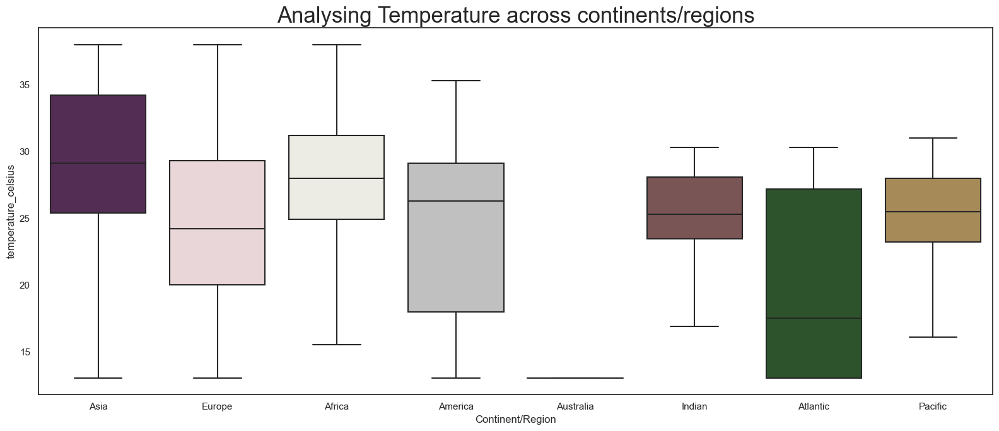

In [825]:
# Analysing Temperature across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['temperature_celsius'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Temperature across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Median temperature for Asia is higher than other timezones.
# Median temperature for Atlantic is lowest of all.
# Asia/Africa/Europe timezones have the highest maximum temperature.
# Europe/America/Australia/Atlantic/Pacific/Asia have the lowest minimum temperatures.
# Atlantic has most dispersed while Australia has least dispersed temperatures.

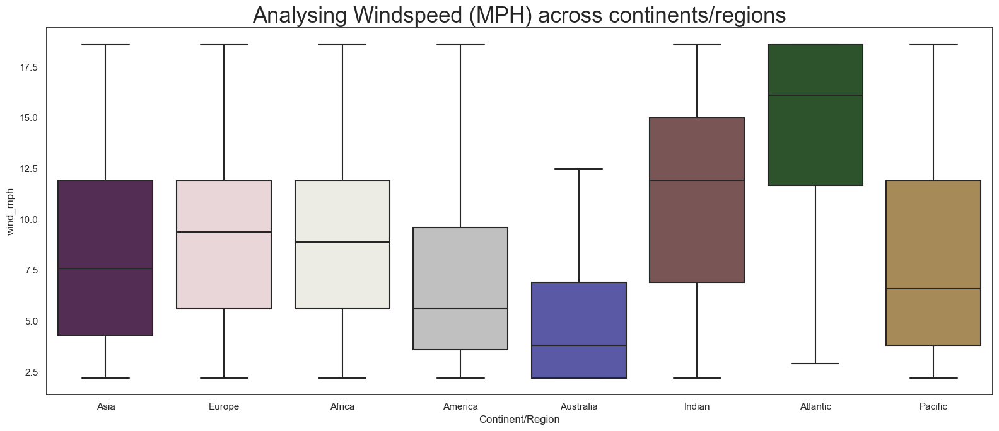

In [821]:
# Analysing Windspeed across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['wind_mph'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Windspeed (MPH) across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Median windspeed for Atlantic is higher than other timezones.
# Median windspeed for Australia is lowest of all.
# Asia/Africa/Europe/Pacific/America/Atlantic/Indian timezones have the highest maximum windspeed.
# Asia/Africa/Europe/Pacific/America/Australia/Indian have the lowest minimum windspeed.
# Asia/Africa/Europe/America/Indian/Pacific have most dispersed while Australia has least dispersed windspeeds.

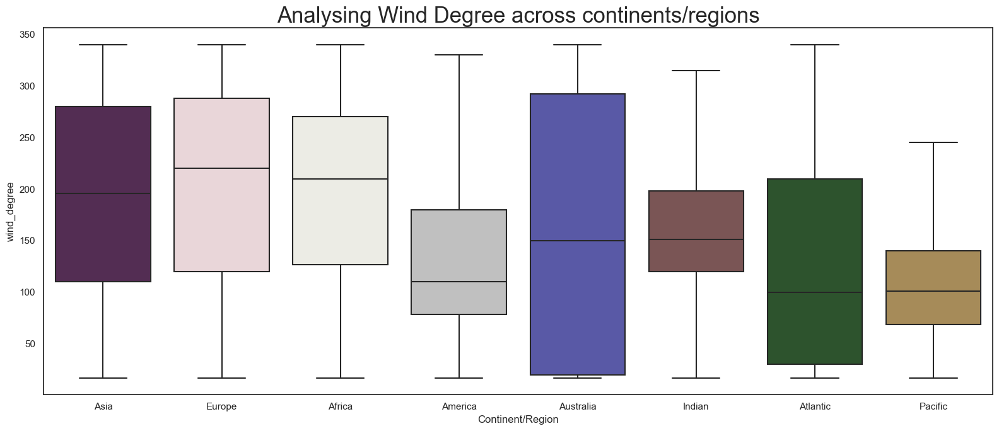

In [857]:
# Analysing Wind degree across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['wind_degree'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Wind Degree across continents/regions',
                                               fontdict = { 'fontsize': 25})

plt.tight_layout()

# Median wind degree for Europe is higher than other timezones.
# Median wind degree for Atlantic is lowest of all.
# Asia/Africa/Europe/Atlantic/Australian timezones have the highest maximum wind degree.
# Asia/Africa/Europe/Atlantic/Australian/Indian/Pacific have the lowest minimum wind degree.
# Asia/Africa/Europe/Atlantic/Australia have most dispersed while Pacific has least dispersed wind degree.

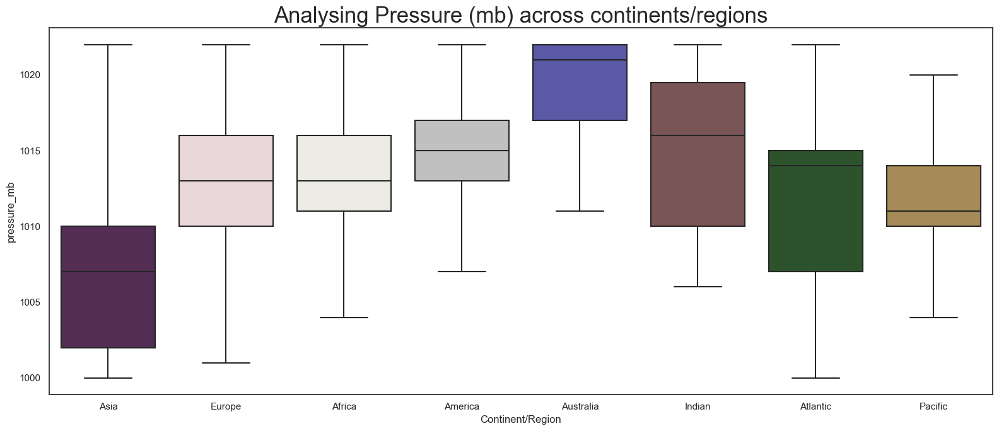

In [858]:
# Analysing Pressure across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['pressure_mb'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Pressure (mb) across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Median pressure for Australia is higher than other timezones.
# Median pressure for Asia is lowest of all.
# Some locations in all the eight timezones have the highest maximum pressure of 1022 mb.
# Some locations in Asia/Africa/Europe/Atlantic/America/Pacific have the lowest minimum pressure.
# Asia/Africa/Europe/Atlantic/America/Atlantic/Pacific timezones have most dispersed while India has least dispersed pressure range.

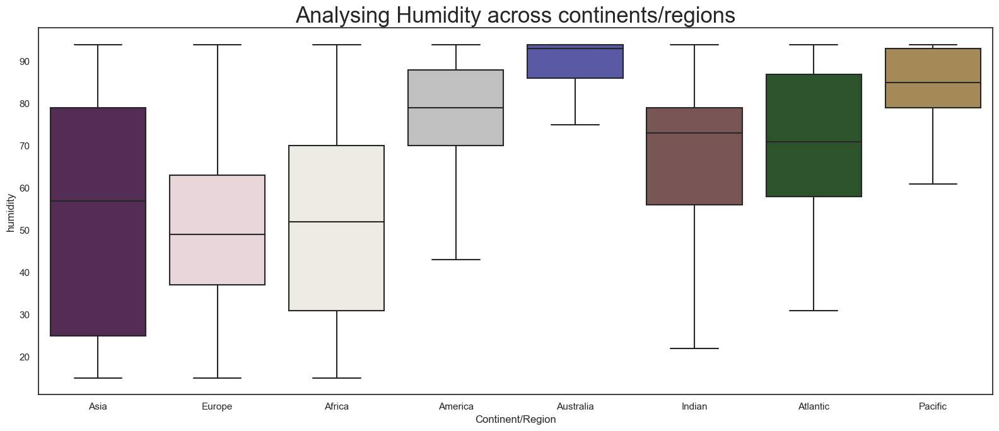

In [859]:
# Analysing humidity across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['humidity'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Humidity across continents/regions',
                                               fontdict = { 'fontsize': 25})

plt.tight_layout()

# Median humidity for Australia is higher than other timezones.
# Median humidity for Europe is lowest of all.
# All the eight timezones have the highest maximum humidity.
# Asia/Africa/Europe/America timezones have the lowest minimum humidity.
# Asia/Africa/Europe/America timezones have most dispersed while Australia and Pacific have least dispersed humidity range.

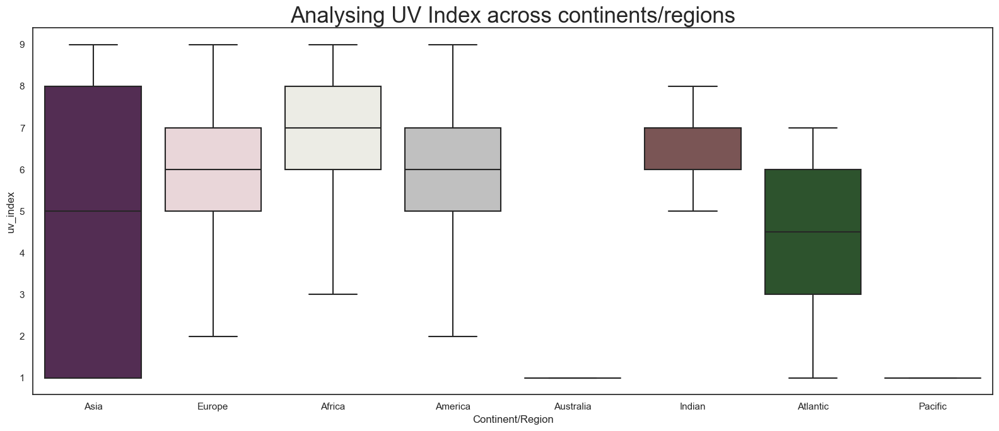

In [876]:
# Analysing UV Index across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['uv_index'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing UV Index across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Median UV index for Africa/India regions is higher than other timezones.
# Median UV index for Australia is lowest of all.
# Asia/Africa/Europe/America/India have the highest maximum UV index.
# Asia/Africa/Europe/America/Australia/Pacific have the lowest minimum UV index.
# Asia/Africa/Europe/America/India have most dispersed while Australia and Pacific have least dispersed uv_index range.

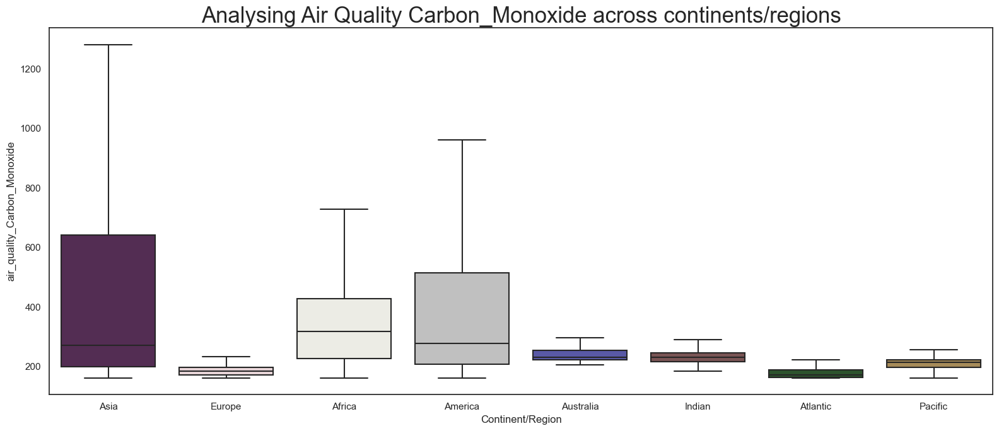

In [891]:
# Analysing Air Quality Carbon_Monoxide across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['air_quality_Carbon_Monoxide'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Air Quality Carbon_Monoxide across continents/regions',
                                               fontdict = { 'fontsize': 25})

plt.tight_layout()

# Median Air Quality Carbon_Monoxide for Africa timezones is higher than other timezones.
# Median Air Quality Carbon_Monoxide for Atlantic is lowest of all.
# Asia/Africa/America/India have the highest maximum Air Quality Carbon_Monoxide.
# Asia/Africa/Europe/America/Atlantic/Pacific have the lowest minimum Air Quality Carbon_Monoxide.
# Asia/Africa/America have most dispersed while Atlantic have least dispersed Air Quality Carbon_Monoxide range.

In [1203]:
## Converting sunrise/set and moonrise/set times to datetime format

df_new['sunrise'] = pd.to_datetime(df_new['sunrise'])
df_new['sunset'] = pd.to_datetime(df_new['sunset'])
df_new['moonrise'] = pd.to_datetime(df_new['moonrise'])
df_new['moonset'] = pd.to_datetime(df_new['moonset'])

In [1204]:
## Converting sunrise/set and moonrise/set times to seconds in integer format so that time can be plotted on box plot 
## and further mathematical operations can be performed on time in EDA.

df_new['sunrise'] = df_new['sunrise'].dt.hour * 3600 + df_new['sunrise'].dt.minute * 60 + df_new['sunrise'].dt.second
df_new['sunset'] = df_new['sunset'].dt.hour * 3600 + df_new['sunset'].dt.minute * 60 + df_new['sunset'].dt.second
df_new['moonrise'] = df_new['moonrise'].dt.hour * 3600 + df_new['moonrise'].dt.minute * 60 + df_new['moonrise'].dt.second
df_new['moonset'] = df_new['moonset'].dt.hour * 3600 + df_new['moonset'].dt.minute * 60 + df_new['moonset'].dt.second

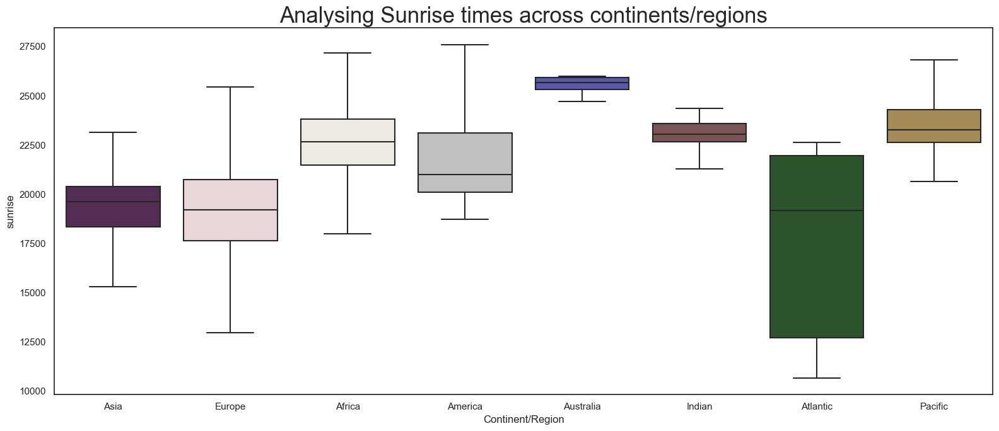

In [1205]:
# Analysing Sunrise across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['sunrise'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Sunrise times across continents/regions',
                                               fontdict = { 'fontsize': 25})

plt.tight_layout()

# Median sunrise time for Australia is most late of all timezones.
# Median sunrise for Atlantic is earliest of all.
# America has the highest most late sunrise time.
# Asia and Europe have the lowest earliest sunrise time.

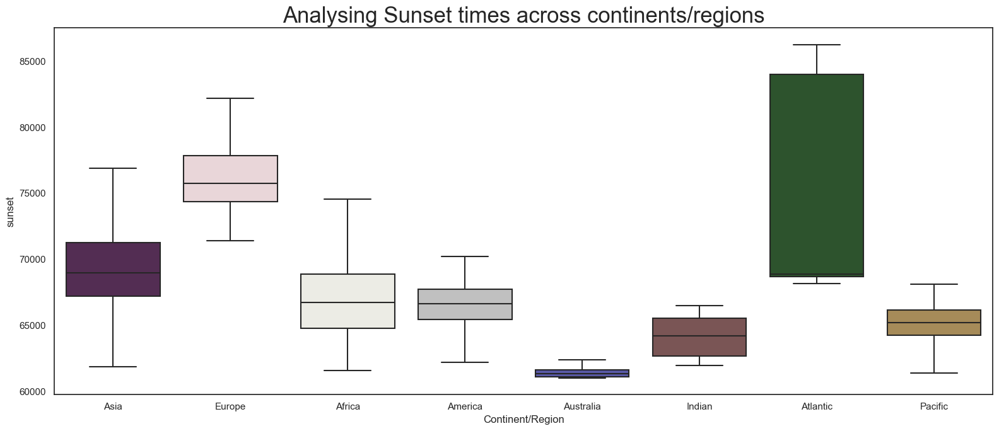

In [944]:
# Analysing Sunset across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['sunset'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Sunset times across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Inference:

# Median sunrise time for Australia region is late than other regions/continents.
# Median sunrise time for Atlantic is earliest of all.
# America has the most late maximum sunrise times.
# Europe and Atlantic have the earliest minimum sunrise times.
# Europe has most dispersed while Australia and Indian have the  least dispersed sunrise times.

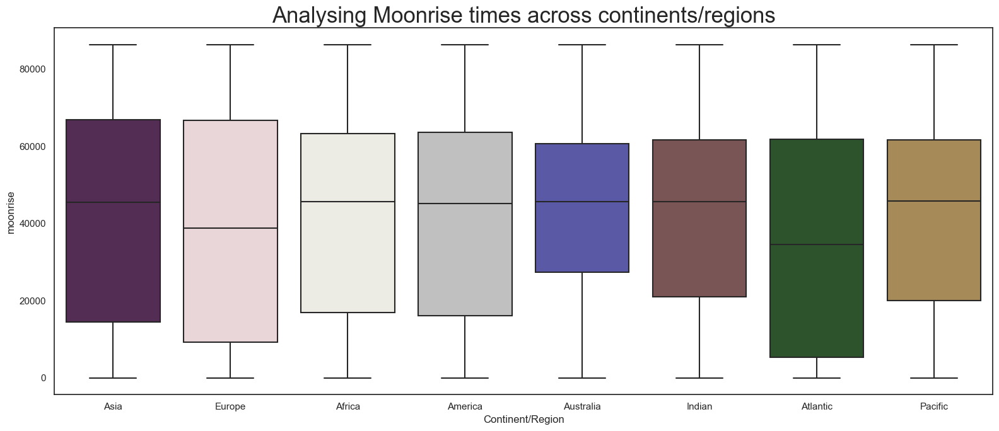

In [945]:
# Analysing Moonrise across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['moonrise'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Moonrise times across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

# Inference:

# 

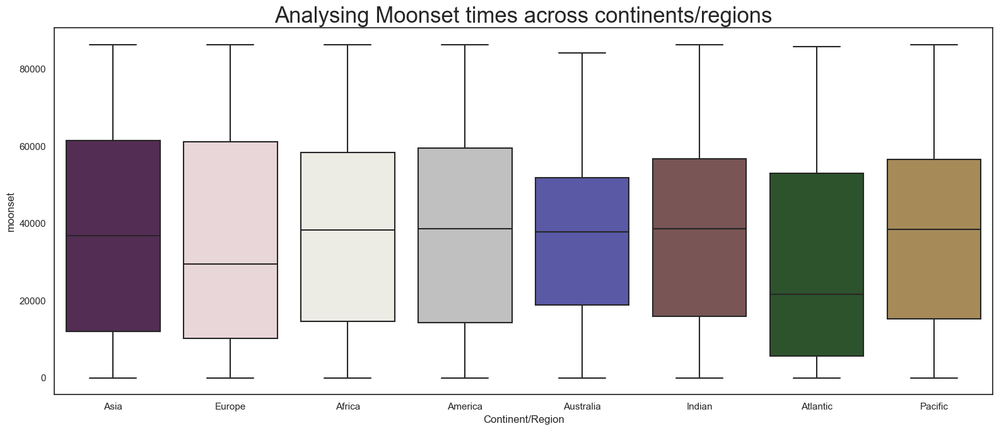

In [946]:
# Analysing Moonset across major timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['moonset'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Moonset times across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

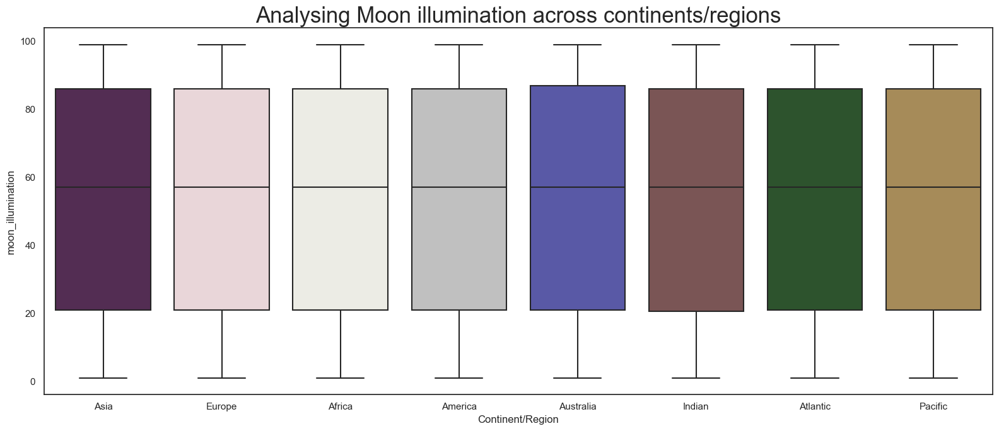

In [947]:
# Analysing Moon Illumination across timezones

my_colors = {'Asia': 'purple', 'Europe': 'pink', 'Africa': 'Beige', 'America': 'Silver',
            'Australia': 'Blue', 'Indian': 'brown', 'Atlantic': 'green', 'Pacific': 'Orange'}

fig, my_ax = plt.subplots(figsize=(16, 7))

# Boxplot
sns.boxplot(x = df_new['Continent/Region'], y = df_new['moon_illumination'], 
            showfliers=False,
            palette=my_colors, 
            saturation=0.3, ax=my_ax).set_title('Analysing Moon illumination across continents/regions',
                                               fontdict = { 'fontsize': 25})
plt.tight_layout()

In [ ]:
# Relation between country/location and temperature

In [178]:
df_mean_temp_hottest_10 = df_new.groupby('country').agg({'temperature_celsius': 'mean', 'latitude': 'mean'}).sort_values(by='temperature_celsius', ascending=False).head(10)

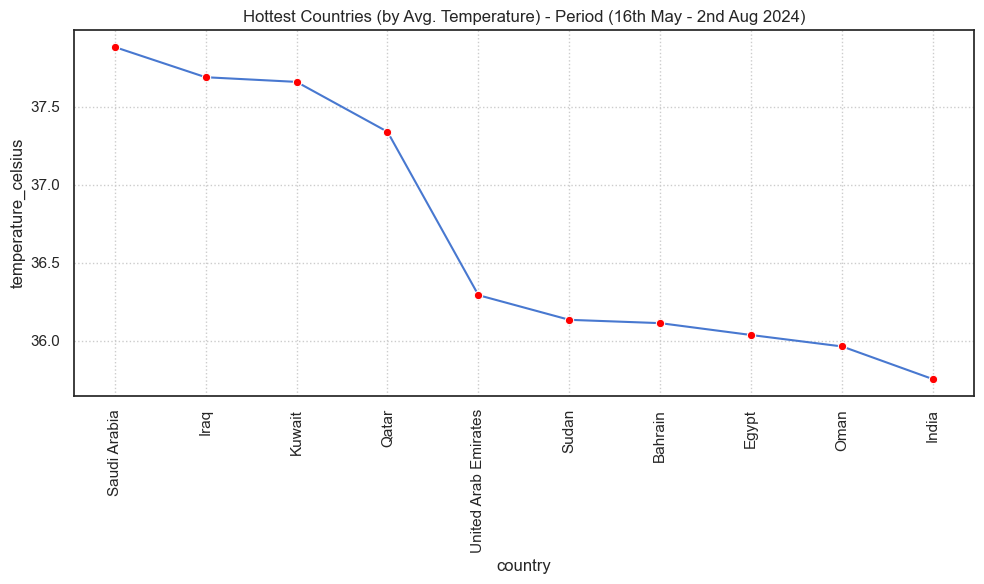

In [181]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_temp_hottest_10, x='country', y='temperature_celsius',
            marker='o',markerfacecolor='red',ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Hottest Countries (by Avg. Temperature) - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The hottest countries are majorly in middle east, African and Indian sub-continent and
## and they have average temperatures varying from 36 to 38 degree celsius.
## All these countries are fairly near to the equator and..
## lie at a latitude from 14 to 33 degrees North of equator.

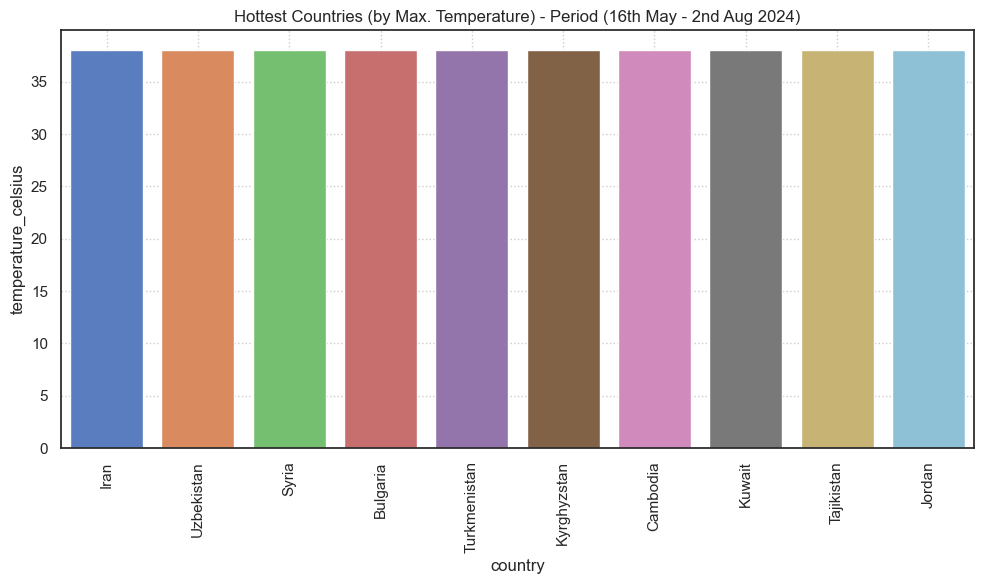

In [182]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_max_temp_hottest_10, x='country', y='temperature_celsius',
            ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Hottest Countries (by Max. Temperature) - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The hottest countries by max. temperatures are majorly in Middle east, Southern Europe and South East Asian countries and
## and they have average temperatures varying from 36 to 38 degree celsius.
## All these countries are fairly near to the equator and..
## lie at a latitude from 14 to 33 degrees North of equator.

In [183]:
df_mean_temp_coldest_10 = df_new.groupby('country').agg({'temperature_celsius': 'mean', 'latitude': 'mean'}).sort_values(by='temperature_celsius', ascending=True).head(10)
df_mean_temp_coldest_10
df_mean_temp_coldest_10 = df_mean_temp_coldest_10.reset_index(drop=False)

In [184]:
df_mean_temp_coldest_10

,country,temperature_celsius,latitude
0,Chile,13.035000,-24.650
1,Iceland,13.035000,53.900
2,Australia,13.047532,-24.650
3,New Zealand,13.134870,-24.650
4,United States of America,13.372067,47.666
5,Colombia,13.500000,4.600
6,Uruguay,13.867857,-24.650
7,Ecuador,13.913182,-0.220
8,Bhutan,14.068684,27.480
9,Argentina,14.076645,-24.650


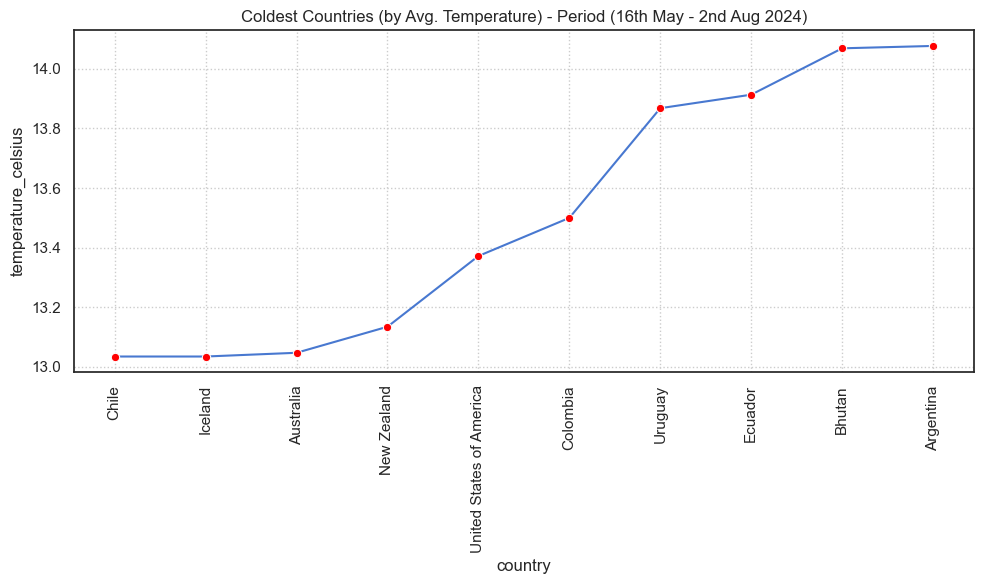

In [186]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_temp_coldest_10, x='country', y='temperature_celsius',
             marker='o',markerfacecolor='red', ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Coldest Countries (by Avg. Temperature) - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The coldest countries are majorly in South America, America, Autralia and Northernmost Europe and
## and they have average temperatures varying from 13 to 14 degree celsius.
## This could be attributed to geolocation of most of these countries at a 
## high altitude of 45 to 55 degrees North of equator. (Approaching towards North pole)
## Or their presence in southern hemisphere (Approaching towards South pole).

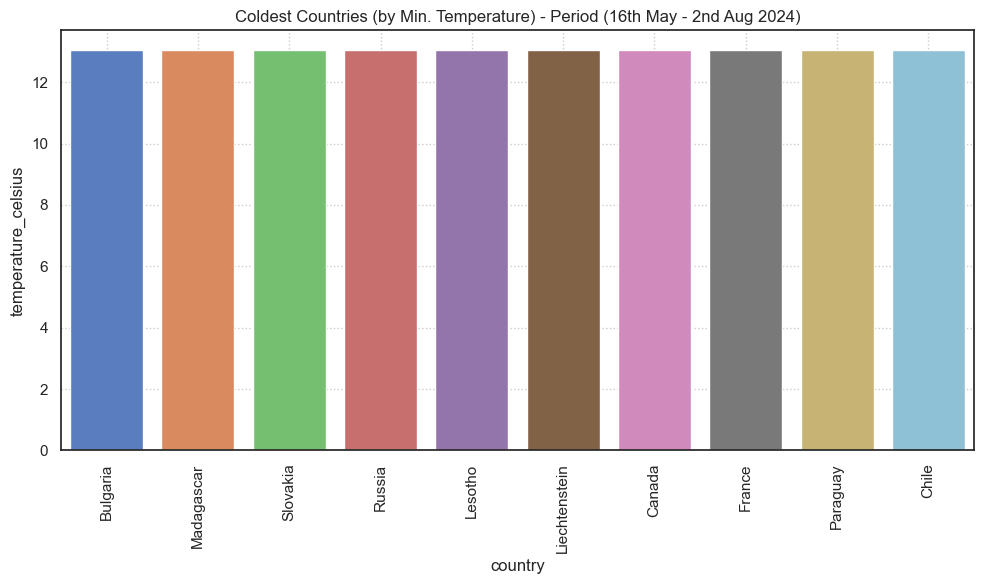

In [187]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_min_temp_coldest_10, x='country', y='temperature_celsius',
            ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Coldest Countries (by Min. Temperature) - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The coldest countries by minimum temperature are majorly in North/South America, Russia and Northernmost Europe and
## and they have temperatures touching 13 degree celsius.
## This could be attributed to geolocation of most of these countries at a 
## high altitude of 45 to 49 degrees North of equator. (Approaching towards North pole)
## Or their presence in southern hemisphere (Approaching towards South pole).

In [823]:
# Relation between location and precipitation

In [188]:
df_mean_high_precip_20_loc = df_new.groupby('location_name').agg({'precip_mm': 'mean', 'latitude': 'mean'}).sort_values(by='precip_mm', ascending=False).head(20)
df_mean_high_precip_20_loc = df_mean_high_precip_20_loc.reset_index(drop=False)

df_mean_low_precip_20_loc = df_new.groupby('location_name').agg({'precip_mm': 'mean', 'latitude': 'mean'}).sort_values(by='precip_mm', ascending=True).head(20)
df_mean_low_precip_20_loc = df_mean_low_precip_20_loc.reset_index(drop=False)

In [189]:
df_mean_high_precip_20_loc 

# Found a location with erroneous name - 'Nan'. It's actually not a missing value but an actual text - Nan.
# It can be replaced with location name deduced from Timezone.

,location_name,precip_mm,latitude
0,Ivory Ivory Ban,0.910000,4.63
1,Palau,0.910000,7.50
2,Vientiane,0.910000,17.97
3,Douala,0.900000,4.05
4,Bafoussam,0.557222,5.47
5,Georgetown,0.540779,6.80
6,Freetown,0.527333,8.49
7,Ngaoundere,0.500000,7.32
8,Colombo,0.463816,6.93
9,Yangon,0.410750,16.78


In [192]:
df_new[df_new['location_name'] == 'Nan'] # Found 76 such locations and they need to be replaced with Bangkok.

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time,Continent/Region
97,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-05-16 15:45:00,33.0,Patchy light rain with thunder,6.9,340.0,...,1.0,05:43 AM,06:44 PM,12:50 PM,01:10 AM,Waxing Gibbous,55.0,2024-05-16,15:45:00,Asia
292,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-05-16 21:00:00,27.0,Clear,2.2,252.0,...,1.0,05:43 AM,06:44 PM,12:50 PM,01:10 AM,Waxing Gibbous,55.0,2024-05-16,21:00:00,Asia
487,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-05-17 23:00:00,26.9,Patchy rain nearby,2.2,149.0,...,1.0,05:42 AM,06:45 PM,01:39 PM,01:43 AM,Waxing Gibbous,64.0,2024-05-17,23:00:00,Asia
679,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-05-18 21:30:00,32.0,Partly Cloudy,3.8,210.0,...,1.0,05:42 AM,06:45 PM,02:26 PM,02:15 AM,Waxing Gibbous,73.0,2024-05-18,21:30:00,Asia
873,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-05-19 21:15:00,31.0,Partly Cloudy,2.2,17.0,...,1.0,05:42 AM,06:45 PM,03:13 PM,02:45 AM,Waxing Gibbous,81.0,2024-05-19,21:15:00,Asia
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14011,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-07-28 19:45:00,25.4,Light rain shower,4.0,208.0,...,1.0,05:53 AM,06:54 PM,No moonrise,12:29 PM,Last Quarter,51.0,2024-07-28,19:45:00,Asia
14205,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-07-29 19:15:00,24.9,Light rain shower,4.3,196.0,...,1.0,05:53 AM,06:53 PM,12:05 AM,01:30 PM,Waning Crescent,40.0,2024-07-29,19:15:00,Asia
14400,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-07-30 19:15:00,23.6,Light rain shower,2.2,163.0,...,1.0,05:54 AM,06:53 PM,12:51 AM,02:31 PM,Waning Crescent,30.0,2024-07-30,19:15:00,Asia
14595,Thailand,Nan,18.78,100.78,Asia/Bangkok,2024-07-31 19:15:00,22.8,Light rain shower,2.7,160.0,...,1.0,05:54 AM,06:52 PM,01:42 AM,03:33 PM,Waning Crescent,20.0,2024-07-31,19:15:00,Asia


In [193]:
df_new['location_name'] = df_new['location_name'].replace('Nan','Bangkok')

In [194]:
# Repeating the operation again post treatment of Nan location name.

df_mean_high_precip_20_loc = df_new.groupby('location_name').agg({'precip_mm': 'mean', 'latitude': 'mean'}).sort_values(by='precip_mm', ascending=False).head(20)
df_mean_high_precip_20_loc = df_mean_high_precip_20_loc.reset_index(drop=False)

In [195]:
df_mean_high_precip_20_loc

,location_name,precip_mm,latitude
0,Ivory Ivory Ban,0.910000,4.63
1,Vientiane,0.910000,17.97
2,Palau,0.910000,7.50
3,Douala,0.900000,4.05
4,Bafoussam,0.557222,5.47
5,Georgetown,0.540779,6.80
6,Freetown,0.527333,8.49
7,Ngaoundere,0.500000,7.32
8,Colombo,0.463816,6.93
9,Yangon,0.410750,16.78


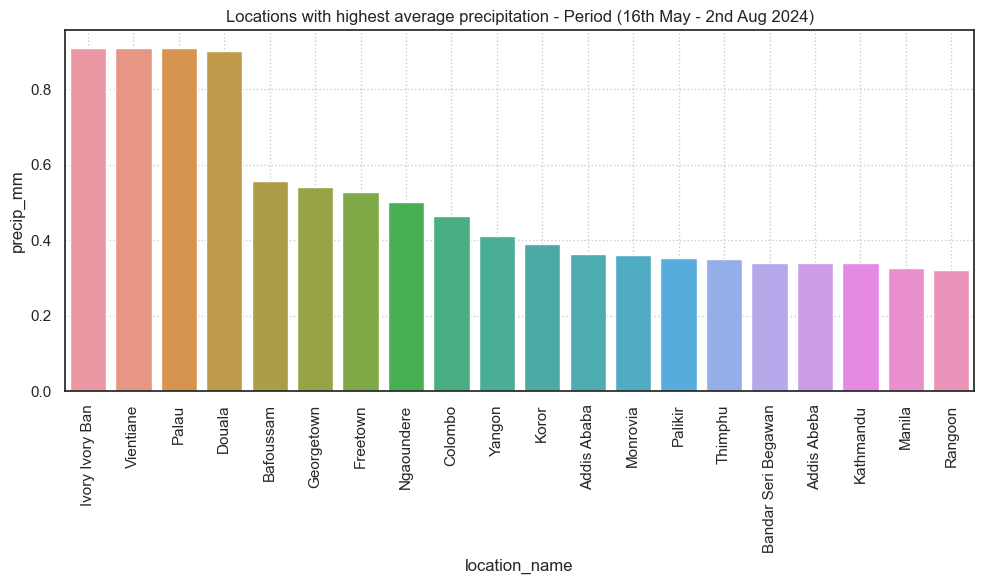

In [196]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_mean_high_precip_20_loc, x=df_mean_high_precip_20_loc['location_name'], y=df_mean_high_precip_20_loc['precip_mm'], ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Locations with highest average precipitation - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Ivory Ivory Ban, Vientiane and Palau are locations with highest average precipitation level.
# No accurate reason for such as latitude doesn't impact precipitation level (As found from our latitude-precipiation correlation).

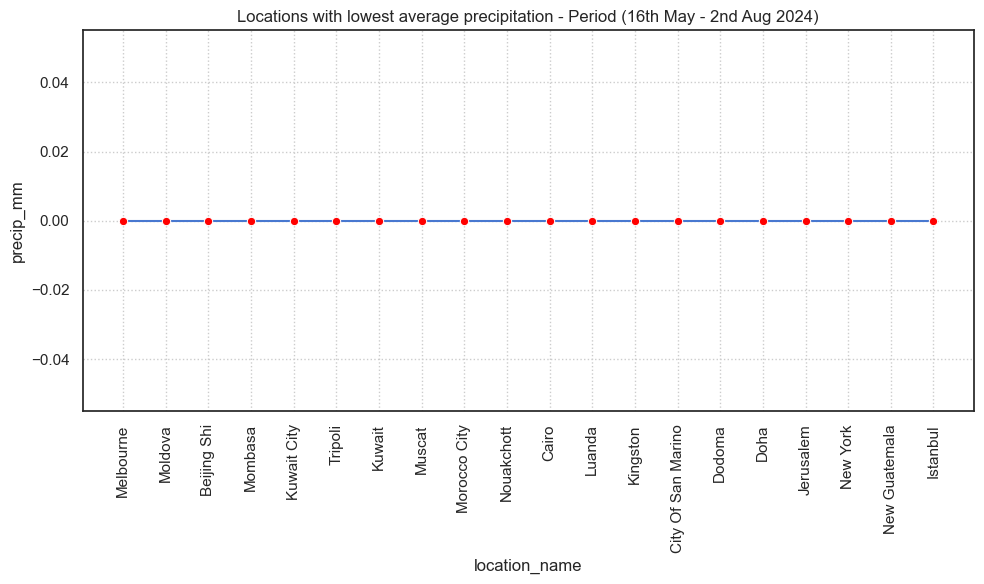

In [197]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_low_precip_20_loc, x=df_mean_low_precip_20_loc['location_name'], y=df_mean_low_precip_20_loc['precip_mm'], ax=my_ax,
            marker='o', markerfacecolor='red')
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Locations with lowest average precipitation - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Melbourne, Moldova and Istanbul etc. are locations with lowest average precipitation level.

In [ ]:
# Relation between country and UV Index

In [198]:
df_mean_high_uv_index_20_country = df_new.groupby(['latitude','country']).agg({'uv_index': 'mean'}).sort_values(by='uv_index',ascending=False).head(20)
df_mean_high_uv_index_20_country = df_mean_high_uv_index_20_country.reset_index(drop=False)
df_mean_high_uv_index_20_country

,latitude,country,uv_index
0,37.70,Turkmenistan,9.000000
1,31.63,Morocco,9.000000
2,-4.26,Congo,8.921053
3,-4.30,Democratic Republic of Congo,8.906667
4,24.64,Saudi Arabia,8.896104
5,29.37,Kuwait,8.844156
6,15.59,Sudan,8.802632
7,33.34,Iraq,8.753247
8,25.29,Qatar,8.701299
9,13.52,Niger,8.684211


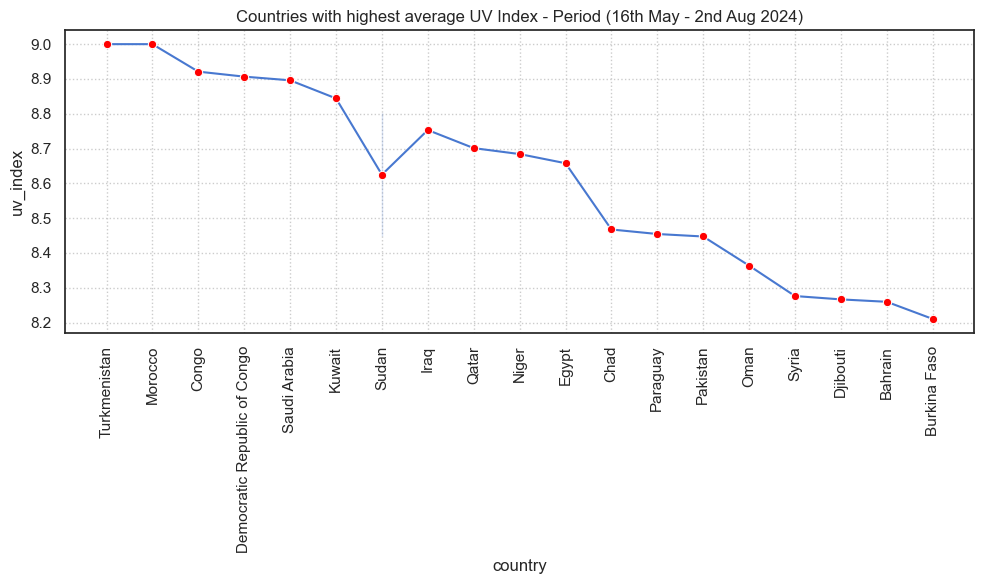

In [199]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_high_uv_index_20_country, x=df_mean_high_uv_index_20_country['country'], y=df_mean_high_uv_index_20_country['uv_index'], ax=my_ax, 
             marker='o', markerfacecolor='red')
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Countries with highest average UV Index - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The highest average UV index (8.2 - 9) is majorly in Middle east, African and Indian sub-continent and
## This can be attributed to the fact that all these countries are fairly near to the equator and..
## lie at a latitude from -4 (almost at equator) to 37 degrees North of equator.
## However, there are exceptions - eg:- Paraguay which is in southern hemisphere in America (-21 degree south).
## This implies there are other factors additional to latitude which impacts the UV index.

In [200]:
df_mean_low_uv_index_20_country = df_new.groupby(['latitude','country']).agg({'uv_index': 'mean'}).sort_values(by='uv_index',ascending=True).head(20)
df_mean_low_uv_index_20_country = df_mean_low_uv_index_20_country.reset_index(drop=False)
df_mean_low_uv_index_20_country

,latitude,country,uv_index
0,-9.46,Papua New Guinea,1.0
1,-18.13,Fiji Islands,1.0
2,-7.25,Indonesia,1.0
3,10.75,Vietnam,1.0
4,-8.52,Tuvalu,1.0
5,7.50,USA United States of America,1.0
6,-21.13,Tonga,1.0
7,-13.83,Samoa,1.0
8,7.36,Palau,1.0
9,17.97,Lao People's Democratic Republic,1.0


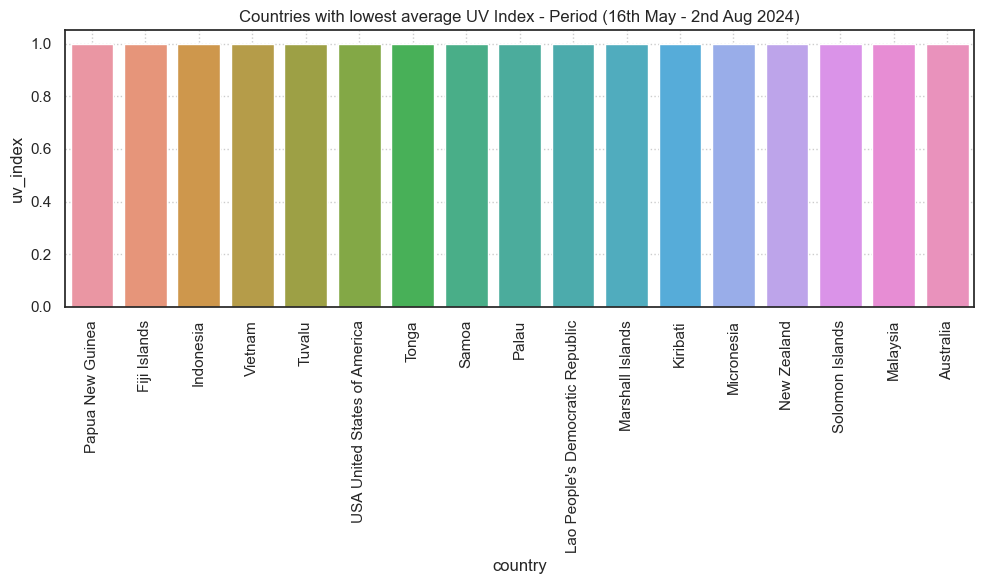

In [201]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_mean_low_uv_index_20_country, x=df_mean_low_uv_index_20_country['country'], y=df_mean_low_uv_index_20_country['uv_index'], ax=my_ax)

plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Countries with lowest average UV Index - Period (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The lowest average UV index (1.00) is majorly in Australian subcontinent, African and South East Asian sub-continent and
## This can be attributed to the fact that most of these countries lie in southern hemisphere (-24 to -7 degree south).
## However, there are exceptions - eg:- Palau, Mrashall Islands and Vietnam which are in northern hemisphere and near to the equator.
## This implies there are other factors additional to latitude which impacts the UV index.

In [ ]:
# Relation between country/location and Pressure

In [202]:
df_mean_high_pressure_20_locations = df_new.groupby(['latitude','location_name']).agg({'pressure_mb': 'mean'}).sort_values(by='pressure_mb',ascending=False).head(20).reset_index(drop=False)
df_mean_high_pressure_20_locations

,latitude,location_name,pressure_mb
0,-23.53,Sao Paulo,1022.000000
1,19.43,Mexico City,1020.723684
2,-24.65,Pretoria,1020.688312
3,-18.92,Antananarivo,1020.363636
4,-24.65,Asuncion,1020.000000
5,14.62,New Guatemala,1020.000000
6,-24.65,Maseru,1019.947368
7,-1.28,Nairobi,1019.792208
8,-22.57,Windhoek,1019.605263
9,-24.65,Gaborone,1019.402597


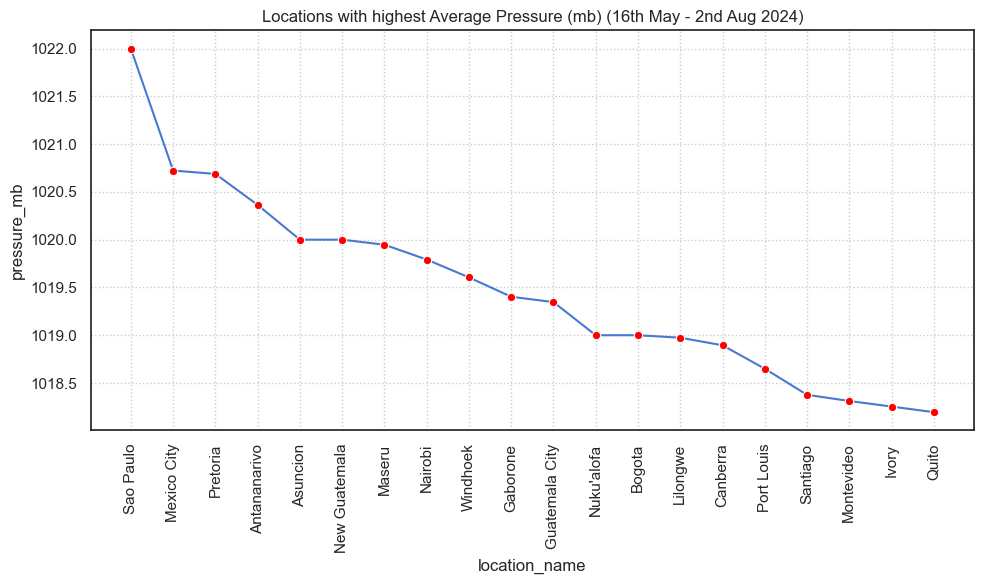

In [673]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_high_pressure_20_locations, 
            x=df_mean_high_pressure_20_locations['location_name'], 
            y=df_mean_high_pressure_20_locations['pressure_mb'], 
            ax=my_ax,
            marker='o',
            markerfacecolor='red')

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Locations with highest Average Pressure (mb) (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The pressure is higher at poles (North & South) than equator and majorly in Southern hemisphere.
## Some exceptions - Bogota (Columbia) is near to the equator but still the pressure is high.
## It implies presence of other factors that influences pressure.

In [204]:
df_mean_low_pressure_20_locations = df_new.groupby(['latitude','location_name']).agg({'pressure_mb': 'mean'}).sort_values(by='pressure_mb',ascending=True).head(20).reset_index(drop=False)
df_mean_low_pressure_20_locations

,latitude,location_name,pressure_mb
0,29.37,Kuwait,1000.000000
1,24.64,Ar Riyadh,1000.000000
2,37.70,Krasnyy Turkmenistan,1000.000000
3,28.60,New Delhi,1000.421053
4,33.70,Islamabad,1000.434211
5,23.61,Muscat,1000.558442
6,24.47,Abu Dhabi,1000.701299
7,23.72,Dhaka,1000.894737
8,29.37,Kuwait City,1000.921053
9,25.29,Doha,1000.987013


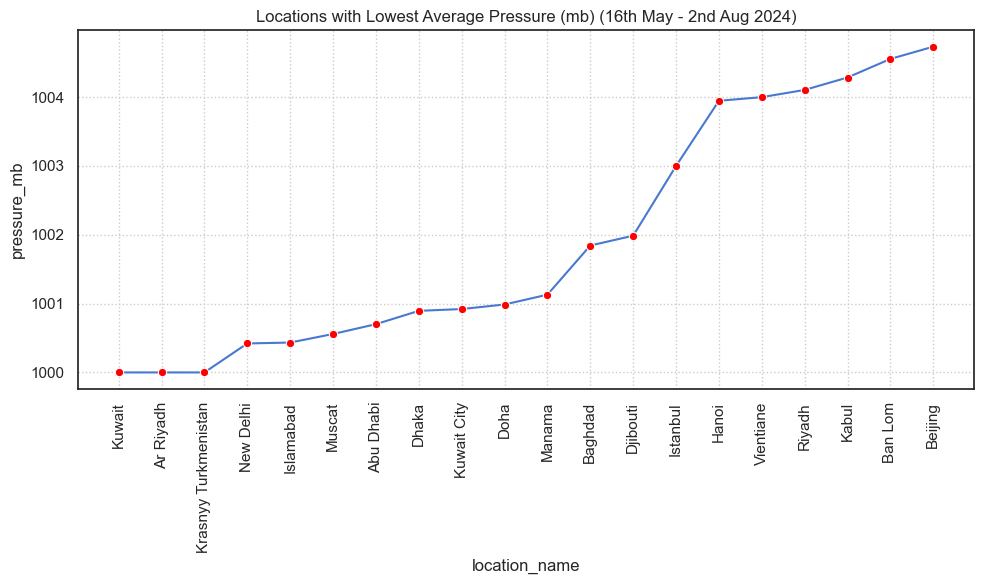

In [672]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_low_pressure_20_locations, 
            x=df_mean_low_pressure_20_locations['location_name'], 
            y=df_mean_low_pressure_20_locations['pressure_mb'], 
            ax=my_ax,
            marker='o',
            markerfacecolor='red')

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Locations with Lowest Average Pressure (mb) (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The pressure is lowest majorly in Middle Eastern, Indian and South East Asian subcontinent.
## All these locations are in Northern hemisphere with average latitude between 11 to 39 degrees North.
## At this latitude interval, the average temperature is maximum 
## which implies that pressure decreases as temperature increases.
## which proves our hypothesis - The pressure is higher at poles (North & South) 
## and lowest near the equator upto 39 degrees North.

In [ ]:
# Relation between country/location and Humidity

In [1317]:
df_mean_low_humidity_20_locations = df_new.groupby(['latitude','location_name']).agg({'humidity': 'mean'}).sort_values(by='humidity',ascending=True).head(20).reset_index(drop=False)
df_mean_low_humidity_20_locations

,latitude,location_name,humidity
0,24.64,Riyadh,15.000000
1,24.64,Ar Riyadh,15.000000
2,31.63,Morocco City,15.000000
3,37.70,Krasnyy Turkmenistan,15.000000
4,33.34,Baghdad,15.363636
5,29.37,Kuwait,16.000000
6,33.50,Damascus,17.750000
7,29.37,Kuwait City,18.302632
8,35.73,Tehran,18.480519
9,-22.57,Windhoek,18.710526


In [ ]:
# Relation between country/location and windspeed

In [1321]:
df_mean_low_windspeed_20_locations = df_new.groupby(['latitude','location_name']).agg({'wind_mph': 'mean'}).sort_values(by='wind_mph',ascending=True).head(20).reset_index(drop=False)
df_mean_low_windspeed_20_locations

,latitude,location_name,wind_mph
0,9.03,Addis Abeba,2.200000
1,27.48,Thimphu,2.663158
2,4.60,Bogota,2.900000
3,39.93,Beijing Shi,2.900000
4,21.13,Ban Lom,2.959259
5,33.78,Grenada,3.100000
6,3.17,Kuala Lumpur,3.307792
7,-11.18,National,3.375000
8,13.71,San Salvador,3.458667
9,4.88,Bandar Seri Begawan,3.461842


In [1320]:
df_mean_low_air_carbon_monoxide_20_locations = df_new.groupby(['latitude','location_name']).agg({'air_quality_Carbon_Monoxide': 'mean'}).sort_values(by='air_quality_Carbon_Monoxide',ascending=False).head(20).reset_index(drop=False)
df_mean_low_air_carbon_monoxide_20_locations

,latitude,location_name,air_quality_Carbon_Monoxide
0,17.97,Vientiane,1281.700000
1,3.17,Kuala Lumpur,1281.700000
2,10.75,Ho Chi Minh City,1281.700000
3,-6.21,Jakarta,1281.700000
4,-24.65,Santiago,1278.059740
5,-0.22,Quito,1193.361039
6,14.60,Kiyabo,1188.300000
7,13.75,Bangkok,1181.936000
8,21.03,Hanoi,1143.022368
9,33.70,Islamabad,1134.369737


In [ ]:
# Analysing Wind Direction & Wind Degree

In [206]:
df_mean_high_wind_degree_20 = df_new.groupby(['wind_direction','Continent/Region']).agg({'wind_degree': 'mean'}).sort_values(by='wind_degree',ascending=False).head(20).reset_index(drop=False)
df_mean_high_wind_degree_20

,wind_direction,Continent/Region,wind_degree
0,NNW,Atlantic,340.000000
1,NNW,Indian,340.000000
2,NNW,America,336.435644
3,NNW,Europe,335.288793
4,NNW,Australia,335.166667
5,NNW,Asia,335.061776
6,NNW,Africa,334.463576
7,NNW,Pacific,332.500000
8,NW,Australia,315.200000
9,NW,America,315.078125


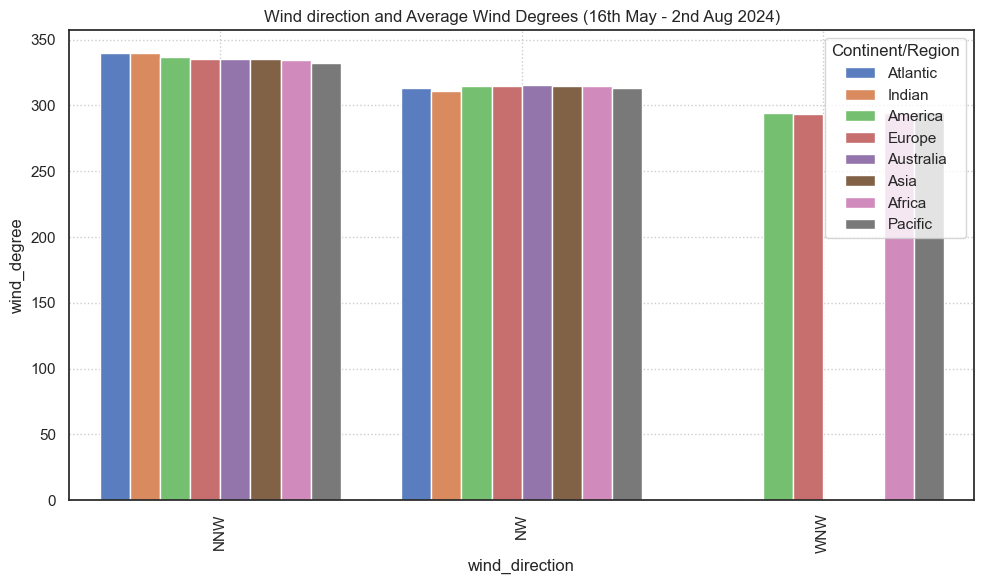

In [207]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_mean_high_wind_degree_20, 
            y=df_mean_high_wind_degree_20['wind_degree'], 
            x=df_mean_high_wind_degree_20['wind_direction'],
            hue=df_mean_high_wind_degree_20['Continent/Region'],
            ax=my_ax,)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Wind direction and Average Wind Degrees (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Winds are higher in north/north north western/north western regions.
# Atlantic tops the list with 340 wind degree NNW.
# Within the same wind direction, the wind degree might slightly vary
# as it could also depend on the latitude of the location.

In [208]:
df_mean_low_wind_degree_20 = df_new.groupby(['wind_direction','Continent/Region']).agg({'wind_degree': 'mean'}).sort_values(by='wind_degree',ascending=True).head(20).reset_index(drop=False)
df_mean_low_wind_degree_20

,wind_direction,Continent/Region,wind_degree
0,N,Indian,17.000000
1,NNE,Indian,22.666667
2,NNE,Australia,23.000000
3,NNE,Africa,23.508772
4,NNE,Europe,23.520231
5,NNE,Asia,23.733728
6,NNE,America,24.066265
7,NNE,Pacific,25.545455
8,NNE,Atlantic,25.636364
9,NE,Australia,40.000000


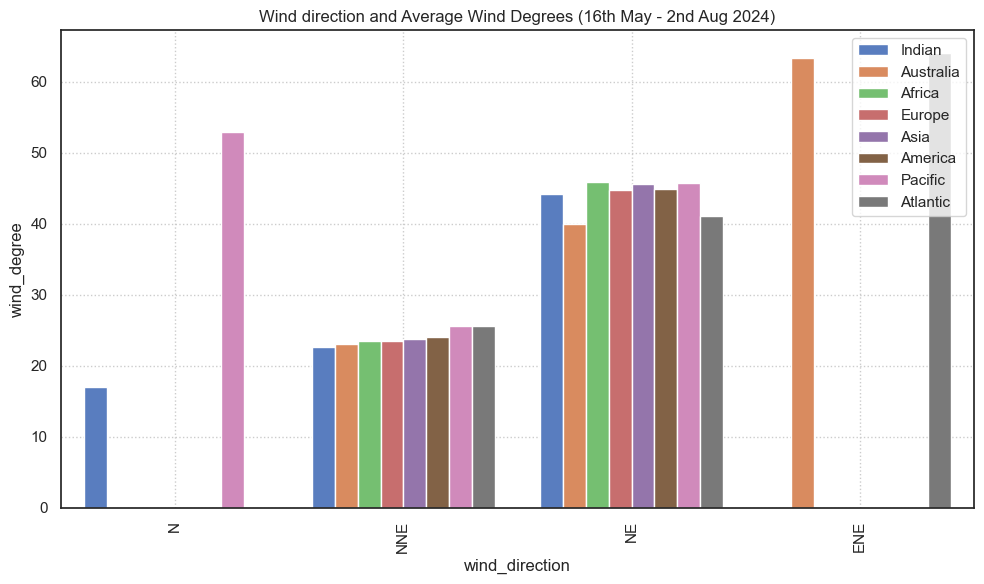

In [209]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.barplot(data = df_mean_low_wind_degree_20, 
            y=df_mean_low_wind_degree_20['wind_degree'], 
            x=df_mean_low_wind_degree_20['wind_direction'],
            hue=df_mean_low_wind_degree_20['Continent/Region'],
            ax=my_ax,)

plt.legend(loc='upper right')
plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Wind direction and Average Wind Degrees (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Wind degrees are lower in north/north north eastern regions.
# Indian subcontinent has the lowest wind degree - 17 wind degree NNW.

In [210]:
df_mean_winddegree = df_new.groupby(['wind_direction']).agg({'wind_degree': 'mean'}).sort_values(by='wind_degree',ascending=False).reset_index(drop=False)

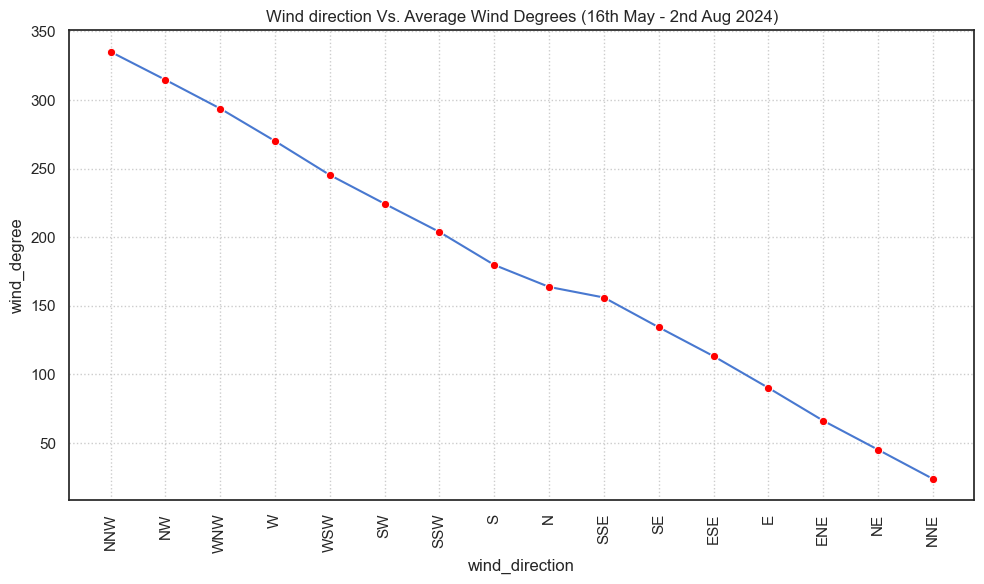

In [211]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_winddegree, 
            y=df_mean_winddegree['wind_degree'], 
            x=df_mean_winddegree['wind_direction'],
            marker='o',
            markerfacecolor='red',
            ax=my_ax,)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Wind direction Vs. Average Wind Degrees (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Wind Degree drastically decreases as the wind direction shifts from NNW to NNE.

In [ ]:
# Analysing Wind Direction & Wind Speed

In [212]:
df_mean_wind_speed = df_new.groupby(['wind_direction']).agg({'wind_mph': 'mean'}).sort_values(by='wind_mph',ascending=False).reset_index(drop=False)
df_mean_wind_speed

,wind_direction,wind_mph
0,WNW,9.643389
1,W,9.605037
2,NW,9.295039
3,E,9.216438
4,SW,9.047862
5,NNW,8.899870
6,WSW,8.774598
7,SSW,8.773146
8,ESE,8.577037
9,NNE,8.397911


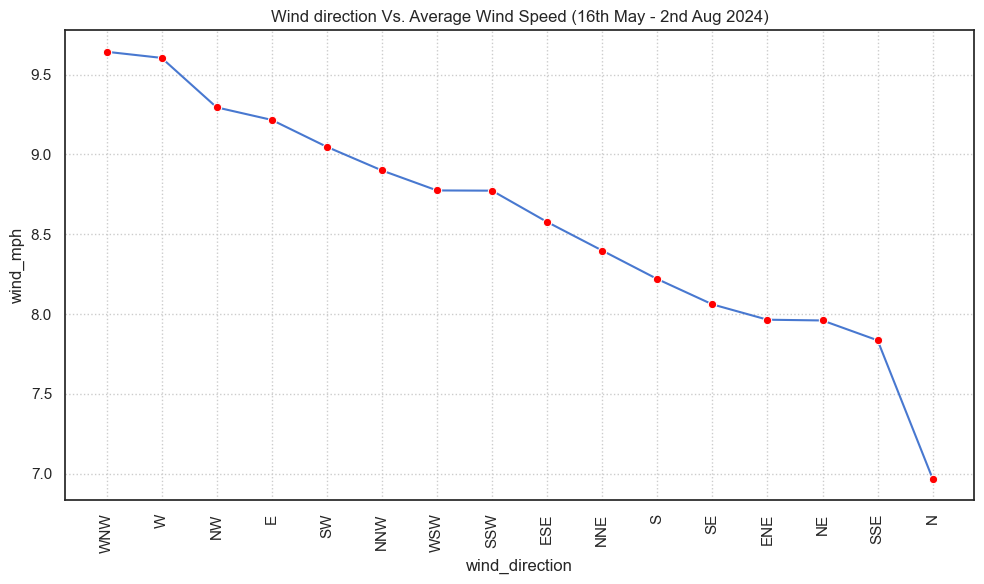

In [213]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mean_wind_speed, 
            y=df_mean_wind_speed['wind_mph'], 
            x=df_mean_wind_speed['wind_direction'],
            marker='o',
            markerfacecolor='red',
            ax=my_ax,)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Wind direction Vs. Average Wind Speed (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Wind Speed is highest at WNW direction and lowest at North.
# But no patterns or correlation could be found between wind speed and direction.

In [ ]:
# Analysing latitude and sunrise/set and moonrise/set timings

In [949]:
# pd.to_datetime(df['moonrise'])  ## Found some values - 'No moonrise' in moonrise attribute
# pd.to_datetime(df['moonset'])   ## Found some values - 'No moonset' in moonset attribute

In [214]:
df_new[df_new['moonrise'] == 'No moonrise'] 

# There is no moonrise in some locations in Europe, Russian subcontinent and Scandinavian countries etc.

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time,Continent/Region
1632,Iceland,Grindavik,53.90,-22.43,Atlantic/Reykjavik,2024-05-23 14:00:00,13.035,Partly Cloudy,13.6,150.0,...,1.0,03:53 AM,11:03 PM,No moonrise,03:01 AM,Full Moon,99.0,2024-05-23,14:00:00,Atlantic
1806,Estonia,Tallinn,53.90,24.73,Europe/Tallinn,2024-05-24 17:30:00,21.000,Partly Cloudy,10.5,320.0,...,1.0,04:28 AM,10:09 PM,No moonrise,03:55 AM,Waning Gibbous,99.0,2024-05-24,17:30:00,Europe
1810,Finland,Helsinki,53.90,24.93,Europe/Helsinki,2024-05-24 17:30:00,26.000,Sunny,9.4,170.0,...,1.0,04:21 AM,10:15 PM,No moonrise,03:44 AM,Waning Gibbous,99.0,2024-05-24,17:30:00,Europe
1844,Latvia,Riga,53.90,24.10,Europe/Riga,2024-05-24 17:30:00,28.000,Sunny,13.6,180.0,...,1.0,04:49 AM,09:53 PM,No moonrise,04:26 AM,Waning Gibbous,99.0,2024-05-24,17:30:00,Europe
1880,Norway,Oslo,53.90,10.75,Europe/Oslo,2024-05-24 16:30:00,22.000,Partly Cloudy,5.6,230.0,...,1.0,04:20 AM,10:09 PM,No moonrise,03:45 AM,Waning Gibbous,99.0,2024-05-24,16:30:00,Europe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14585,Kazakhstan,Astana,51.18,71.43,Asia/Almaty,2024-07-31 17:15:00,32.000,Partly Cloudy,8.7,285.0,...,1.0,04:38 AM,08:02 PM,No moonrise,05:44 PM,Waning Crescent,20.0,2024-07-31,17:15:00,Asia
14641,Russia,Moscow,53.90,37.62,Europe/Moscow,2024-07-31 15:15:00,19.600,Light rain shower,11.0,295.0,...,1.0,04:33 AM,08:37 PM,No moonrise,06:48 PM,Waning Crescent,20.0,2024-07-31,15:15:00,Europe
14752,Finland,Helsinki,53.90,24.93,Europe/Helsinki,2024-08-01 15:15:00,18.100,Patchy rain nearby,6.5,318.0,...,1.0,05:01 AM,09:51 PM,No moonrise,09:50 PM,Waning Crescent,12.0,2024-08-01,15:15:00,Europe
14822,Norway,Oslo,53.90,10.75,Europe/Oslo,2024-08-01 14:15:00,22.900,Partly Cloudy,5.4,203.0,...,1.0,04:59 AM,09:46 PM,No moonrise,09:42 PM,Waning Crescent,12.0,2024-08-01,14:15:00,Europe


In [215]:
df_new[df_new['moonset'] == 'No moonset'] 

# There is no moonset in some locations in Australia, Indonesia, New Zealand, Scandinavian countries etc.

,country,location_name,latitude,longitude,timezone,last_updated,temperature_celsius,condition_text,wind_mph,wind_degree,...,air_quality_gb-defra-index,sunrise,sunset,moonrise,moonset,moon_phase,moon_illumination,Date,Time,Continent/Region
8,Australia,Canberra,-24.65,147.19,Australia/Sydney,2024-05-16 18:45:00,13.035,Clear,2.5,100.0,...,1.0,06:52 AM,05:07 PM,01:31 PM,No moonset,Waxing Gibbous,55.0,2024-05-16,18:45:00,Australia
92,Indonesia,Laos,-8.18,114.32,Asia/Jakarta,2024-05-16 15:45:00,28.000,Patchy rain nearby,5.6,149.0,...,1.0,05:27 AM,05:11 PM,12:21 PM,No moonset,Waxing Gibbous,55.0,2024-05-16,15:45:00,Asia
117,Mozambique,Maputo,-24.65,32.59,Africa/Maputo,2024-05-16 10:45:00,24.000,Partly Cloudy,5.6,340.0,...,1.0,06:21 AM,05:11 PM,01:14 PM,No moonset,Waxing Gibbous,55.0,2024-05-16,10:45:00,Africa
123,New Zealand,Wellington,-24.65,147.19,Pacific/Auckland,2024-05-16 20:45:00,13.035,Partly Cloudy,18.6,180.0,...,1.0,07:24 AM,05:11 PM,01:57 PM,No moonset,Waxing Gibbous,55.0,2024-05-16,20:45:00,Pacific
189,Vanuatu,Port Vila,-17.73,147.19,Pacific/Efate,2024-05-16 19:45:00,25.000,Partly Cloudy,8.1,120.0,...,1.0,06:05 AM,05:21 PM,12:50 PM,No moonset,Waxing Gibbous,55.0,2024-05-16,19:45:00,Pacific
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12118,Norway,Oslo,53.90,10.75,Europe/Oslo,2024-07-16 14:45:00,14.200,Partly Cloudy,18.6,160.0,...,1.0,04:24 AM,10:21 PM,06:09 PM,No moonset,Waxing Gibbous,69.0,2024-07-16,14:45:00,Europe
12128,Poland,Warsaw,52.25,21.00,Europe/Warsaw,2024-07-16 14:45:00,31.200,Partly Cloudy,12.5,160.0,...,1.0,04:34 AM,08:49 PM,04:29 PM,No moonset,Waxing Gibbous,69.0,2024-07-16,14:45:00,Europe
12271,Kazakhstan,Astana,51.18,71.43,Asia/Almaty,2024-07-17 17:45:00,23.100,Moderate or heavy rain with thunder,11.9,40.0,...,1.0,04:19 AM,08:21 PM,05:09 PM,No moonset,Waxing Gibbous,78.0,2024-07-17,17:45:00,Asia
12327,Russia,Moscow,53.90,37.62,Europe/Moscow,2024-07-17 15:45:00,30.000,Sunny,6.9,60.0,...,1.0,04:09 AM,09:01 PM,06:06 PM,No moonset,Waxing Gibbous,78.0,2024-07-17,15:45:00,Europe


In [216]:
# Replacing 'no moonrise' and 'no moonset' with dummy value - 0.

df_new.replace(['No moonrise', 'No moonset'],0, inplace=True)

In [ ]:
# Analysing latitude Vs Sunrise times

In [228]:
df_lat_mean_sunrise_high = df_new.groupby('latitude').agg({'sunrise': 'mean'}).reset_index(drop=False).sort_values(by='sunrise',ascending=False).head(30)
df_lat_mean_sunrise_high

,latitude,sunrise
3,-23.43,27967.500000
4,-22.57,26879.210526
6,-21.13,26061.818182
0,-24.65,25947.812500
45,3.17,25589.610390
43,1.29,25248.311688
9,-19.04,24632.800000
24,-8.56,24570.400000
2,-23.53,24540.000000
120,23.13,24480.000000


In [229]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_sunrise_high['sunrise'] = df_lat_mean_sunrise_high['sunrise'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

In [231]:
df_lat_mean_sunrise_high

,latitude,sunrise
3,-23.43,07:46 AM
4,-22.57,07:27 AM
6,-21.13,07:14 AM
0,-24.65,07:12 AM
45,3.17,07:06 AM
43,1.29,07:00 AM
9,-19.04,06:50 AM
24,-8.56,06:49 AM
2,-23.53,06:49 AM
120,23.13,06:48 AM


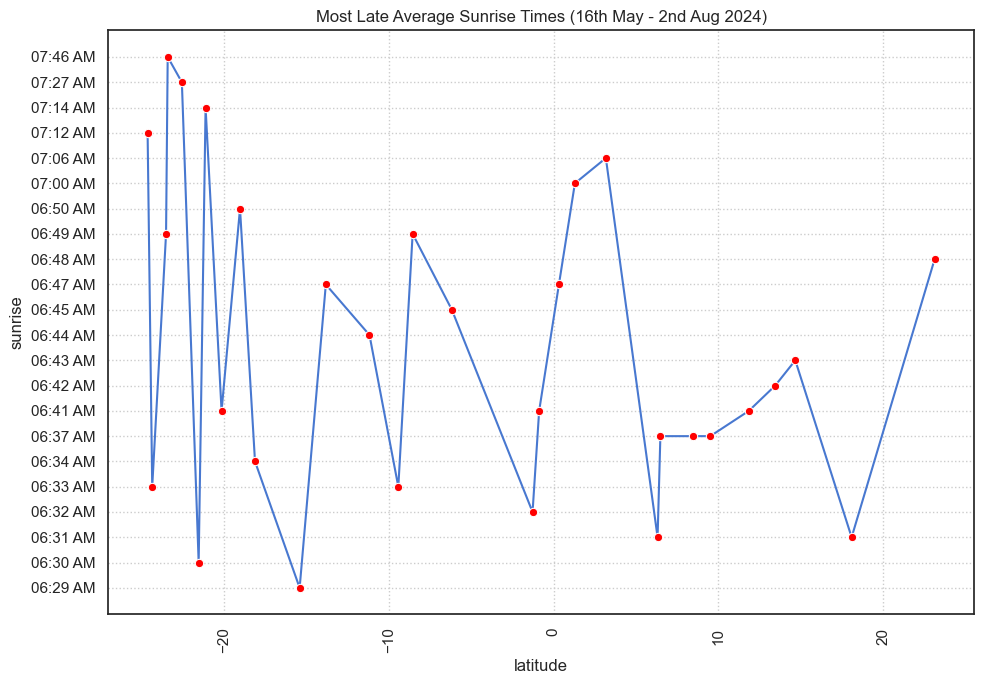

In [671]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_sunrise_high, 
             x=df_lat_mean_sunrise_high['latitude'], 
             y=df_lat_mean_sunrise_high['sunrise'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Most Late Average Sunrise Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Sunrise times are decreasing with increasing latitudes but with significant fluctuations.
# Sunrise time in southern hemisphere is as late as 7.46 AM at latitude between -25 and -20 degrees.
# There shall be other factors which might impact sunrise times than just the latitudes.

In [233]:
df_lat_mean_sunrise_low = df_new.groupby('latitude').agg({'sunrise': 'mean'}).reset_index(drop=False).sort_values(by='sunrise',ascending=True).head(30)
df_lat_mean_sunrise_low

,latitude,sunrise
202,51.18,15030.789474
209,53.90,15655.295630
205,52.25,15993.506494
146,35.69,16295.844156
144,34.52,17204.415584
126,25.29,17284.675325
127,26.24,17395.324675
201,51.12,17400.000000
132,29.37,17629.090909
204,51.52,17702.400000


In [234]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_sunrise_low['sunrise'] = df_lat_mean_sunrise_low['sunrise'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

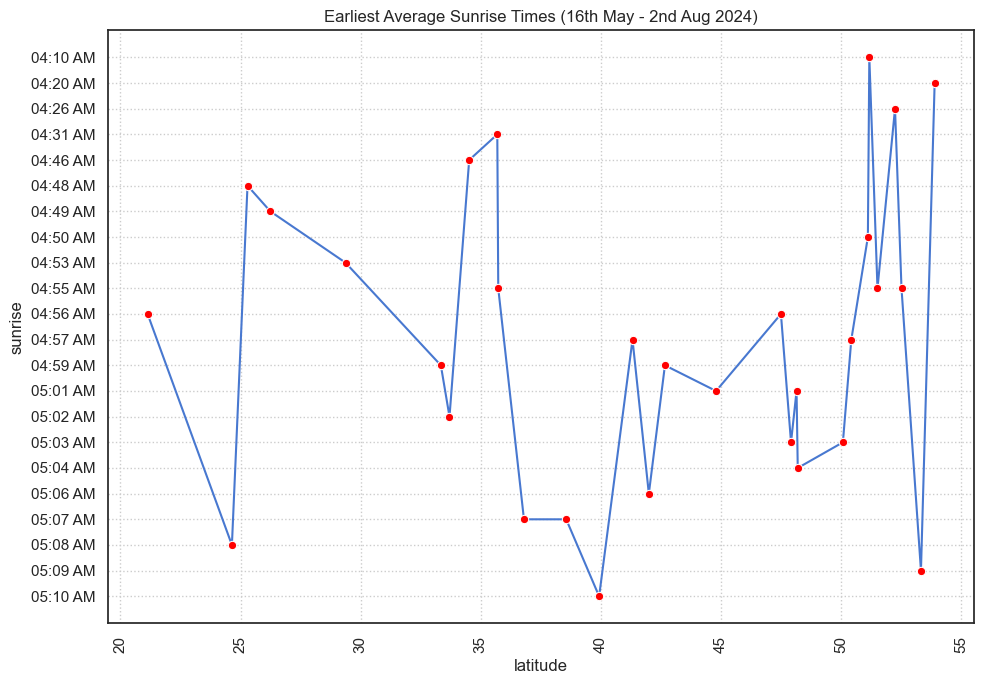

In [670]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_sunrise_low, 
             x=df_lat_mean_sunrise_low['latitude'], 
             y=df_lat_mean_sunrise_low['sunrise'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Earliest Average Sunrise Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Sunrise times are decreasing with increasing latitudes but with significant fluctuations.
# The earliest average sunrises are observed between 50 and 55 degrees North latitude.
# There shall be other factors which might impact sunrise times than just the latitudes.

In [ ]:
# Analysing latitude Vs. sunset times

In [236]:
df_lat_mean_sunset_high = df_new.groupby('latitude').agg({'sunset': 'mean'}).reset_index(drop=False).sort_values(by='sunset',ascending=False).head(30)
df_lat_mean_sunset_high

,latitude,sunset
209,53.90,79161.053985
203,51.25,78989.491525
206,52.37,78857.368421
198,50.83,78477.631579
194,48.87,78460.519481
208,53.33,78193.246753
199,50.88,78123.750000
195,49.61,77744.800000
172,42.50,77230.909091
200,51.10,76980.000000


In [237]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_sunset_high['sunset'] = df_lat_mean_sunset_high['sunset'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

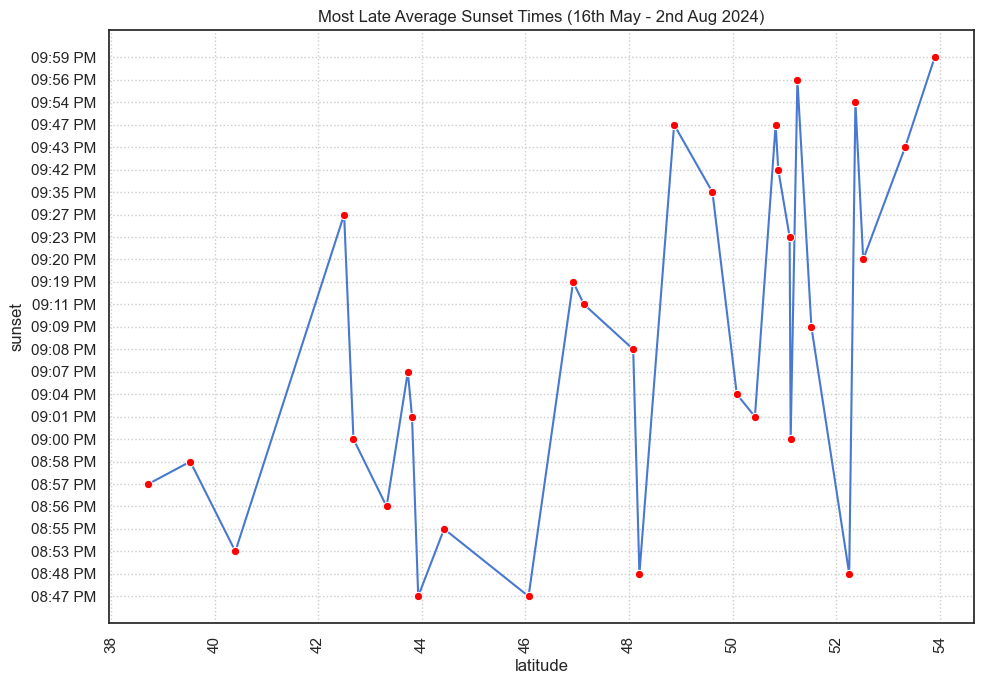

In [669]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_sunset_high, 
             x=df_lat_mean_sunset_high['latitude'], 
             y=df_lat_mean_sunset_high['sunset'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Most Late Average Sunset Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Sunset times are increasing with increasing latitudes but with significant fluctuations.
# The most late average sunsets are observed between 50 and 55 degrees North latitude.
# However, these latitudes observed the earliest sun rises.
# Hence, the places near the north poles eg:- Iceland etc. have longest day span.
# There shall be other factors which might impact sunset times than just the latitudes.

In [239]:
df_lat_mean_sunset_low = df_new.groupby('latitude').agg({'sunset': 'mean'}).reset_index(drop=False).sort_values(by='sunset',ascending=True).head(30)
df_lat_mean_sunset_low

,latitude,sunset
26,-8.18,62116.578947
1,-24.37,62319.200000
27,-7.25,62580.000000
13,-17.73,62596.578947
10,-18.92,62670.389610
5,-21.55,62803.636364
15,-13.98,62880.779221
0,-24.65,62900.000000
2,-23.53,63000.000000
8,-19.45,63084.000000


In [241]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_sunset_low['sunset'] = df_lat_mean_sunset_low['sunset'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

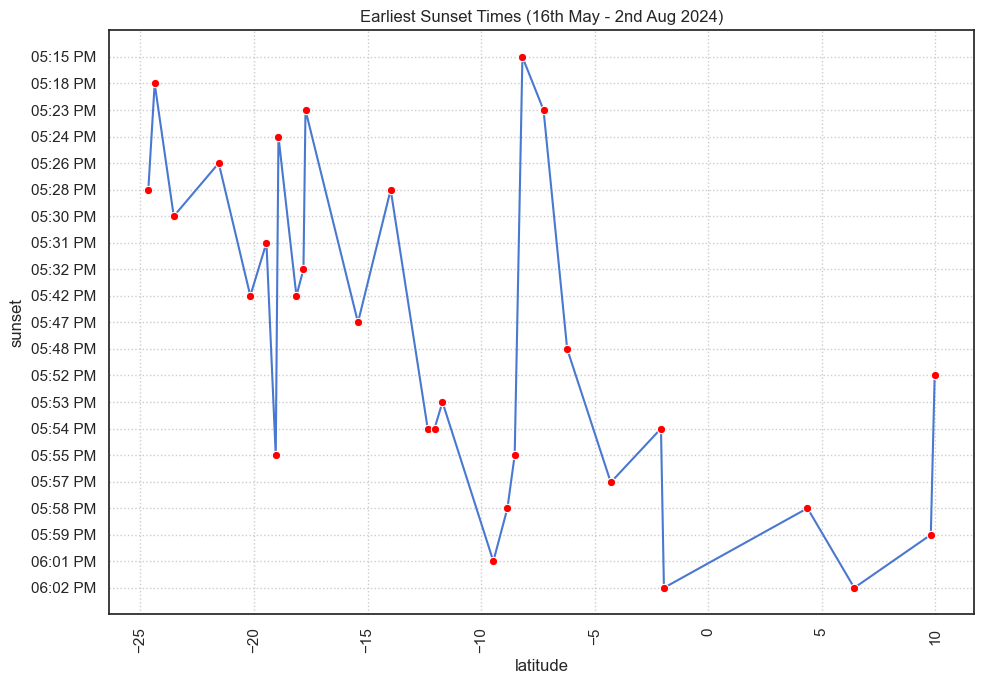

In [668]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_sunset_low, 
             x=df_lat_mean_sunset_low['latitude'], 
             y=df_lat_mean_sunset_low['sunset'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Earliest Sunset Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Sunset times are increasing with increasing latitudes but with significant fluctuations.
# The earliest average sunsets are observed between -25 and -19 degrees South latitude.
# However, these latitudes observed the most late sun rises.
# Hence, the places in Southern hemisphere near the north poles eg:- Australia, Argentina etc. have shortest day span.
# There shall be other factors which might impact sunset times than just the latitudes.

In [ ]:
# Analysing latitude Vs Moonrise times

In [243]:
df_lat_mean_moonrise_high = df_new.groupby('latitude').agg({'moonrise': 'mean'}).reset_index(drop=False).sort_values(by='moonrise',ascending=False).head(30)
df_lat_mean_moonrise_high

,latitude,moonrise
165,40.71,85200.000000
141,33.78,84720.000000
137,32.89,84540.000000
173,42.67,83760.000000
112,18.00,80160.000000
49,4.05,79260.000000
40,-0.14,78540.000000
52,4.60,78540.000000
33,-4.05,78420.000000
58,6.13,77940.000000


In [244]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_moonrise_high['moonrise'] = df_lat_mean_moonrise_high['moonrise'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

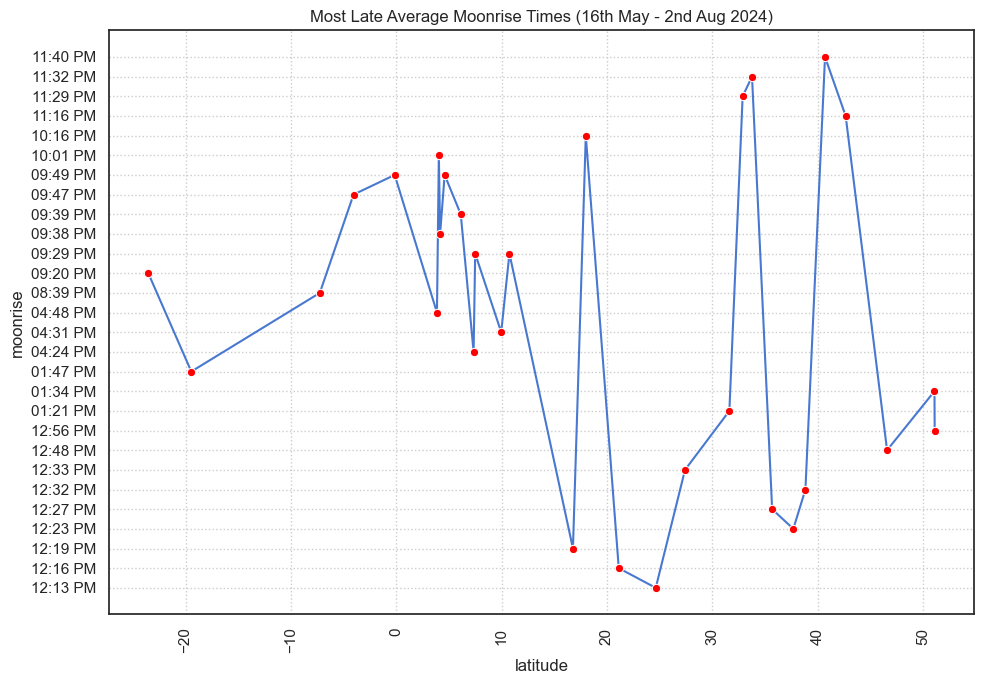

In [667]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_moonrise_high, 
             x=df_lat_mean_moonrise_high['latitude'], 
             y=df_lat_mean_moonrise_high['moonrise'], 
             marker='o',markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Most Late Average Moonrise Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Moonrise times are decreasing with increasing latitudes but with significant fluctuations.
# Average Moonrise time in southern hemisphere is as late as 1.47 PM at latitude between -25 and -20 degrees.

In [246]:
df_lat_mean_moonrise_low = df_new.groupby('latitude').agg({'moonrise': 'mean'}).reset_index(drop=False).sort_values(by='moonrise',ascending=True).head(30)
df_lat_mean_moonrise_low

,latitude,moonrise
160,39.53,0.000000
70,7.36,29436.000000
55,5.47,30746.666667
5,-21.55,31047.272727
203,51.25,34990.169492
206,52.37,36600.000000
194,48.87,36663.116883
195,49.61,37201.600000
209,53.90,37379.151671
198,50.83,37770.000000


In [247]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_moonrise_low['moonrise'] = df_lat_mean_moonrise_low['moonrise'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

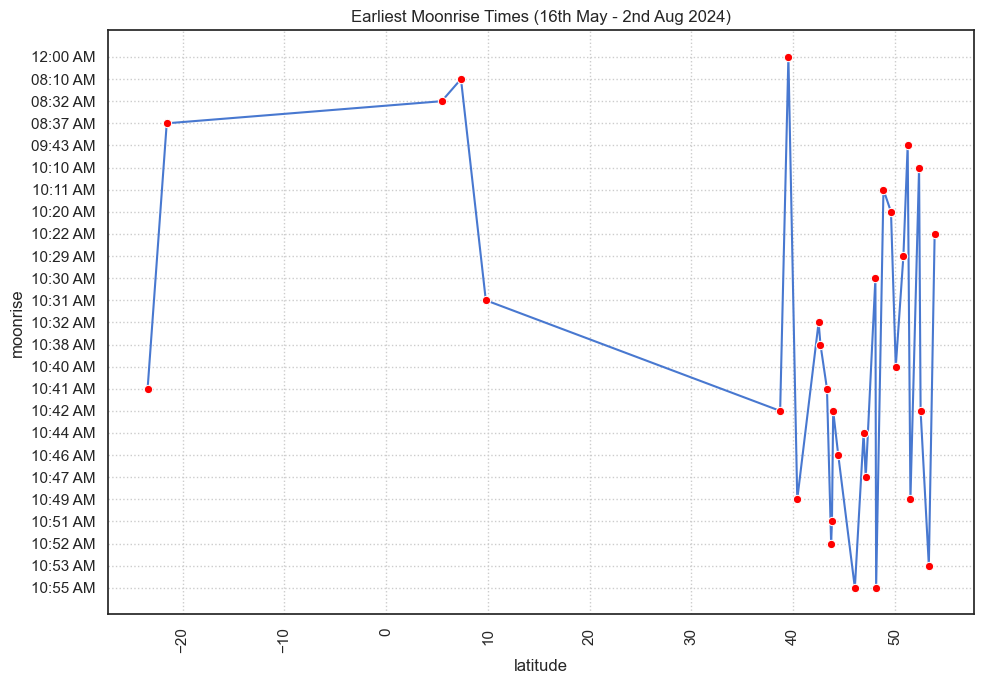

In [666]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_moonrise_low, 
             x=df_lat_mean_moonrise_low['latitude'], 
             y=df_lat_mean_moonrise_low['moonrise'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Earliest Moonrise Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# The earliest average moonrise times are observed between 45 and 50 degrees North latitude which is as early as 10.55 AM.
# There shall be other factors which might impact moonrise times than just the latitudes.

In [ ]:
# Analysing latitude Vs Moonset times

In [266]:
df_lat_mean_moonset_high = df_new.groupby('latitude').agg({'moonset': 'mean'}).reset_index(drop=False).sort_values(by='moonset',ascending=False).head(30)
df_lat_mean_moonset_high

,latitude,moonset
158,38.85,86340.000000
153,37.70,86100.000000
201,51.12,85860.000000
53,4.63,85380.000000
60,6.43,84600.000000
5,-21.55,49898.181818
70,7.36,47955.000000
55,5.47,46190.000000
110,17.93,43864.500000
77,9.80,43464.406780


In [267]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_moonset_high['moonset'] = df_lat_mean_moonset_high['moonset'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

In [269]:
df_lat_mean_moonset_high

,latitude,moonset
158,38.85,11:59 PM
153,37.70,11:55 PM
201,51.12,11:51 PM
53,4.63,11:43 PM
60,6.43,11:30 PM
5,-21.55,01:51 PM
70,7.36,01:19 PM
55,5.47,12:49 PM
110,17.93,12:11 PM
77,9.80,12:04 PM


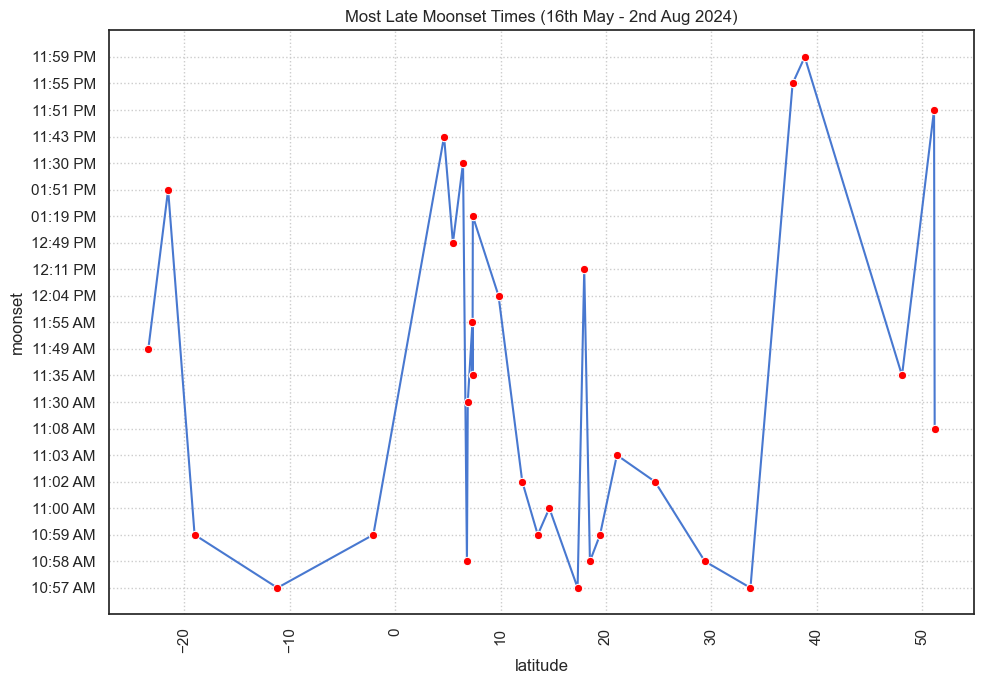

In [1237]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_moonset_high, 
             x=df_lat_mean_moonset_high['latitude'], 
             y=df_lat_mean_moonset_high['moonset'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Most Late Moonset Times (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average Moonset time in southern hemisphere is as late as 1.47 PM at latitude between -25 and -20 degrees.
# There shall be other factors which might impact sunrise times than just the latitudes.

In [258]:
df_lat_mean_moonset_low = df_new.groupby('latitude').agg({'moonset': 'mean'}).reset_index(drop=False).sort_values(by='moonset',ascending=True).head(30)
df_lat_mean_moonset_low

,latitude,moonset
17,-12.35,0.000000
128,27.42,0.000000
200,51.10,1440.000000
134,31.63,1680.000000
69,7.35,19046.250000
78,9.97,19050.000000
48,3.87,20906.250000
186,46.60,21382.500000
199,50.88,22668.750000
178,43.81,28811.666667


In [259]:
# Converting the mean time in seconds back to HH:MM format using strftime method.

df_lat_mean_moonset_low['moonset'] = df_lat_mean_moonset_low['moonset'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p'))

In [260]:
df_lat_mean_moonset_low

,latitude,moonset
17,-12.35,12:00 AM
128,27.42,12:00 AM
200,51.10,12:24 AM
134,31.63,12:28 AM
69,7.35,05:17 AM
78,9.97,05:17 AM
48,3.87,05:48 AM
186,46.60,05:56 AM
199,50.88,06:17 AM
178,43.81,08:00 AM


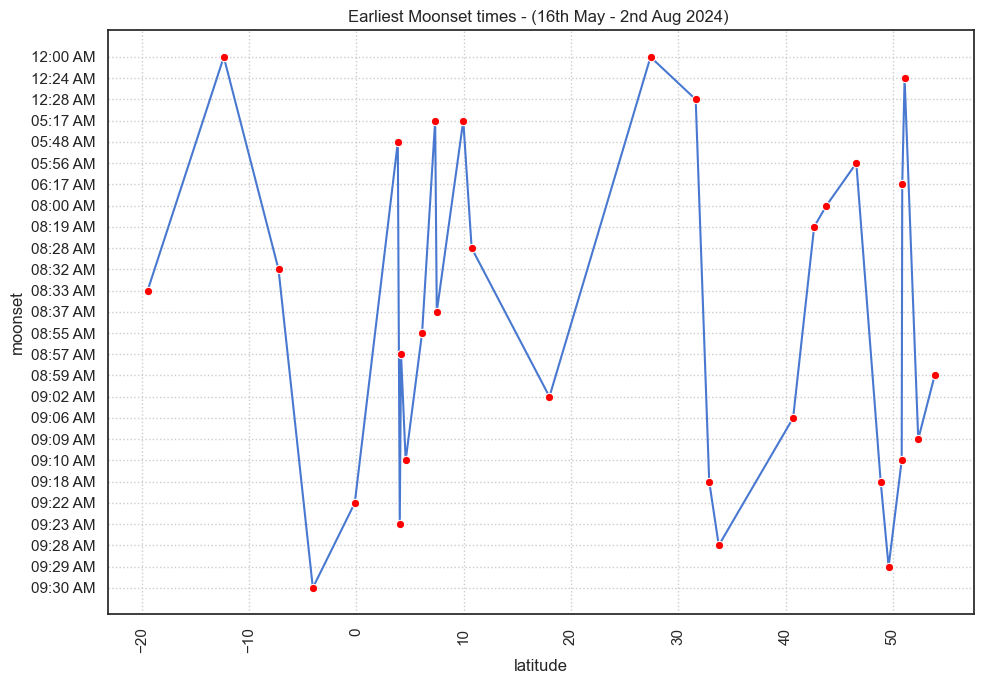

In [1238]:
fig, my_ax = plt.subplots(figsize=(10,7))

sns.lineplot(data = df_lat_mean_moonset_low, x=df_lat_mean_moonset_low['latitude'], 
             y=df_lat_mean_moonset_low['moonset'], 
             marker='o', markerfacecolor='red',
             ax=my_ax)
plt.xticks(rotation=90)

plt.grid(linestyle=':')
plt.title('Earliest Moonset times - (16th May - 2nd Aug 2024) ')
plt.tight_layout()
plt.show()

# Inference:

# The earliest average moonset times are observed between 45 and 50 degrees North latitude which is as early as 10.55 AM.

In [ ]:
# Analysing Moon illumination and Moon phases

In [217]:
df_moonphase_mean_illumination = df_new.groupby('moon_phase').agg({'moon_illumination': 'mean'}).reset_index(drop=False).sort_values(by='moon_illumination',ascending=True)

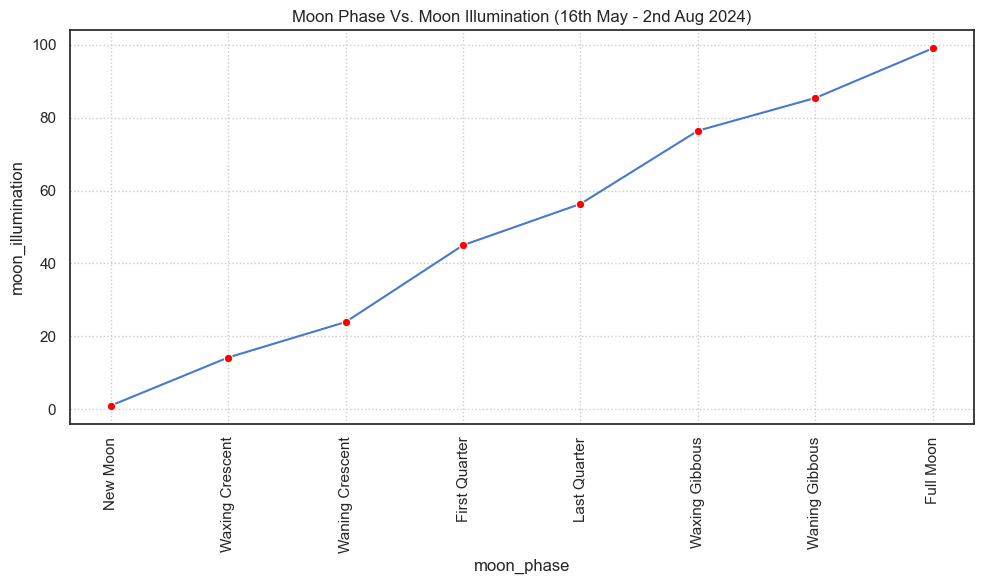

In [218]:
fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_moonphase_mean_illumination, 
            y=df_moonphase_mean_illumination['moon_illumination'], 
            x=df_moonphase_mean_illumination['moon_phase'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Moon Phase Vs. Moon Illumination (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Moon illumination shares almost positive linear relationship with moon phase.
## As the moon phase shifts from new moon to First Qtr. and to full moon, 
## the moon illumination percentage increases linearly.
## which implies that in full moon phase, moon is illuminated almost 100 percent
## while in new moon phase, moon is illuminated as negligible as one percent.

In [ ]:
##------END OF SUB-SECTION - Bivariate Analysis between Metrics and Dimensions------------##

<a id = Section6.5></a>

### **6.5. TIME TREND ANALYSIS**

In [ ]:
# Monthly Comparison of weather features - from 16th May to 2nd Aug 2024.

In [407]:
df_new['Date'] = df_new['last_updated'].dt.date

In [410]:
df_new['Date'] = pd.to_datetime(df_new['Date'])

In [412]:
# Creating a new attribute - Update month whihch denotes the month of the date.. 
# the weather was last recorded.

df_new['Update Month'] = df_new['Date'].dt.month

In [418]:
df_new['Update Month'].replace([5,6,7,8],['May','June','July','Aug'],inplace=True)

In [421]:
df_monthwise = df_new.groupby('Update Month').agg({'temperature_celsius': 'mean', 'wind_mph': 'mean', 
                                    'pressure_mb': 'mean', 'humidity': 'mean',
                                    'visibility_km': 'mean', 'uv_index': 'mean', 
                                    'air_quality_PM10': 'mean', 'moon_illumination': 'mean'}).reset_index(drop=False)

In [422]:
df_monthwise = df_monthwise.sort_values(by='Update Month', ascending=False)
df_monthwise

,Update Month,temperature_celsius,wind_mph,pressure_mb,humidity,visibility_km,uv_index,air_quality_PM10,moon_illumination
3,May,25.218147,8.640813,1012.891753,59.834445,9.627502,5.053669,25.513129,78.662523
2,June,26.446641,8.605442,1011.929912,58.830377,9.669830,5.459273,23.228690,49.569657
1,July,26.873571,8.529242,1011.664039,59.460849,9.648128,5.710984,20.820570,43.605626
0,Aug,26.927129,8.841584,1011.217822,57.811881,9.688119,5.722772,18.170297,12.277228


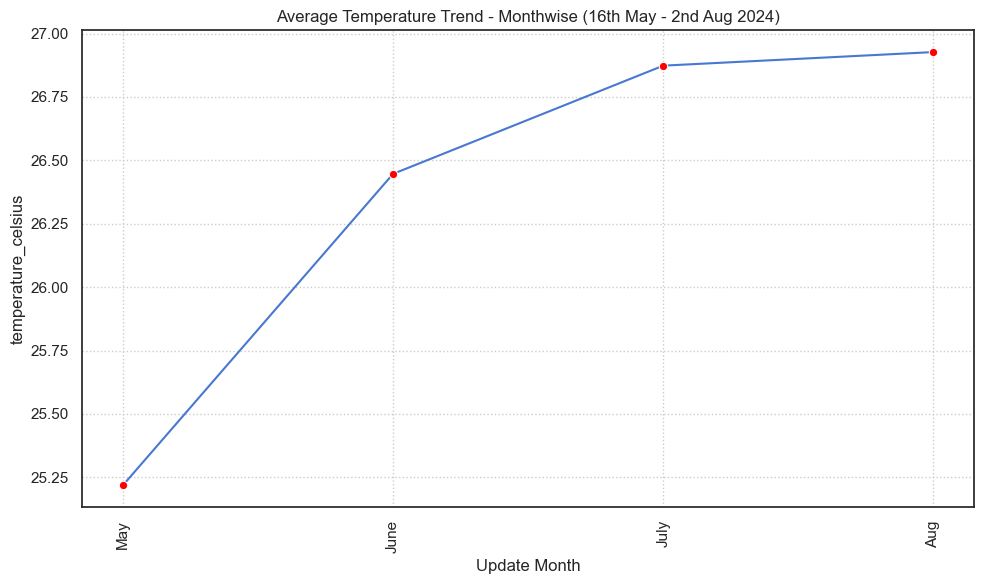

In [621]:
# Analysing temperature across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['temperature_celsius'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Temperature Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average temperature has increased from May to August 2024.

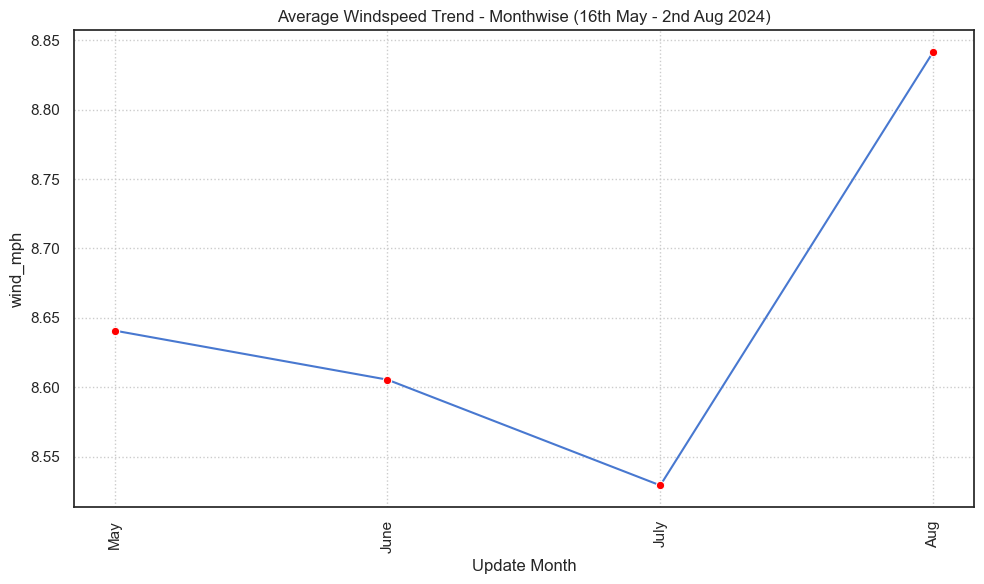

In [622]:
# Analysing wind speed across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['wind_mph'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Windspeed Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average windspeed has declined from May to July and then increased in Aug 2024.

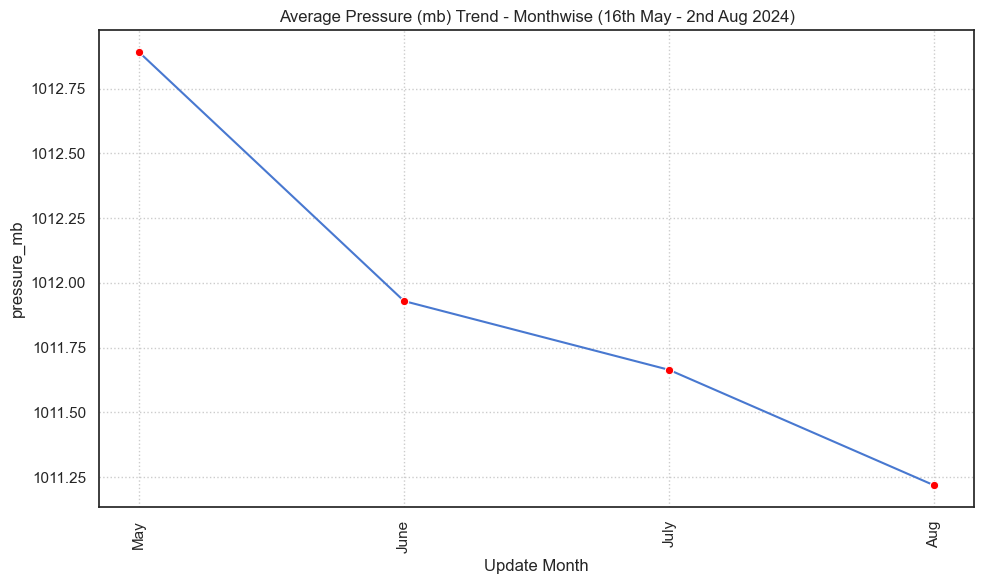

In [623]:
# Analysing Pressure across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['pressure_mb'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Pressure (mb) Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average pressure has decreased from May to August 2024.

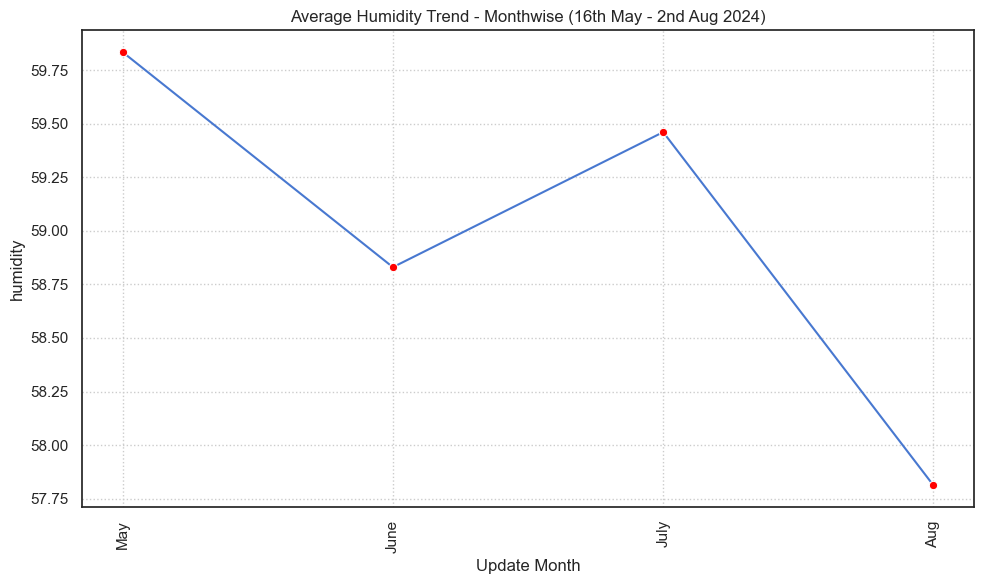

In [624]:
# Analysing Humidity across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['humidity'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Humidity Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Avg. humidity has decreased from May to June, then sudden tip in July and then declined in Aug 2024.

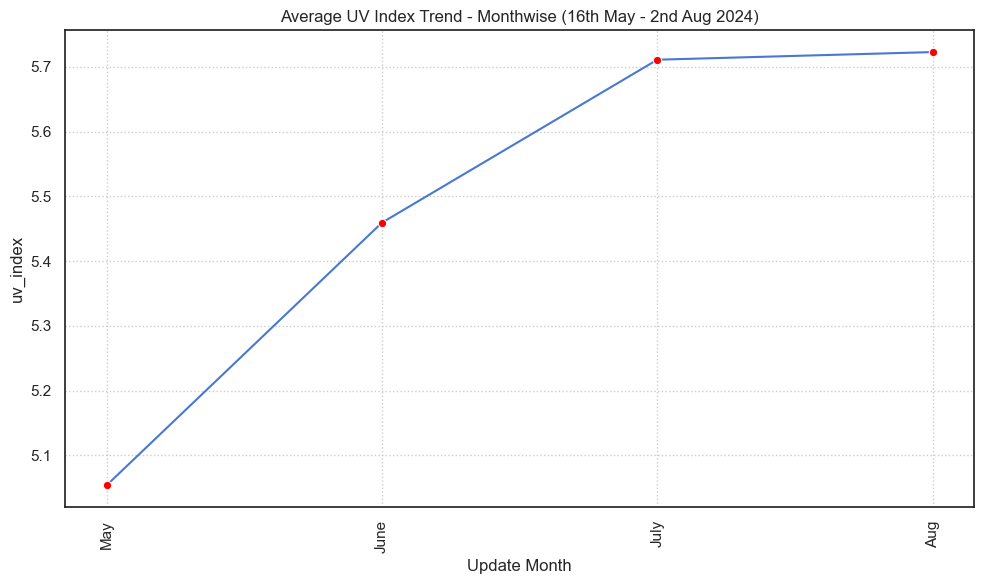

In [625]:
# Analysing UV index across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['uv_index'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average UV Index Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Avg UV has increased gradually from May to July and then slight increase in Aug 2024.

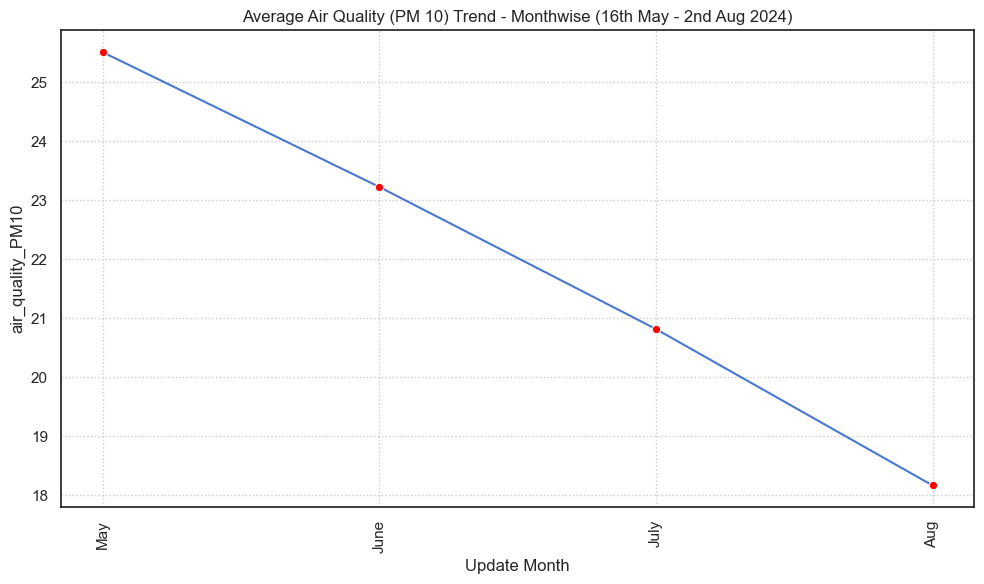

In [626]:
# Analysing Air Quality across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['air_quality_PM10'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Air Quality (PM 10) Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Avg. air quality has drasticaly declined from may to August 2024.

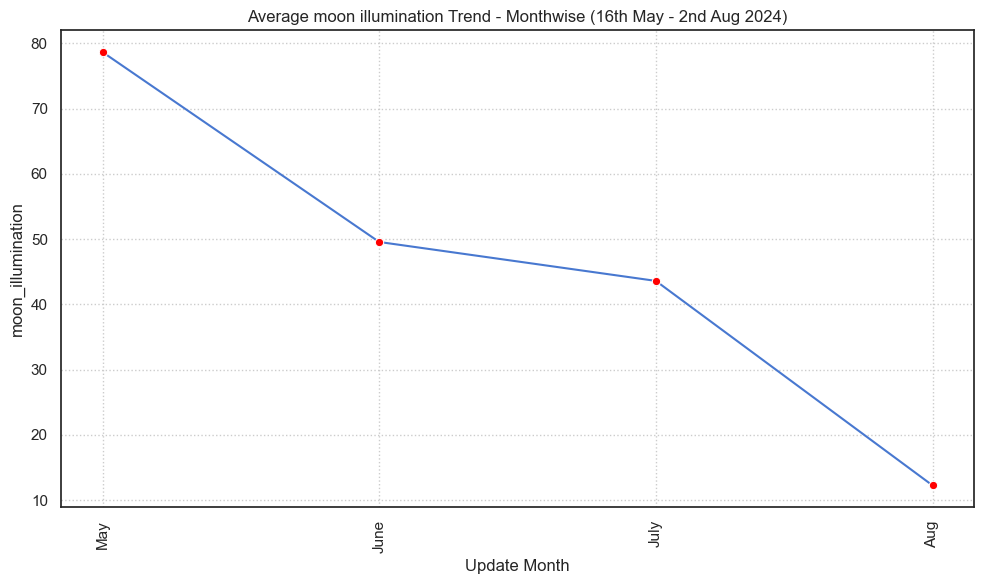

In [628]:
# Analysing moon illumination across months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_monthwise, 
            y=df_monthwise['moon_illumination'], 
            x=df_monthwise['Update Month'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average moon illumination Trend - Monthwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Avg. moon illumination has declined from may to August 2024.

In [ ]:
# Weekly Comparison of weather features - from 16th May to 2nd Aug 2024.

In [466]:
Week1 = pd.date_range(start ='2024-05-16', end = '2024-05-19') ## Week1 - 16th May - 19th May 2024
Week2 = pd.date_range(start ='2024-05-20', end = '2024-05-26')
Week3 = pd.date_range(start ='2024-05-27', end = '2024-06-02')
Week4 = pd.date_range(start ='2024-06-03', end = '2024-06-09')
Week5 = pd.date_range(start ='2024-06-10', end = '2024-06-16')
Week6 = pd.date_range(start ='2024-06-17', end = '2024-06-23')
Week7 = pd.date_range(start ='2024-06-24', end = '2024-06-30')
Week8 = pd.date_range(start ='2024-07-01', end = '2024-07-07')
Week9 = pd.date_range(start ='2024-07-08', end = '2024-07-14')
Week10 = pd.date_range(start ='2024-07-15', end = '2024-07-21')
Week11 = pd.date_range(start ='2024-07-22', end = '2024-07-28')
Week12 = pd.date_range(start ='2024-07-29', end = '2024-07-31')
Week13 = pd.date_range(start ='2024-08-01', end = '2024-08-02') ## Week 13 - 1st Aug - 2nd Aug 2024

In [484]:
df_new['Week'] = df_new['Date']     # Creating a new attribute - 'week' and assigning 'Date' attribute values to it.

In [486]:
# Replacing assigned date values in week attribute with respective week numbers if the date value falls into the week range defined above.
## For eg:- '2024-05-16' will be replaced with 'Week 1 (16th - 19th May)'.

df_new['Week'] = df_new['Week'].apply(lambda x: 'Week 1 (16th - 19th May)' if x in Week1
                                      else 'Week 2 (20th - 26th May)' if x in Week2
                                      else 'Week 3 (27th May - 2nd June)' if x in Week3
                                      else 'Week 4 (3rd - 9th June)' if x in Week4
                                      else 'Week 5 (10th - 16th June)' if x in Week5
                                      else 'Week 6 (17th - 23rd June)' if x in Week6
                                      else 'Week 7 (24th - 30th June)' if x in Week7
                                      else 'Week 8 (1st - 7th July)' if x in Week8
                                      else 'Week 9 (8th - 14th July)' if x in Week9
                                      else 'Week 10 (15th - 21st July)' if x in Week10
                                      else 'Week 11 (22nd - 28th July)' if x in Week11
                                      else 'Week 12 (29th - 31st July)' if x in Week12
                                      else 'Week 13 (1st - 2nd Aug)' if x in Week13
                                      else x)

In [488]:
# Grouping by week attribute

df_weekwise = df_new.groupby('Week').agg({'temperature_celsius': 'mean', 'wind_mph': 'mean', 
                                    'pressure_mb': 'mean', 'humidity': 'mean',
                                    'cloud': 'mean',      
                                    'visibility_km': 'mean', 'uv_index': 'mean', 
                                    'air_quality_PM10': 'mean', 'moon_illumination': 'mean'}).reset_index(drop=False)

In [495]:
# Using pd.categorical to sort df_weekwise dataframe according to week attribute in ascending order of week number
# as 'week' attribute is categorical.

df_weekwise['Week'] = pd.Categorical(df_weekwise['Week'], ordered=True, 
                                     categories = ['Week 1 (16th - 19th May)', 
                                                   'Week 2 (20th - 26th May)',  
                                                   'Week 3 (27th May - 2nd June)', 
                                                   'Week 4 (3rd - 9th June)', 
                                                   'Week 5 (10th - 16th June)', 
                                                   'Week 6 (17th - 23rd June)', 
                                                   'Week 7 (24th - 30th June)', 
                                                   'Week 8 (1st - 7th July)', 
                                                   'Week 9 (8th - 14th July)', 
                                                   'Week 10 (15th - 21st July)', 
                                                   'Week 11 (22nd - 28th July)', 
                                                   'Week 12 (29th - 31st July)', 
                                                   'Week 13 (1st - 2nd Aug)'])

In [498]:
df_weekwise = df_weekwise.sort_values('Week',ascending=True)

In [1417]:
df_weekwise

,Week,temperature_celsius,wind_mph,pressure_mb,humidity,cloud,visibility_km,uv_index,air_quality_PM10,moon_illumination
0,Week 1 (16th - 19th May),24.648618,8.559437,1012.798749,60.434828,35.423670,9.633055,4.820647,25.290407,65.395203
5,Week 2 (20th - 26th May),25.304788,8.617949,1013.031502,60.161905,37.806703,9.624469,5.117216,26.320879,95.180220
6,Week 3 (27th May - 2nd June),25.749062,8.754692,1012.923754,58.822581,37.120345,9.626833,5.233871,23.949780,57.740469
7,Week 4 (3rd - 9th June),26.408081,8.526779,1012.280998,57.873808,35.391049,9.680924,5.387381,24.328100,5.736610
8,Week 5 (10th - 16th June),25.873350,8.481785,1011.632772,59.085589,38.584492,9.654060,5.291149,23.962838,38.514265
9,Week 6 (17th - 23rd June),26.800138,8.767412,1011.551081,58.821775,37.842095,9.660477,5.569724,22.856301,91.225205
10,Week 7 (24th - 30th June),26.851594,8.604829,1011.867013,59.523031,36.976040,9.695988,5.629272,22.002675,69.157504
11,Week 8 (1st - 7th July),26.344626,8.723004,1010.816117,60.722344,39.275714,9.617143,5.519414,21.837656,9.271062
12,Week 9 (8th - 14th July),27.227036,8.380441,1012.244292,59.774734,37.633828,9.613699,5.732877,22.310578,24.175038
1,Week 10 (15th - 21st July),27.272570,8.308906,1012.273961,60.293469,39.430492,9.630534,5.783715,20.112977,80.063613


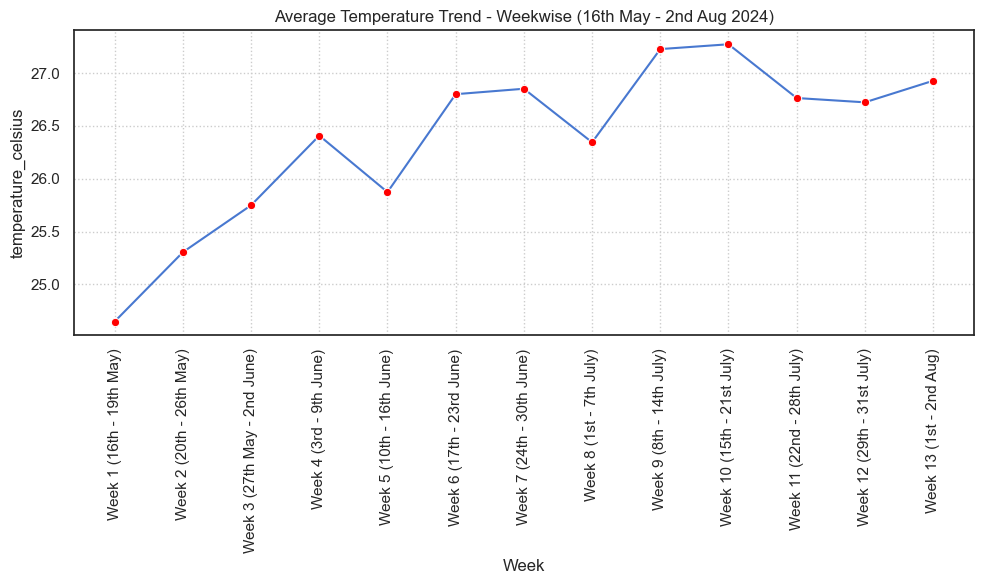

In [502]:
# Analysing temperature across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['temperature_celsius'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Temperature Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average temperature is on an upward trend from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with significant fluctuations weekwise.

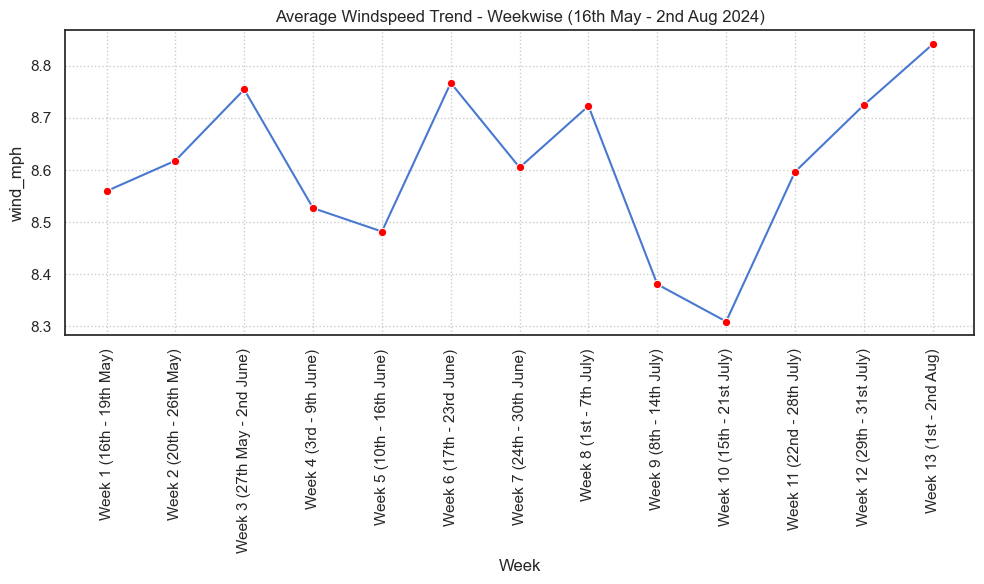

In [503]:
# Analysing windspeed across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['wind_mph'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Windspeed Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average wind speed has declined from week 1(16 - 19th May) to Week 10 (15 - 21 July 2024) with significant fluctuations week wise and then on an upward trend from Week 10 (15 - 21 July 2024) to Week 13 (1 - 2 August 2024).

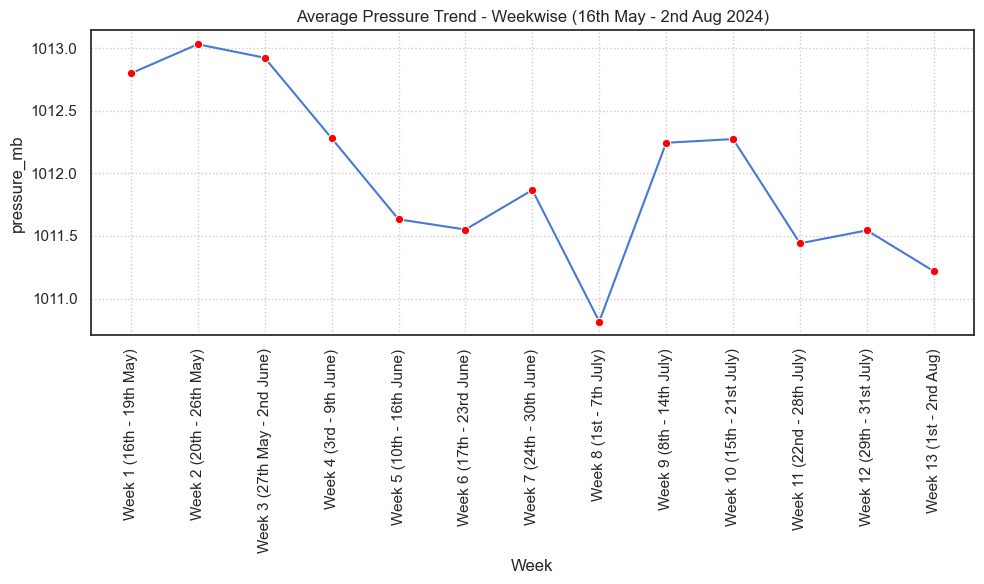

In [504]:
# Analysing pressure across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['pressure_mb'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Pressure Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average pressure is on a downward trend from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with significant fluctuations weekwise.

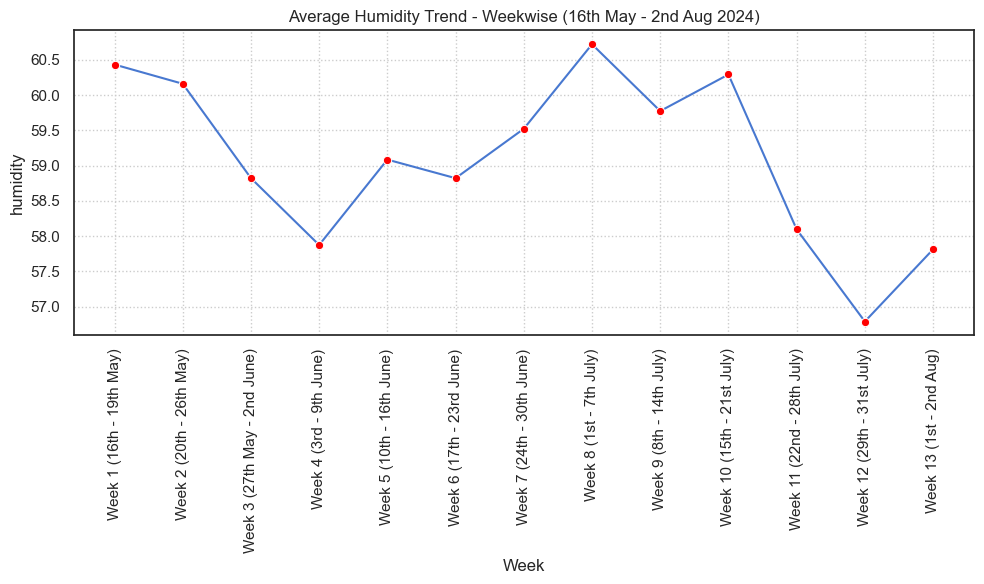

In [507]:
# Analysing humidity across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['humidity'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Humidity Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average humidity has declined from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with significant fluctuations weekwise.

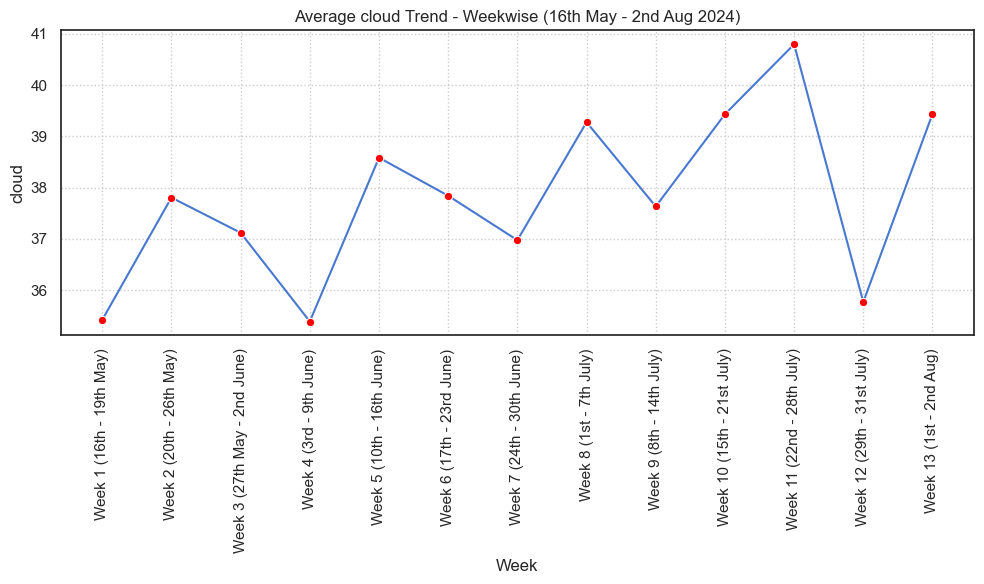

In [508]:
# Analysing cloud across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['cloud'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average cloud Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average cloud cover percentage is on a upward trend from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with very high fluctuations and dips and highs, week wise.

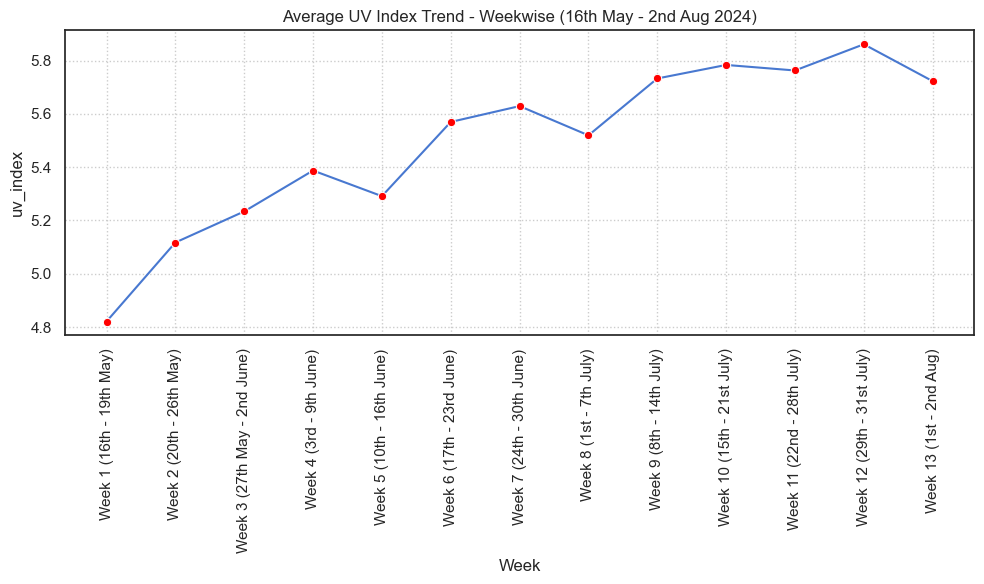

In [510]:
# Analysing uv index across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['uv_index'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average UV Index Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average uv index is on a upward trend from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with significant fluctuations weekwise.

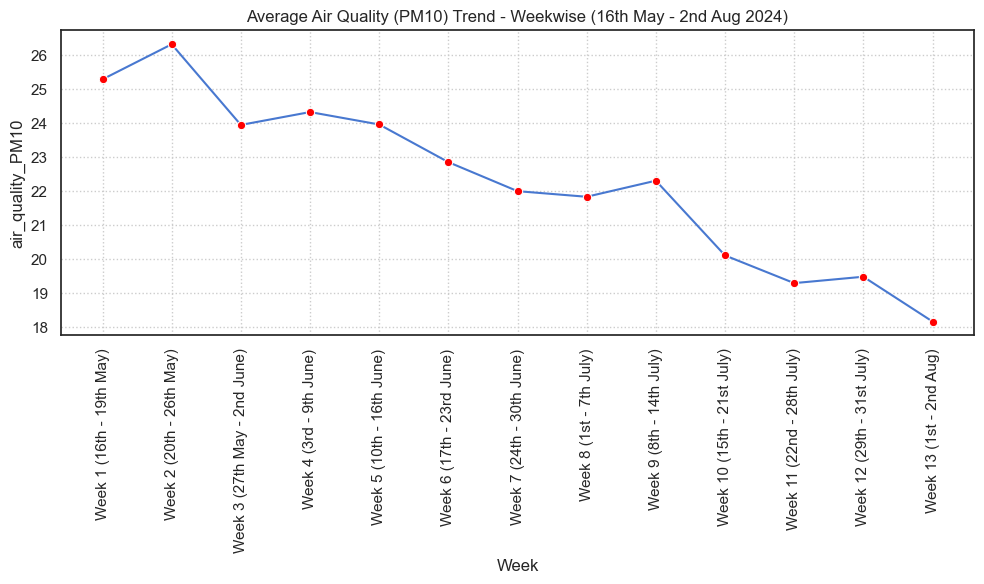

In [511]:
# Analysing air_quality_PM10 across weeks

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_weekwise, 
            y=df_weekwise['air_quality_PM10'], 
            x=df_weekwise['Week'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Air Quality (PM10) Trend - Weekwise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average air quality: PM 10 has declined from week 1(16 - 19th May) to Week 13 (1 - 2 August 2024) with significant fluctuations weekwise.

In [ ]:
# Mid month comparison of weather features (16th May Vs. 16th June Vs. 16th July)

In [517]:
df_16th_May = df_new[df_new['Date'] == '2024-05-16']
df_16th_June = df_new[df_new['Date'] == '2024-06-16']
df_16th_July = df_new[df_new['Date'] == '2024-07-16']

In [520]:
df_mid_month = pd.concat([df_16th_May, df_16th_June, df_16th_July], axis=0)

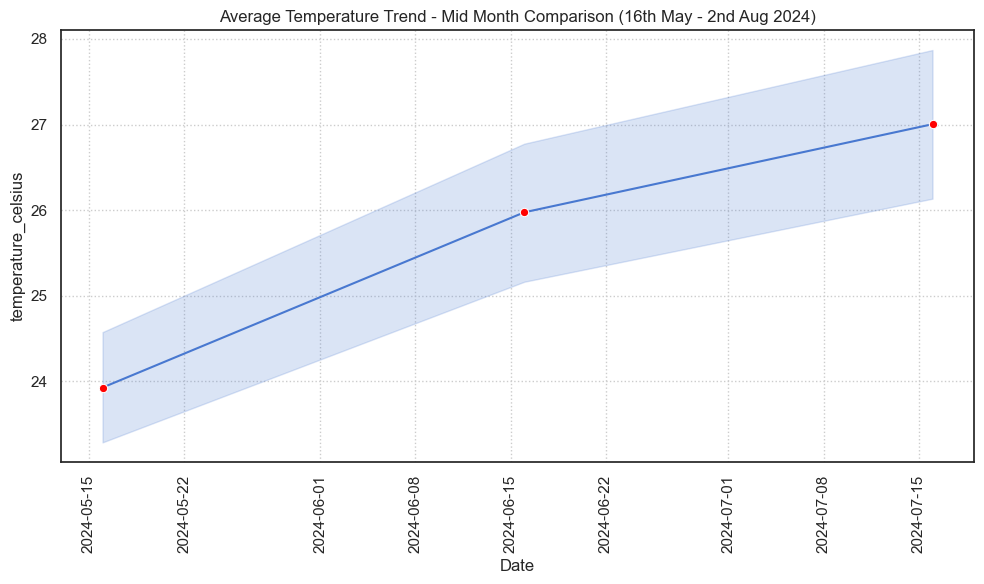

In [526]:
# Analysing temperature across mid months

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data = df_mid_month, 
            y=df_mid_month['temperature_celsius'], 
            x=df_mid_month['Date'],
            marker='o',
            markerfacecolor='red',ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Temperature Trend - Mid Month Comparison (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Temperature has considerably increased from mid May to mid June further to mid July.

In [ ]:
# Daily trend Analysis of weather features and trends

In [635]:
df_daily_temp = df_new.groupby('Date').agg({'temperature_celsius': 'mean'}) # grouping by date

In [636]:
df_daily_wind = df_new.groupby('Date').agg({'wind_mph': 'mean'}) # grouping by date

In [639]:
df_daily_humidity = df_new.groupby('Date').agg({'humidity': 'mean'}) # grouping by date

In [657]:
df_daily_sunrise = df_new.groupby('Date').agg({'sunrise': 'mean'})
df_daily_sunrise['sunrise'] = df_daily_sunrise['sunrise'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p')) # Converting the mean sunrise time in seconds back to HH:MM format using strftime method.
df_daily_sunrise = df_daily_sunrise.reset_index(drop=False).sort_values('sunrise', ascending=False)

In [660]:
df_daily_sunset = df_new.groupby('Date').agg({'sunset': 'mean'})
df_daily_sunset['sunset'] = df_daily_sunset['sunset'].apply(lambda x: pd.to_datetime(x, unit='s').strftime('%I:%M %p')) # Converting the mean time in seconds back to HH:MM format using strftime method.
df_daily_sunset = df_daily_sunset.reset_index(drop=False).sort_values('sunset', ascending=False)

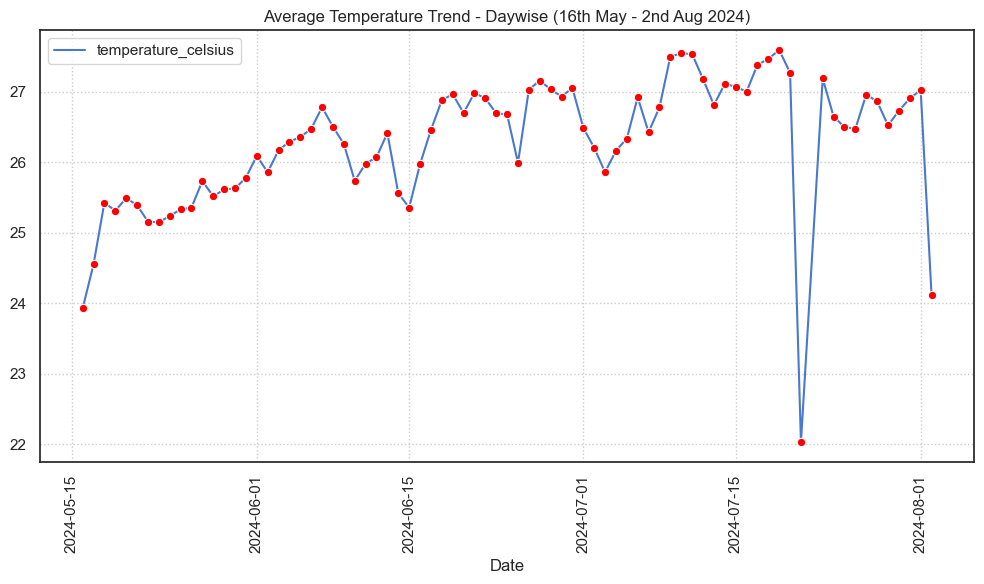

In [637]:
# Analysing temperature trend daywise

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=df_daily_temp,
             marker='o',markerfacecolor='red',
             ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Temperature Trend - Daywise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average temperature is on an upward trend from 15th May to 2nd Aug 2024 but with significant fluctuations on a daily basis.

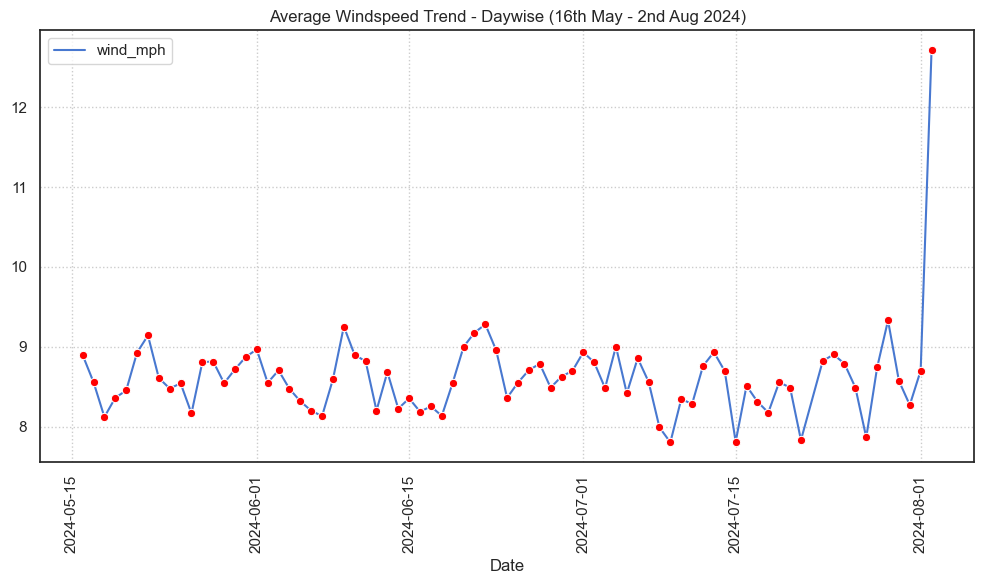

In [640]:
# Analysing wind speed trend daywise

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=df_daily_wind,
             marker='o',markerfacecolor='red',
             ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Windspeed Trend - Daywise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average wind speed is constantly fluctuating between 8 to 9 mph from day to day basis from 15th May to 2nd Aug 2024 
## however, average wind speed has drastically increased to above 12 mph in 2nd August 2024.

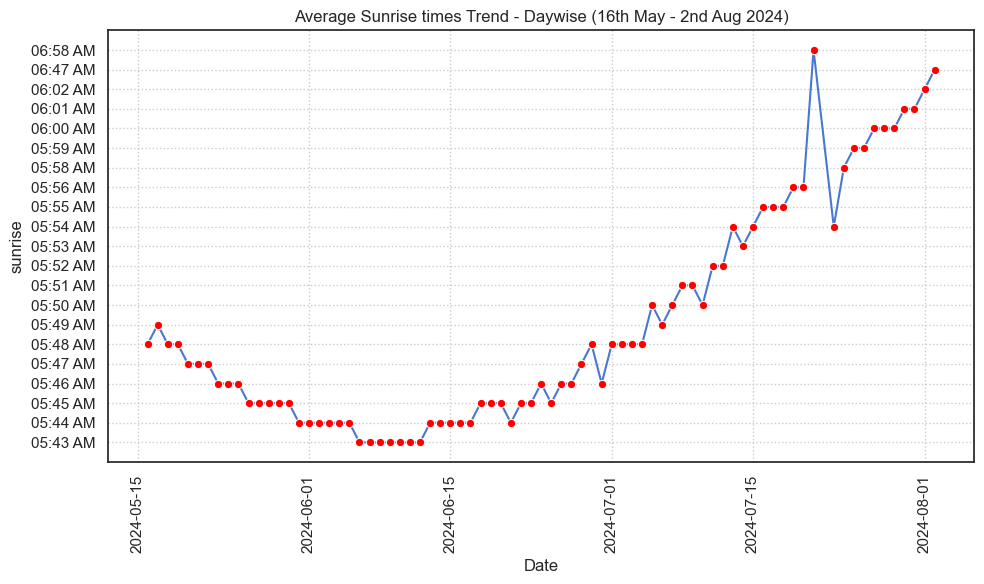

In [659]:
# Analysing sunrise time trend daywise

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=df_daily_sunrise,
             x='Date',
             y='sunrise',
             marker='o',markerfacecolor='red',
             ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Sunrise times Trend - Daywise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average sunrise times has decreased from 16th May to 6th - 10th June  2024.
## And then on an upward trend from 10th June to 2nd August 2024.

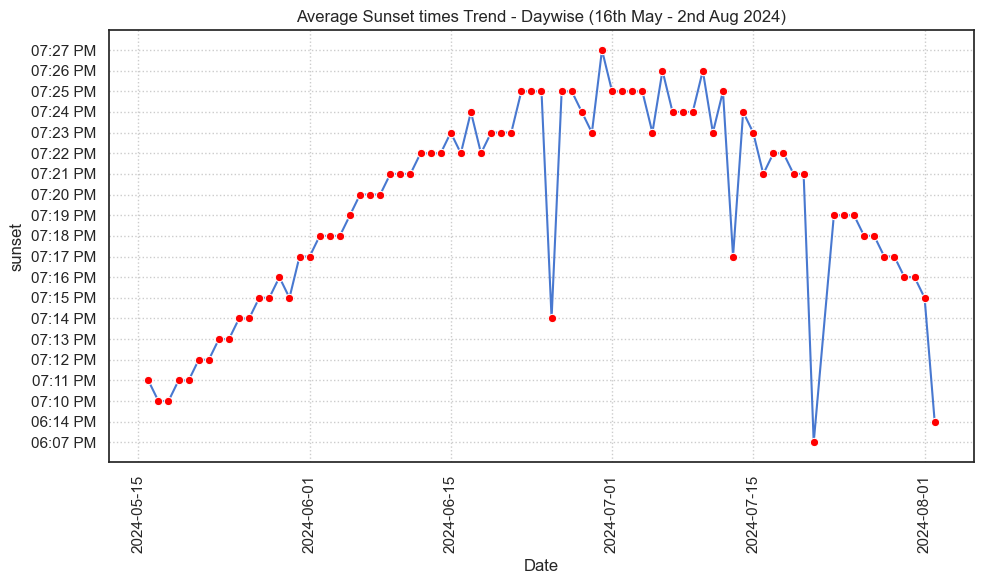

In [663]:
# Analysing sunset time trend daywise

fig, my_ax = plt.subplots(figsize=(10,6))

sns.lineplot(data=df_daily_sunset,
             x='Date',
             y='sunset',
             marker='o',markerfacecolor='red',
             ax=my_ax)

plt.xticks(rotation=90)
plt.grid(linestyle=':')
plt.title('Average Sunset times Trend - Daywise (16th May - 2nd Aug 2024)')
plt.tight_layout()
plt.show()

# Inference:

# Average sunset times is on an upward trend from 16th May to 22 - 23rd June  2024.
# And then on a downward trend from 23rd June to 2nd August 2024.

In [949]:
##---------------------------End of Sub Section - Time Trend Analysis-------------------------##

In [ ]:
##---------------------------End of Section - EDA-----------------------------------------##